# 2 : show glacier evolution dependent on the applied climate change (to update from Feb2024 update)

**needs lowess fit**

- things to consider for the "highlighted" experiments in (**Fig. 2: a, c,d, and in the other Fig 1. a**):
    - at the moment, we just use the one experiment that is nearest to that temperature theshold, maybe it would be better to use the 3 experiments nearest to that temperature threshold (or all experiments with +/-0.2 °C) and then show the median of that as highlighted dot (line in the other Fig.)?  
    - or we do a logarithmic fit (deltaV_rel  vs deltaT) and then just use the fitted values for the "threshold" temperatures!  
    - not sure if glacier model uncertainties fit here inside 
- **b**: glacier volume lost per °C global warming
    - at the moment computed by linear fit of all experiments with GMT change between 1 and 4 °C, however, some RGI regions loose their total glacier volume already with 3°C. Maybe change that only those experiments where the regional glacier volume is >=1% are chosen for the fit. Or is it ok like that. Could also think about two "slopes, one from 1-2, and one from 3.5-4.5 
    - can add uncertainties (std. err or sth. else ) 
- todo: sort the RGI regions after size or sth. else or merge several ones together ? 

- use maybe lines instead of 80 small dots? (for a,c,d), if we use a logarithmic fit of deltaV_rel  vs deltaT, that might also help to produce the line
    - sns.stripplot would also be an alternative, but not sure if it is better, and the data would neet to be in another format, 
   
    
- another plot idea: look at volume difference between 0°C scenario and the other scenarios
    - basically to analyse what would have changed even without anthropogenic warming  -> does this makes sense
    - same could be done for the 1.5°C scenario -> to tell what can be saved by keeping global temperatures at 1.5°C compared to higher temperatures ... 
- another plot idea: more going into response time:
    - year where 50%/90% of glacier volume change response occcurred

--- 

In [1]:
# download it here https://cluster.klima.uni-bremen.de/~lschuster/glacierMIP3_analysis/glacierMIP3_{DATE}_models_all_rgi_regions_sum_scaled.nc
# and change the path to your local path
DATE = 'Feb12_2024' 
fill_option = 'repeat_last_101yrs' 
fit_to_median = False

import xarray as xr
import numpy as np
import pandas as pd
import scipy
import os
import glob
import matplotlib.pyplot as plt
from datetime import date
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns

from matplotlib.lines import Line2D
import matplotlib.patches as mpatches
# for plots withinplots 
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

try:
    path_merged_runs_scaled_extend = f'/home/www/lschuster/glacierMIP3_analysis/glacierMIP3_{DATE}_models_all_rgi_regions_sum_scaled_extended_{fill_option}.nc'
    ds_reg_models = xr.open_dataset(path_merged_runs_scaled_extend)

except:
    path_merged_runs_scaled_extend = f'/home/lilianschuster/Downloads/glacierMIP3_{DATE}_models_all_rgi_regions_sum_scaled_extended_{fill_option}.nc'
    ds_reg_models = xr.open_dataset(path_merged_runs_scaled_extend)
# --> comes from isimip3b_postprocessing_analysis/isimip3b_postprocess_to_monthly.ipynb
pd_global_temp_exp = pd.read_csv('../data/temp_ch_ipcc_isimip3b.csv', index_col = 0)
pd_rgi_stats_w_hugonnet = pd.read_csv(f'rgi_vs_2020_volume_hugonnet_estimates{DATE}.csv', index_col = [0])


approach = '_via_5yravg'
ds_reg_yr_shift= xr.open_dataset(f'/home/www/lschuster/glacierMIP3_analysis/all_shifted_glacierMIP3_{DATE}_models_all_rgi_regions_sum_scaled_extended_{fill_option}{approach}.nc')

In [2]:
pd_rgi_stats_w_hugonnet['regional_volume_m3_2020_via_5yravg'] / pd_rgi_stats_w_hugonnet['regional_volume_m3_2000_via_5yravg']

01          0.920063
02          0.832398
03          0.974619
04          0.927804
05          0.946893
06          0.941570
07          0.967125
08          0.870514
09          0.983281
10          0.803947
11          0.703293
12          0.750490
13          0.931610
14          0.962628
15          0.818440
16          0.776888
17          0.908834
18          0.792311
19          0.989423
Globally    0.960560
dtype: float64

In [3]:
DATE

'Feb12_2024'

In [4]:
if fit_to_median: 
    pd_lowess_fit = pd.read_csv('lowess_fits/fitted_lowess_best_frac_shift_years_rel_2020_101yr_avg_period_fit_to_median_lowess_added_current12deg.csv', index_col=[0])
    #pd_lowess_fit_above_0_8 = pd.read_csv('fitted_lowess_best_frac_shift_years_rel_2020_101yr_avg_period_temp_above_0_8_fit_to_median_lowess_added_current12deg.csv', index_col=[0])
    #pd_lowess_fit_above_0_8.index = pd_lowess_fit_above_0_8.index.values.round(3)

else:
    pd_lowess_fit = pd.read_csv(f'lowess_fits/fitted_lowess_best_frac_shift_years_rel_2020_101yr_avg_period_lowess_added_quantiles_added_current12deg_5000_{DATE}.csv', index_col=[0])
    # we have not computed that because we decided to usee all values now anyways ... 
    #pd_lowess_fit_above_0_8 = pd.read_csv('fitted_lowess_best_frac_shift_years_rel_2020_100yr_avg_period_temp_above_0_8_lowess_added_current12deg.csv', index_col=[0])


In [5]:
# values not shown in the text 
temp = 1.2
pd_lowess_fit.loc[pd_lowess_fit.index.values.round(2) ==temp].sort_values(by='0.5')#['0.5']

,0.05,0.25,0.5,0.75,0.95,frac,region,year,fit_to_median,temp_ch,...,fit_opt,shift_years_2020,y,add,min_0.5_diff,min_0.5,min_0.5_diff_above_zero,median_absolute_deviation,rmse,algorithm_sel
x,,,,,,,,,,,,,,,,,,,,,
1.2,4.200664,6.166181,14.168010,16.586309,23.633649,0.30,04,5000,False,NaN,...,lowess_fit,True,NaN,NaN,0.000771,-0.004143,0.000000,2.446252,10.598986,only_decreasing
1.2,4.173455,7.386498,24.342896,47.004405,69.633202,0.30,02,5000,False,NaN,...,lowess_fit,True,NaN,NaN,0.003899,-0.015106,0.000000,4.724376,30.932857,only_decreasing
1.2,6.907636,16.236178,29.894975,52.363672,111.546957,0.76,08,5000,False,NaN,...,lowess_fit,True,NaN,NaN,-0.633616,-7.951112,0.000000,6.441324,45.293002,only_decreasing
1.2,11.514022,21.089679,33.062133,46.872194,67.806775,0.87,09,5000,False,NaN,...,lowess_fit,True,NaN,NaN,-0.312946,-4.381023,0.000000,7.468229,15.327665,only_decreasing
1.2,18.679098,26.863216,37.433788,54.186396,79.452107,0.30,06,5000,False,NaN,...,lowess_fit,True,NaN,NaN,0.006364,-0.044864,0.000000,8.586156,21.754856,only_decreasing
1.2,21.134060,27.473536,38.712255,43.649061,50.403972,0.30,10,5000,False,NaN,...,lowess_fit,True,NaN,NaN,0.039585,-0.580708,0.000000,3.582551,30.038075,only_decreasing
1.2,24.527334,29.192799,39.043649,47.483485,69.095250,0.32,05,5000,False,NaN,...,lowess_fit,True,NaN,NaN,0.049373,0.134303,0.049373,8.332099,15.811566,non_negative_and_decreasing
1.2,34.865220,41.794832,45.601673,48.217287,52.810616,0.30,11,5000,False,NaN,...,lowess_fit,True,NaN,NaN,0.013314,-0.138614,0.000000,3.226763,27.917910,only_decreasing
1.2,31.756906,42.483472,51.086743,67.777868,80.727626,0.40,07,5000,False,NaN,...,lowess_fit,True,NaN,NaN,0.032647,0.000013,0.032647,7.321637,17.963226,non_negative_and_decreasing


In [6]:
# values not shown in the text 
temp = 3
pd_lowess_fit.loc[pd_lowess_fit.index.values.round(2) ==temp]#['0.5']

,0.05,0.25,0.5,0.75,0.95,frac,region,year,fit_to_median,temp_ch,...,fit_opt,shift_years_2020,y,add,min_0.5_diff,min_0.5,min_0.5_diff_above_zero,median_absolute_deviation,rmse,algorithm_sel
x,,,,,,,,,,,,,,,,,,,,,
3.0,16.310217,18.870286,21.038442,27.669713,32.337203,0.38,All,5000,False,NaN,...,lowess_fit,True,NaN,NaN,0.133608,2.984842,0.133608,3.089273,4.277722,non_negative_and_decreasing
3.0,11.480030,20.188860,28.687600,47.308109,59.632556,0.31,01,5000,False,NaN,...,lowess_fit,True,NaN,NaN,0.154885,1.652147,0.154885,9.775249,14.848600,non_negative_and_decreasing
3.0,0.218793,0.447297,1.077010,3.058121,10.445536,0.30,02,5000,False,NaN,...,lowess_fit,True,NaN,NaN,0.003899,-0.015106,0.000000,4.724376,30.932857,only_decreasing
3.0,7.802136,19.793044,28.787117,50.773064,79.849811,0.30,03,5000,False,NaN,...,lowess_fit,True,NaN,NaN,0.148300,-0.680676,0.000000,14.610874,25.095710,only_decreasing
3.0,0.036555,0.163892,0.518731,2.630357,11.142477,0.30,04,5000,False,NaN,...,lowess_fit,True,NaN,NaN,0.000771,-0.004143,0.000000,2.446252,10.598986,only_decreasing
3.0,0.771342,5.068619,11.059563,17.819540,33.565077,0.32,05,5000,False,NaN,...,lowess_fit,True,NaN,NaN,0.049373,0.134303,0.049373,8.332099,15.811566,non_negative_and_decreasing
3.0,0.227936,0.714034,2.518395,11.621996,30.485112,0.30,06,5000,False,NaN,...,lowess_fit,True,NaN,NaN,0.006364,-0.044864,0.000000,8.586156,21.754856,only_decreasing
3.0,0.002398,0.181534,4.523460,19.778078,41.365863,0.40,07,5000,False,NaN,...,lowess_fit,True,NaN,NaN,0.032647,0.000013,0.032647,7.321637,17.963226,non_negative_and_decreasing
3.0,0.000000,0.000000,0.000000,0.000000,4.716843,0.76,08,5000,False,NaN,...,lowess_fit,True,NaN,NaN,-0.633616,-7.951112,0.000000,6.441324,45.293002,only_decreasing


In [7]:
# values not shown in the text 
temp = 5
pd_lowess_fit.loc[pd_lowess_fit.index.values.round(2) ==temp]#['0.5']

,0.05,0.25,0.5,0.75,0.95,frac,region,year,fit_to_median,temp_ch,...,fit_opt,shift_years_2020,y,add,min_0.5_diff,min_0.5,min_0.5_diff_above_zero,median_absolute_deviation,rmse,algorithm_sel
x,,,,,,,,,,,,,,,,,,,,,
5.0,5.221364,7.621148,9.014177,13.135309,18.044238,0.38,All,5000,False,NaN,...,lowess_fit,True,NaN,NaN,0.133608,2.984842,0.133608,3.089273,4.277722,non_negative_and_decreasing
5.0,2.627077,5.915091,12.576163,31.261700,44.002997,0.31,01,5000,False,NaN,...,lowess_fit,True,NaN,NaN,0.154885,1.652147,0.154885,9.775249,14.848600,non_negative_and_decreasing
5.0,0.003491,0.058562,0.169073,0.387106,2.423102,0.30,02,5000,False,NaN,...,lowess_fit,True,NaN,NaN,0.003899,-0.015106,0.000000,4.724376,30.932857,only_decreasing
5.0,0.507797,1.566178,6.964503,14.617277,51.256806,0.30,03,5000,False,NaN,...,lowess_fit,True,NaN,NaN,0.148300,-0.680676,0.000000,14.610874,25.095710,only_decreasing
5.0,0.000000,0.015333,0.032853,0.170712,3.996602,0.30,04,5000,False,NaN,...,lowess_fit,True,NaN,NaN,0.000771,-0.004143,0.000000,2.446252,10.598986,only_decreasing
5.0,0.166934,0.912566,2.091443,4.634495,18.416849,0.32,05,5000,False,NaN,...,lowess_fit,True,NaN,NaN,0.049373,0.134303,0.049373,8.332099,15.811566,non_negative_and_decreasing
5.0,0.017523,0.115372,0.368351,1.433374,7.456265,0.30,06,5000,False,NaN,...,lowess_fit,True,NaN,NaN,0.006364,-0.044864,0.000000,8.586156,21.754856,only_decreasing
5.0,0.001371,0.065141,1.275752,9.081415,23.263641,0.40,07,5000,False,NaN,...,lowess_fit,True,NaN,NaN,0.032647,0.000013,0.032647,7.321637,17.963226,non_negative_and_decreasing
5.0,0.000000,0.000000,0.000000,0.000000,2.972723,0.76,08,5000,False,NaN,...,lowess_fit,True,NaN,NaN,-0.633616,-7.951112,0.000000,6.441324,45.293002,only_decreasing


In [8]:
pd_lowess_fit.index = pd_lowess_fit.index.values.round(3)

In [9]:

from help_functions import pal_models, model_order, d_reg_num_name, model_order_anonymous, compute_steady_state_yr
hue_order_anonymous = []

pal_models_l = []
hue_order = []
for m, p in zip(model_order, pal_models):
    if (m!='OGGM-VAS') and (m!='OGGM_v153') and (m!='Huss'):
        hue_order.append(m)
        pal_models_l.append(p)
for m in hue_order:
    hue_order_anonymous.append(model_order_anonymous[m])
pal_models = pal_models_l

print(hue_order, hue_order_anonymous)
# select the right models:
ds_reg_models = ds_reg_models.sel(model_author = hue_order)
pal_models = sns.color_palette(pal_models)

dict_model_col = {}
for c,m in zip(pal_models, hue_order):
    dict_model_col[m] = c
    
# select the right models
ds_reg_models = ds_reg_models.sel(model_author=hue_order)
ds_reg_models_vol = ds_reg_models.volume_m3

glac_models = hue_order

['PyGEM-OGGM_v13', 'GloGEMflow', 'GloGEMflow3D', 'OGGM_v16', 'GLIMB', 'Kraaijenbrink', 'GO', 'CISM2'] ['model 1', 'model 2', 'model 3', 'model 4', 'model 5', 'model 6', 'model 7', 'model 8']


In [10]:
pd_global_temp_exp['temp_ch_ipcc'].min(), pd_global_temp_exp['temp_ch_ipcc'].max()

(-0.2035287751312741, 6.824361023524889)

In [11]:
# Let's take the median estimate from all glacier models for every RGI region and then do the sum:
ds_reg_models_vol = ds_reg_models_vol.stack(experiments=['gcm','period_scenario'])
ds_reg_models_med_vol = ds_reg_models_vol.median(dim='model_author')
num_dict = {0:'(a)', 1:'(b)', 2:'(c)', 3:'(d)', 4: '(e)', 5:'(f)', 6:'(g)', 7:'(h)', 8:'(i)', 9:'(j)', 10:'(k)', 11:'(l)', 12:'(m)'} 

ds_reg_yr_shift = ds_reg_yr_shift.sel(model_author=glac_models)
ds_reg_yr_shift_vol = ds_reg_yr_shift.sel(year_after_2020=slice(0,4950)).volume_m3
ds_reg_yr_shift_vol = ds_reg_yr_shift_vol.stack(experiments=['gcm','period_scenario'])
ds_reg_yr_shift_vol_med = ds_reg_yr_shift_vol.median(dim='model_author')

In [12]:
pd_global_temp_exp_glac = pd.read_csv('../data/temp_ch_ipcc_isimip3b_glacier_regionally.csv', index_col = 0)

def get_glob_temp_exp(region='global'):
    pd_global_temp_exp_glac = pd.read_csv('../data/temp_ch_ipcc_isimip3b_glacier_regionally.csv', index_col = 0)
    _p = pd_global_temp_exp_glac.loc[pd_global_temp_exp_glac.region == region]
    #print(_p.groupby(['gcm','period_scenario']).mean('temp_ch_ipcc'))
    _p = _p.groupby(['gcm','period_scenario']).mean('temp_ch_ipcc')
    return _p
np.testing.assert_allclose(get_glob_temp_exp(region='global')['temp_ch_ipcc'].values,
                                  pd_global_temp_exp.groupby(['gcm','period_scenario']).mean()['temp_ch_ipcc'].values, rtol=1e-5)
import matplotlib
matplotlib.__version__

'3.5.3'

## Estimate equilibrium glacier volume for any temperature level -> exponential decaying fit:

In [13]:
show_color_models = True
plt.rc('font', size=24)  
temp_ch = '' #'regional_glacier'

# option A: choose 20-year period before and do the average!
import numpy as np
from scipy.optimize import curve_fit

#sim_year = 5000
# Define the exponential decay function, want to ensure that it -> zero if temperature is large!!!
rgi_regs_global = ['All','01', '02', '03', '04', '05', '06', '07',
                   '08', '09', '10', '11', '12', '13', '14', '15',
                   '16', '17', '18', '19']
current_deltaT = 1.2


In [14]:

# this is the old version only showing the exponential fit 
run = False
add_lowess = False

if run: 
    avg_over = '101yr'
    for temp_above_0_8 in [False]: #,False]: True

        for version in ['simple']:
            jj=0
            if version == 'simple':
                def exponential_decay(x, a, b):
                    # avoind overflow -> does not work ... 
                    exp_values = -b * x
                    #exp_values = np.clip(exp_values, -709, 709)  # Clip values to avoid overflow
                    return a * np.exp(exp_values) #+ c * np.exp(-d * x**2)#**c 
                param_bounds = ([0, 0], [1000, 5])
                pd_exp_decay_fits_simple = pd.DataFrame(index=np.arange(0,20*4,1),
                                                        columns=['rgi_reg','year',
                                                                 'a_simple', 'b_simple'])

            else:
                def exponential_decay(x, a, b,c,d):
                    exp_values_b = -b * x
                    #exp_values_b = np.clip(exp_values_b, -709, 709)  # Clip values to avoid overflow

                    exp_values_d = -d * x**2
                    #exp_values_d = np.clip(exp_values_d, -709, 709)  # Clip values to avoid overflow
                    return a * np.exp(exp_values_b) + c * np.exp(exp_values_d)#**c 
                param_bounds = ([0, 0,0,0], [1000, 5,1000, 5])
                pd_exp_decay_fits_adv = pd.DataFrame(index=np.arange(0,20*4,1),
                                                     columns=['rgi_reg','year',
                                                              'a_comp', 'b_comp',
                                                              'c_comp', 'd_comp'])
            for sim_year in [5000]: #[100, 300, 500, 5000]: # 
                if temp_above_0_8:
                    add= '_temp_above_0_8'
                else:
                    add = ''

                if sim_year==5000:
                    v_n = r'$V_{\%,ss}$'
                    state = 'Steady-state volume'
                elif sim_year == 100:
                    v_n = r'$V_{\%,100yr}$'
                    state = 'Volume after 100 years'
                elif sim_year == 300:
                    v_n = r'$V_{\%,300yr}$'
                    state = 'Volume after 300 years'
                elif sim_year ==500:
                    v_n = r'$V_{\%,500yr}$'
                    state = 'Volume after 500 years'
                if avg_over=='100yr':
                    sim_year_avg = 100
                elif avg_over=='60yr':
                    sim_year_avg = 60
                else:
                    sim_year_avg = 20
                fig, axs = plt.subplots(5,4,figsize=(35,40), sharey=True) #, sharey='row') #, sharex=True)
                ds_reg_models_med_vol_roll = ds_reg_models_med_vol.rolling(simulation_year=sim_year_avg, center=True).mean().dropna(dim='simulation_year', how='all').sel(simulation_year=slice(0,sim_year))
                ds_reg_models_vol_roll = ds_reg_models_vol.rolling(simulation_year=sim_year_avg, center=True).mean().dropna(dim='simulation_year', how='all').sel(simulation_year=slice(0,sim_year))
                for j, rgi_reg in enumerate(rgi_regs_global):
                    if j<4:
                        ax = axs[0][j]
                    elif j <8:
                        ax = axs[1][j-4]
                    elif j <12:
                        ax = axs[2][j-8]
                    elif j <16:
                        ax = axs[3][j-12]
                    elif j <20:
                        ax = axs[4][j-16]

                    region = f'RGI{rgi_reg}_glacier'

                    if rgi_reg == 'All':
                        # get the temp.
                        if temp_ch != 'regional_glacier':
                            pd_global_temp_exp_m = get_glob_temp_exp(region='global')
                        else:
                            pd_global_temp_exp_m = get_glob_temp_exp(region='global_glacier')
                        ds_reg_models_med_vol_sel = ds_reg_models_med_vol_roll.isel(simulation_year=-1).sum(dim='rgi_reg')
                        # make sure that we only take here global models ... 
                        ds_t2 = ds_reg_models_vol_roll.sum(dim='rgi_reg', min_count=19).isel(simulation_year=-1).dropna(dim='model_author')
                        ds_t2 = 100*ds_t2/ds_reg_models_vol.isel(simulation_year=0).sum(dim='rgi_reg', min_count=19)

                        ds_t = 100*ds_reg_models_med_vol_sel/ds_reg_models_med_vol.isel(simulation_year=0).sum(dim='rgi_reg')

                        pd_tt2 = ds_t2.to_dataframe()
                        try:
                            pd_tt2 = pd_tt2.drop(columns=['gcm','period_scenario'])
                        except:
                            pass
                        pd_tt2 = pd_tt2.reset_index()
                    else:
                        # get the temp. 
                        if temp_ch != 'regional_glacier':
                            pd_global_temp_exp_m = get_glob_temp_exp(region='global')
                        else:
                            pd_global_temp_exp_m = get_glob_temp_exp(region=region)

                        if fit_to_median:
                            #ds_reg_models_med_vol_sel = ds_reg_models_med_vol_roll.isel(simulation_year=-1).sel(rgi_reg=rgi_reg)
                            #ds_t = 100*ds_reg_models_med_vol_sel/ds_reg_models_med_vol.isel(simulation_year=0).sel(rgi_reg=rgi_reg)

                            ds_t2 = ds_reg_models_vol_roll.sel(rgi_reg=rgi_reg).isel(simulation_year=-1).dropna(dim='model_author')
                            ds_t2 = 100*ds_t2/ds_reg_models_vol.isel(simulation_year=0).sel(rgi_reg=rgi_reg)
                            ds_t = ds_t2.median(dim='model_author') 

                            pd_tt2 = ds_t2.to_dataframe()
                            try:
                                pd_tt2 = pd_tt2.drop(columns=['gcm','period_scenario'])
                            except:
                                pass
                            pd_tt2 = pd_tt2.reset_index()
                        else:
                            ds_t = ds_reg_models_vol_roll.sel(rgi_reg=rgi_reg).isel(simulation_year=-1).dropna(dim='model_author')
                            ds_t = 100*ds_t/ds_reg_models_vol.isel(simulation_year=0).sel(rgi_reg=rgi_reg)
                    pd_tt = ds_t.to_dataframe()
                    try:
                        pd_tt = pd_tt.drop(columns=['gcm','period_scenario'])
                    except:
                        pass
                    pd_tt = pd_tt.reset_index()

                    if rgi_reg == 'All':
                        pd_tt['temp_ch_ipcc']  = pd_global_temp_exp_m['temp_ch_ipcc'].values
                        for m in pd_tt2.model_author.unique():
                            pd_tt2.loc[pd_tt2.model_author == m, 'temp_ch_ipcc'] = pd_global_temp_exp_m['temp_ch_ipcc'].values
                    else:
                        if fit_to_median:
                            pd_tt['temp_ch_ipcc']  = pd_global_temp_exp_m['temp_ch_ipcc'].values
                            for m in pd_tt2.model_author.unique():
                                pd_tt2.loc[pd_tt2.model_author == m, 'temp_ch_ipcc'] = pd_global_temp_exp_m['temp_ch_ipcc'].values
                        else:
                            for m in pd_tt.model_author.unique():
                                pd_tt.loc[pd_tt.model_author == m, 'temp_ch_ipcc'] = pd_global_temp_exp_m['temp_ch_ipcc'].values

                    pd_tt_above0 = pd_tt #.loc[pd_tt.volume_m3>0]  ## probably it is ok to also fit the zero volume estimates 
                    # if I want to remove the very uncertain experiments,
                    # I still want to keep those that are near to 
                    # 1.2°C. However, there are no experiments directly at 1.2°C
                    # and only one at +1, so, we should rather do the fit with >= +0.8°C
                    if temp_above_0_8:
                        pd_tt_above0 = pd_tt_above0.loc[pd_tt_above0['temp_ch_ipcc']>=0.8]
                    temp = pd_tt_above0['temp_ch_ipcc'].values

                    q = 'volume_m3' # this is actually the 'relative volume change (in %)'
                    rel_vol = pd_tt_above0[q].values

                    if rgi_reg == 'All':
                        ax.text(0.97, 0.97, 'Globally', color='grey',transform=ax.transAxes, fontsize=24, va='top', ha='right')
                    else:
                        nam = d_reg_num_name[rgi_reg]
                        ax.text(0.97, 0.97, f'{nam} (RGI{rgi_reg})', color='grey',transform=ax.transAxes, fontsize=24, va='top', ha='right')


                    ax.set_ylabel(f'{state} '+f'{v_n}'+'\n(in %, relative to initial state)', fontsize=26)

                    if show_color_models:                    
                        if rgi_reg=='All':
                            pd_ttx = pd_tt2
                            pd_ttxx = pd_tt
                            # add legend...
                            n_models = len(pd_ttx.model_author.unique())
                            line1 = Line2D([0], [0], label='global model median:\n'+r'$\sum_{rgi=1}^{19} V_{median,rgi}$', color='black', ms=10, marker='o', lw=0,alpha = 0.8)
                            line2 = Line2D([0], [0], label=f'{n_models} individual global models', color='grey', ms=7, marker='s', lw=0,alpha = 0.6)
                            #add handles
                            handles= [line1, line2]
                            #add legend
                            leg2=ax.legend(handles=handles, loc = 'upper right', fontsize=16, bbox_to_anchor=(1,0.55))
                        else:
                            if fit_to_median:
                                pd_ttx = pd_tt2
                                pd_ttxx = pd_tt
                            else:
                                pd_ttx = pd_tt
                                pd_ttxx = pd_tt[['temp_ch_ipcc', 'volume_m3']].groupby(['temp_ch_ipcc']).median().reset_index()
                            n_models = len(pd_ttx.model_author.unique())
                            line1 = Line2D([0], [0], label='median', color='black', ms=10, marker='o', lw=0,alpha = 0.8)
                            line2 = Line2D([0], [0], label=f'{n_models} individual', color='grey', ms=7, marker='s', lw=0,alpha = 0.6)

                            #add handles
                            handles= [line1, line2]
                            #add legend
                            leg2=ax.legend(handles=handles, title='glacier models',
                                          loc = 'upper right', fontsize=16, title_fontsize=18, bbox_to_anchor=(1,0.55))
                        sns.scatterplot(ax=ax,x='temp_ch_ipcc',
                                        y='volume_m3', #'volume (km3)',
                                        data = pd_ttx,
                                        hue_order=hue_order,
                                        hue='model_author',
                                        palette=pal_models,
                                        legend=False, s=40, alpha = 0.6, marker='s')
                        # if globally, the median comes from all estimates (also from those models that are only available for some RGI regions ...)
                        sns.scatterplot(ax=ax,
                                    x='temp_ch_ipcc',
                                    y='volume_m3', #'volume (km3)',
                                    data = pd_ttxx,
                                    color='black',
                                    #hue='temp_ch_ipcc',
                                    #palette='flare',
                                    legend=False, s=80, alpha = 0.8)

                    else:
                        sns.scatterplot(ax=ax,
                                    x='temp_ch_ipcc',
                                    y='volume_m3', #'volume (km3)',
                                    data = pd_tt,
                                    color='black',
                                    #hue='temp_ch_ipcc',
                                    #palette='flare',
                                    legend=False, s=80, alpha = 0.3)
                    if temp_ch == 'regional_glacier':
                        ax.set_xlabel(r'$\Delta$T$_{reg,glacier-area}$ (°C, compared to pre-industrial)')
                    else:
                        ax.set_xlabel(r'$\Delta$T$_{global}$ (°C, compared to pre-industrial)')
                    #plt.plot(temp, rel_vol, 'o', alpha =0.2)

                    x,y = temp, rel_vol

                    if rgi_reg=='04':
                        xx,yy = x,y
                    # Perform the curve fitting
                    popt, pcov = curve_fit(exponential_decay, x-current_deltaT, y,loss='soft_l1', f_scale=0.1, bounds = param_bounds)  # Lower and upper bounds for a and b)
                    # Generate a higher density x range for plotting the fitted curve
                    x_dense = np.linspace(x.min(), x.max(), 100)
                    fit_vars = popt #c_opt

                    # Extract the optimized parameters
                    if version == 'simple':
                        a_opt, b_opt = popt #c_opt
                        # Compute the fitted y values
                        y_fitted = exponential_decay(x_dense-current_deltaT, a_opt, b_opt)

                        func_vars= f'{v_n}'+r'(ΔT)='+f'{a_opt:.1f}'+r'$\cdot$'+f'exp(-{b_opt:.2f}'+r'$\cdot$ΔT))' #\n+'+f'{c_opt:.1f}*exp(-{d_opt:.2f}*ΔT²)' #+{c_opt:.2f}'
                        #r'V$_{ss,rel}$(ΔT)=a$\cdot$e'+r'$^{-b\cdot(ΔT-1.2)}$'
                        if current_deltaT !=0:
                            if temp_ch == 'regional_glacier':
                                #func_vars= r'$V_{\%}$(ΔT$_{reg}$)='+f'{a_opt:.1f}*exp(-{b_opt:.2f}*('+r'ΔT$_{reg}$'+f'-{current_deltaT}°C))' 
                                func_vars= f'{v_n}'+r'(ΔT$_{reg}$)='+f'{a_opt:.1f}'+r'$\cdot$'+f'exp(-{b_opt:.2f}'+r'$\cdot$(ΔT$_{reg}$-'+f'{current_deltaT}°C))'

                                fs_label = 14
                            else:
                                #func_vars= r'$V_{\%}$(ΔT)='+f'{a_opt:.1f}*exp(-{b_opt:.2f}*(ΔT-{current_deltaT}°C))' 
                                func_vars= f'{v_n}'+r'(ΔT)='+f'{a_opt:.1f}'+r'$\cdot$'+f'exp(-{b_opt:.2f}'+r'$\cdot$(ΔT-'+f'{current_deltaT}°C))'
                                fs_label = 18
                            #\n+'+f'{c_opt:.1f}*exp(-{d_opt:.2f}*ΔT²)' #+{c_opt:.2f}'
                    else:
                        a_opt, b_opt, c_opt, d_opt = popt
                        # Compute the fitted y values
                        y_fitted = exponential_decay(x_dense, a_opt, b_opt, c_opt, d_opt)
                        func_vars= 'V%(ΔT)='+f'{a_opt:.1f}*exp(-{b_opt:.2f}*ΔT)\n+'+f'{c_opt:.1f}*exp(-{d_opt:.2f}*ΔT²)' #+{c_opt:.2f}'
                    ax.plot(x_dense, y_fitted, '-', label=func_vars,
                            color='black', lw=4)
                    text = ''
                    for temp in [1.2,1.5,2.0,2.7, 4.0]:
                        if version == 'simple':
                            Ttemp_vol = int(exponential_decay(temp-current_deltaT, a_opt, b_opt).round(0)) #c_opt
                            num_x=0.97
                            num_y=0.5
                        else:
                            Ttemp_vol = int(exponential_decay(temp-current_deltaT, a_opt, b_opt, c_opt, d_opt).round(0)) #c_opt
                            num_x=0.97
                        if Ttemp_vol < 10:
                            Ttemp_vol = f'  {Ttemp_vol}'
                        if temp_ch == 'regional_glacier':
                            text = text+r'V$_{\%}$'+r'(ΔT$_{reg}$='+f'+{temp}°C)'+f'={Ttemp_vol}%\n'
                        else:
                            text = text+r'V$_{\%}$'+f'(ΔT='+f'{temp}°C)'+f'={Ttemp_vol}%\n'
                    ax.text(num_x, num_y, text, color='black',transform=ax.transAxes, fontsize=22, va='bottom', ha='right')
                    #except:
                    #    pass

                    ax.legend(fontsize=fs_label, loc='upper right', bbox_to_anchor=(1,0.92))
                    #if j<2:
                    ax.add_artist(leg2)

                    if version == 'simple':
                        pd_exp_decay_fits_simple.iloc[jj] = (rgi_reg,sim_year, a_opt, b_opt)
                    else:
                        pd_exp_decay_fits_adv.iloc[jj] = (rgi_reg,sim_year, a_opt, b_opt, c_opt, d_opt)
                    jj+=1

                    if temp_ch == 'regional_glacier':
                        ax.set_xlim([pd_global_temp_exp_glac['temp_ch_ipcc'].min()*1.001, pd_global_temp_exp_glac['temp_ch_ipcc'].max()*1.001])
                        ax.set_ylim([-2,400])
                    else:
                        ax.set_ylim([-2,ylim1])

                    if j<16:
                        ax.set_xlabel('')
                    if j not in [0,4,8,12,16,20]:
                        ax.set_ylabel('')
                    if add_lowess:
                        from moepy import lowess, eda

                        eval_x =np.arange(x.min().round(1), x.max()*1.001, 0.1)
                        N=200
                        it=1
                        for frac in [0.5,0.6,0.7,0.8,0.9]:
                            df_quantiles = lowess.quantile_model(x, y, x_pred=eval_x, frac=frac, num_fits=N, robust_iters=it,
                                                             qs=[0.5])
                            ax.plot(df_quantiles.index, df_quantiles[0.5], #label=f'lowess, frac= {frac}',
                                    alpha = 1, lw=2)

                plt.tight_layout()
                if fit_to_median:
                    add = add + '_fit_to_median'
                if add_lowess:
                    add = add + '_lowess_added'
                if temp_ch != 'regional_glacier':
                    plt.savefig(f'figures/2_glacier_volume_yr_{sim_year}_{avg_over}_avg_period_exp_decay_fit{version}{add}_current12deg_{DATE}.png')
                else:
                    plt.savefig(f'figures/2_glacier_volume_yr_{sim_year}_{avg_over}_avg_period_exp_decay_fit{version}{add}_current12deg_reg_glacier_temp_ch_{DATE}.png')
                plt.close()
        if temp_ch != 'regional_glacier':
            pd_exp_decay_fits_simple.to_csv(f'fitted_glacier_response_to_global_temp_ch_simple_{avg_over}_avg_period{add}_current12deg_{DATE}.csv')
        else:
            pd_exp_decay_fits_simple.to_csv(f'fitted_glacier_response_to_regional_temp_ch_simple_{avg_over}_avg_period{add}_current12deg_reg_glacier_temp_ch_{DATE}.csv')

        #pd_exp_decay_fits_adv.to_csv(f'fitted_glacier_response_to_global_temp_ch_complex_20yr_avg_period{add}.csv')

**Now create Fig. 2 with lowess fits**

/tmp/ipykernel_200761/1469625868.py:74: DtypeWarning: Columns (7) have mixed types. Specify dtype option on import or set low_memory=False.
  pd_quantiles_concat = pd.read_csv(f'{f_path}lowess_fits/fitted_lowess{p_shift}_{avg_over}_avg_period{add}_current12deg_{sim_year}_{DATE}{path_only_glob}.csv', index_col=[0])


104.8589723170834
All [0.31]
122.49815605987331
01 [0.37]
206.92599268430396
02 [0.3]
105.17670312316996
03 [0.31]
108.51060508170973
04 [0.3]
110.16677038348413
05 [0.37]
126.48034834755265
06 [0.3]
113.17127658760315
07 [0.31]
203.08044529663962
08 [0.3]
107.70335836341908
09 [0.46]
169.89961788632897
10 [0.3]
238.93414221047647
11 [0.3]
307.7433219289798
12 [0.32]
152.32683913609404
13 [0.37]
144.72784972667637
14 [0.37]
182.4770891585678
15 [0.7]
334.39094691269486
16 [0.31]
115.8084514335581
17 [0.45]
266.2537098294108
18 [0.33]
107.23745002109828
19 [0.7]


/tmp/ipykernel_200761/1469625868.py:74: DtypeWarning: Columns (7) have mixed types. Specify dtype option on import or set low_memory=False.
  pd_quantiles_concat = pd.read_csv(f'{f_path}lowess_fits/fitted_lowess{p_shift}_{avg_over}_avg_period{add}_current12deg_{sim_year}_{DATE}{path_only_glob}.csv', index_col=[0])


106.38213834395691
All [0.3]
133.52257736802963
01 [0.31]
256.99455765286854
02 [0.3]
107.71076971080302
03 [0.32]
109.5684172954885
04 [0.31]
114.22505902988941
05 [0.3]
141.94931001166213
06 [0.3]
123.99462193728678
07 [0.47]
279.49310196555984
08 [0.3]
113.4274746516767
09 [0.3]
223.82618667849312
10 [0.3]
304.44480626752915
11 [0.3]
361.5998377261405
12 [0.31]
187.29028128600615
13 [0.37]
172.49050142667366
14 [0.74]
206.36846356881222
15 [0.8]
439.51529730759006
16 [0.33]
119.13911926671105
17 [0.45]
315.4629298639134
18 [0.3]
114.31759699648784
19 [0.78]


/tmp/ipykernel_200761/1469625868.py:74: DtypeWarning: Columns (7) have mixed types. Specify dtype option on import or set low_memory=False.
  pd_quantiles_concat = pd.read_csv(f'{f_path}lowess_fits/fitted_lowess{p_shift}_{avg_over}_avg_period{add}_current12deg_{sim_year}_{DATE}{path_only_glob}.csv', index_col=[0])


108.33195892189215
All [0.3]
143.85196012226018
01 [0.33]
310.3706659020787
02 [0.3]
116.1329537227835
03 [0.31]
112.73921392738507
04 [0.3]
123.24842450040126
05 [0.31]
171.04060390758386
06 [0.3]
164.7830111854687
07 [0.31]
405.5064389665662
08 [0.74]
139.7266329444951
09 [0.3]
347.405096311668
10 [0.3]
361.0258616561441
11 [0.3]
381.173841765917
12 [0.3]
253.75363662687806
13 [0.35]
219.36664139213278
14 [0.74]
234.4494536733664
15 [0.79]
561.2115646917869
16 [0.3]
120.42743826827908
17 [0.4]
349.1038486286313
18 [0.31]
145.86017155663973
19 [0.47]


/tmp/ipykernel_200761/1469625868.py:74: DtypeWarning: Columns (7) have mixed types. Specify dtype option on import or set low_memory=False.
  pd_quantiles_concat = pd.read_csv(f'{f_path}lowess_fits/fitted_lowess{p_shift}_{avg_over}_avg_period{add}_current12deg_{sim_year}_{DATE}{path_only_glob}.csv', index_col=[0])


109.51261828424018
All [0.31]
146.4093494028915
01 [0.39]
321.10194199431004
02 [0.3]
121.70057613180067
03 [0.3]
113.8365601255056
04 [0.3]
126.94383419660673
05 [0.3]
187.73726457330974
06 [0.3]
183.14124404785647
07 [0.33]
436.0940505527392
08 [0.76]
161.87591237742637
09 [0.32]
385.5824670877534
10 [0.3]
366.4831296489024
11 [0.3]
382.1354983682993
12 [0.32]
271.86579734643385
13 [0.42]
231.79216581386046
14 [0.69]
243.23515797545002
15 [0.79]
586.4736810983035
16 [0.33]
121.02193550768398
17 [0.39]
356.0774283301007
18 [0.31]
167.1070549812523
19 [0.44]


/tmp/ipykernel_200761/1469625868.py:74: DtypeWarning: Columns (7) have mixed types. Specify dtype option on import or set low_memory=False.
  pd_quantiles_concat = pd.read_csv(f'{f_path}lowess_fits/fitted_lowess{p_shift}_{avg_over}_avg_period{add}_current12deg_{sim_year}_{DATE}{path_only_glob}.csv', index_col=[0])


109.79719586700396
All [0.38]
153.90831505071301
01 [0.31]
325.0108549328379
02 [0.3]
139.3175092298555
03 [0.3]
117.84757567072221
04 [0.3]
147.40376809015603
05 [0.32]
194.26654696193742
06 [0.3]
190.66549861188406
07 [0.4]
465.0727448853128
08 [0.76]
184.79460478657856
09 [0.87]
404.4245816182608
10 [0.3]
367.6027212426474
11 [0.3]
388.36531231855
12 [0.32]
294.94588960022173
13 [0.34]
251.52818729163766
14 [0.75]
254.6776422732369
15 [0.55]
598.5278377953322
16 [0.31]
121.59804041809137
17 [0.42]
360.6083656601438
18 [0.3]
203.2254354479008
19 [0.62]


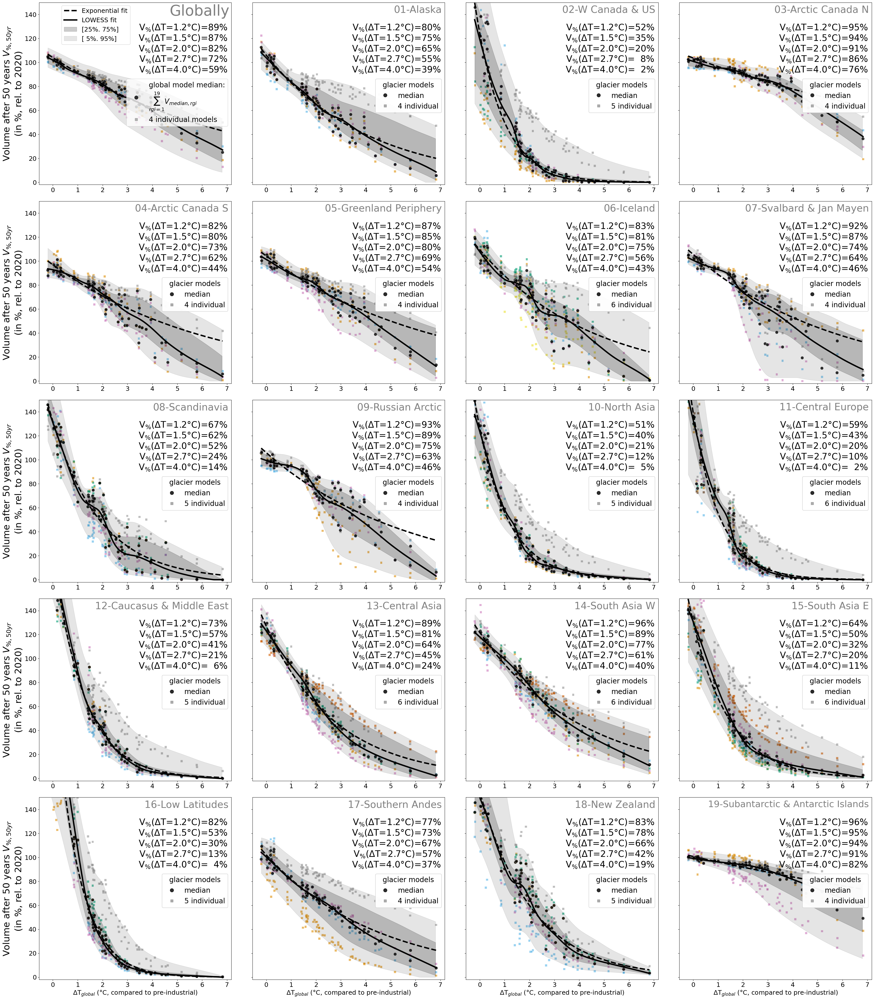

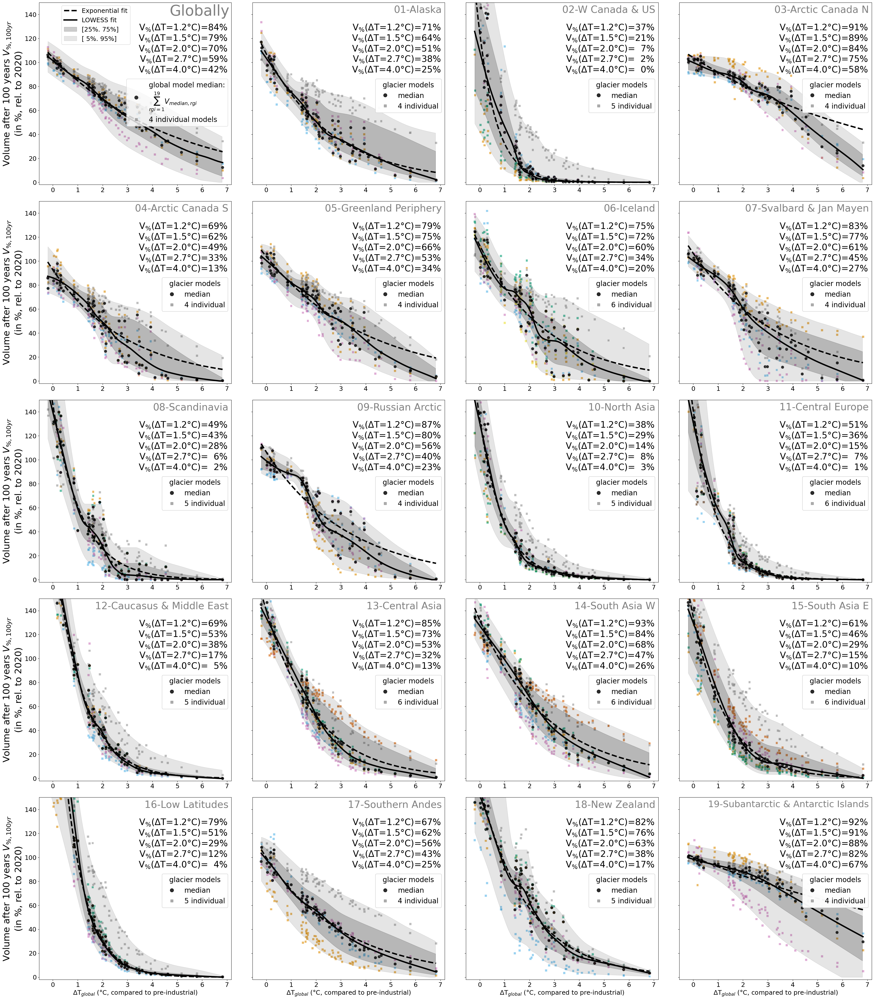

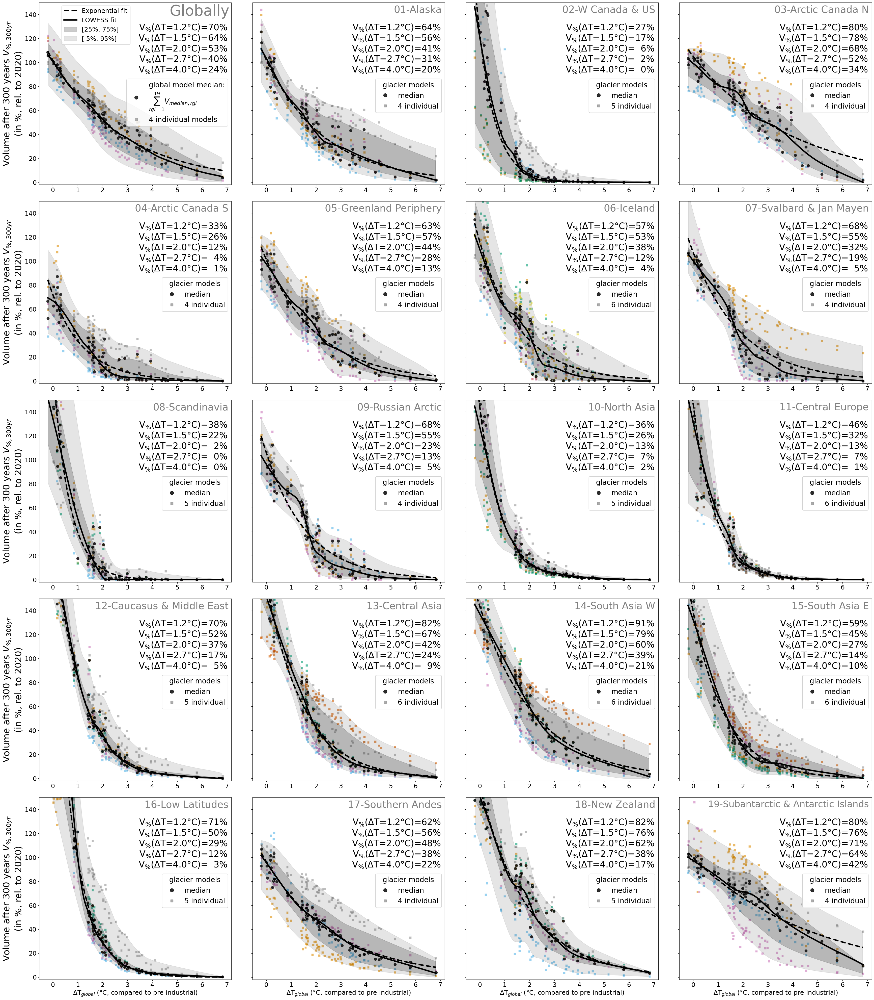

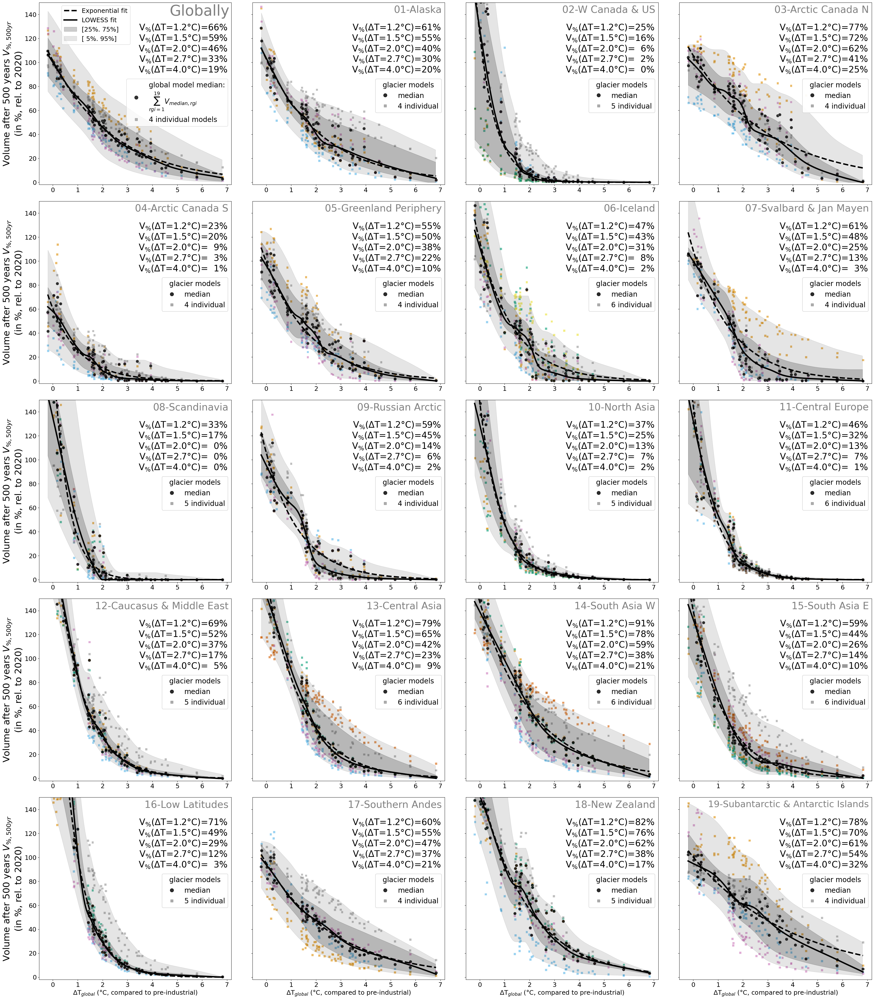

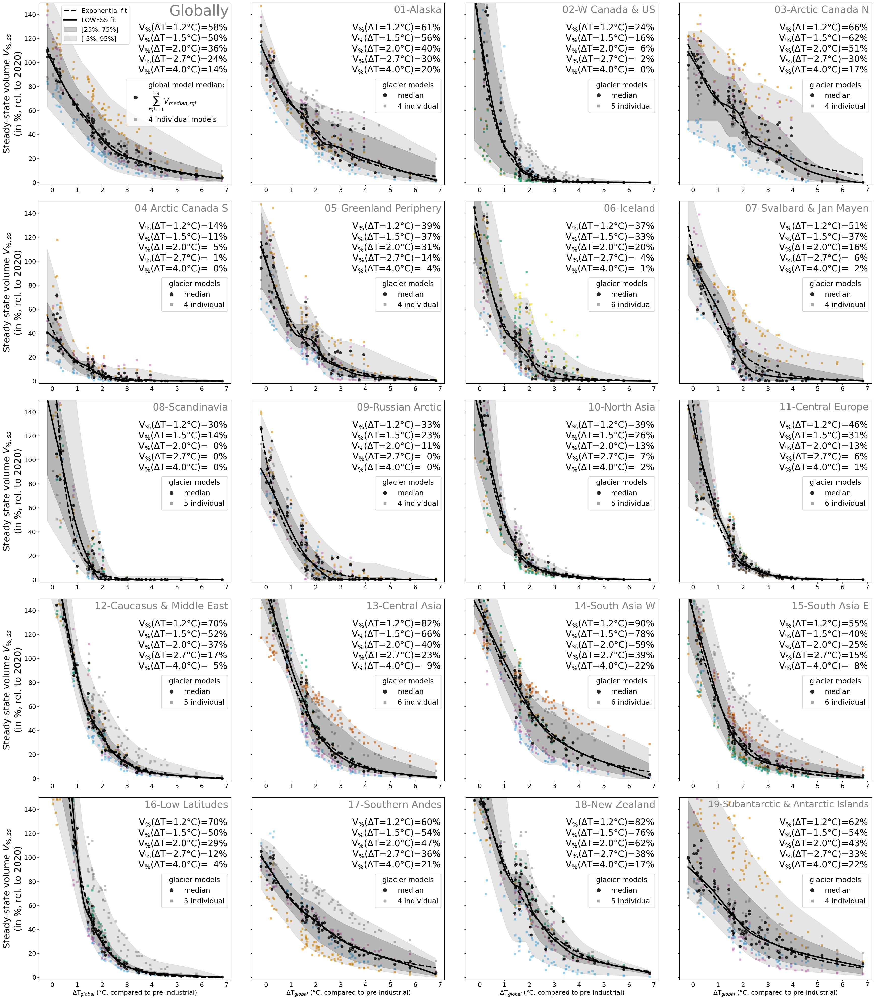

In [24]:
fig_s8  = False  # for Fig. S8 (lowess fit vs regional temp. change )-> use
# volume change vs regional temp. change:  median, lowess fit but not quantiles shown because ...
# if globally, the median comes from all estimates (also from those models that are only available for some RGI regions ...)
# but it is the median over the experiments, so it should be ok, to do that, 
# the lowess fit for the median is also done over these medians (80 exps.) separately (rel. to global glacier-area temp., so 
# there the fit is ok to have (but not the uncertainties, as those are, at the moment coming directly from the sum of the exps)
fig_s_only_global_models = False  # only global models ... 
#### PROBLEM HERE --> THE GLOBAL MODEL has not been fitted with the regional sums, probably it is best to just simplify the figure and to just show the global figure with the fit using all data ... instead .... TODO ... 
############## 
temp_ch = ''
f_path = '/home/users/lschuster/GlacierMIP3/2023_exploratory_analysis_notebooks/'
shift_years = True
if shift_years:
    p_shift = '_shift_years_rel_2020'
else:
    p_shift = ''
f_path_f = f'{f_path}figures/'

temp_above_0_8 = False
add_lowess =True


def exponential_decay(x, a, b):
    # avoind overflow -> does not work ... 
    exp_values = -b * x
    #exp_values = np.clip(exp_values, -709, 709)  # Clip values to avoid overflow
    return a * np.exp(exp_values) #+ c * np.exp(-d * x**2)#**c 
remove_local_minima = True
qs = [0.05,0.25,0.5,0.75,0.95]
sim_years = [50, 100,300,500,5000]

ylim1 = 150 #%
#ylim1 = 600
#sim_years = [5000]

if fig_s8:
    sim_years = [5000] # only have that computed
    temp_ch = 'regional_glacier'
else:
    temp_ch = ''

##########
if fig_s_only_global_models:
    path_only_glob = '_only_global_models'
    sim_years = [5000] # only have that computed
else:
    path_only_glob = ''
    
for sim_year in sim_years: # 
    sel_l = []
    df_quantiles_l = []
    if sim_year <5000:
        avg_over = '21yr'
    else:
        avg_over = '101yr'
        
    if temp_above_0_8:
        add= '_temp_above_0_8'
    else:
        add = ''

    if fit_to_median:
        add = add + '_fit_to_median'
    if add_lowess:
        add = add + '_lowess_added'
    if len(qs)>1:
        add = add + '_quantiles_added'
    if remove_local_minima:
        addi = add + '_removed_local_minima'
    ### read the fitted stuff 
    # (from http://localhost:7261/lab/workspaces/auto-C/tree/GlacierMIP3/2023_exploratory_analysis_notebooks/lowess_fits/lowess_percentile_interval_fit_per_region_added_uncertainties.py)
    if temp_ch != 'regional_glacier':
        pd_exp_decay_fits_simple = pd.read_csv(f'{f_path}lowess_fits/fitted_glacier_response_to_global_temp_ch_simple{p_shift}_{avg_over}_avg_period{add}_current12deg_{sim_year}_{DATE}{path_only_glob}.csv', index_col=[0])
        pd_quantiles_concat = pd.read_csv(f'{f_path}lowess_fits/fitted_lowess{p_shift}_{avg_over}_avg_period{add}_current12deg_{sim_year}_{DATE}{path_only_glob}.csv', index_col=[0])
        pd_sel = pd.read_csv(f'{f_path}lowess_fits/fitted_lowess_best_frac{p_shift}_{avg_over}_avg_period{add}_current12deg_{sim_year}_{DATE}{path_only_glob}.csv', index_col=[0])
    else:
        pd_exp_decay_fits_simple = pd.read_csv(f'{f_path}lowess_fits/fitted_glacier_response_to_reg_glacier_temp_ch_simple{p_shift}_{avg_over}_avg_period{add}_current12deg_reg_glacier_temp_ch_{sim_year}_{DATE}.csv', index_col=[0])
        pd_quantiles_concat = pd.read_csv(f'{f_path}lowess_fits/fitted_lowess{p_shift}_{avg_over}_avg_period{add}_current12deg_reg_glacier_temp_ch_{sim_year}_{DATE}.csv', index_col=[0])
        pd_sel = pd.read_csv(f'{f_path}lowess_fits/fitted_lowess_best_frac{p_shift}_{avg_over}_avg_period{add}_current12deg_reg_glacier_temp_ch_{sim_year}_{DATE}.csv', index_col=[0]) 
        
    assert pd_sel.year.unique() == sim_year
    pd_exp_decay_fits_simple = pd_exp_decay_fits_simple.loc[pd_exp_decay_fits_simple.year == sim_year]
    # aggregate regional quantiles to get global quantile estimate 
    # for the median, we do the fit directly using the individual median fits 
    pd_vol_2020 = pd.read_csv(f'rgi_vs_2020_volume_hugonnet_estimates{DATE}.csv', index_col=[0])
    pd_sel['vol_2020_reg_m3'] = np.NaN
    for rgi_reg in pd_sel.region.unique():
        if rgi_reg == 'All':
            _rgi_reg = 'Globally'
        else:
            _rgi_reg = rgi_reg
        vol_2020 = pd_vol_2020.loc[_rgi_reg, f'regional_volume_m3_2020{approach}']
        pd_sel.loc[pd_sel.region == rgi_reg, 'vol_2020_reg_m3'] = vol_2020
    for q in qs:
        q = str(q)
        pd_sel[f'{q}_m3'] = pd_sel[f'{q}'] * pd_sel['vol_2020_reg_m3'] /100
        
        
    pd_sel_q_glob = pd_sel.loc[pd_sel.region != 'All']
    # only select the values in a 0.05 temp. grid:
    pd_sel_q_glob = pd_sel_q_glob.where(np.isnan(pd_sel_q_glob.y)).dropna(how='all')
    pd_sel_q_glob = pd_sel_q_glob.reset_index()
    global_vol_2020_m3 = pd_vol_2020.loc['Globally',f'regional_volume_m3_2020{approach}']
    pd_sel_global_sum_over_reg_fitted_quantiles = 100*pd_sel_q_glob[['x','0.05_m3', '0.25_m3', '0.5_m3',
           '0.75_m3', '0.95_m3']].groupby('x').sum()/global_vol_2020_m3
    pd_sel_global_sum_over_reg_fitted_quantiles = pd_sel_global_sum_over_reg_fitted_quantiles.rename(columns = {'0.05_m3':'0.05', '0.25_m3':'0.25', '0.5_m3':'0.5',
           '0.75_m3':'0.75', '0.95_m3':'0.95'})
        
    if sim_year==5000:
        v_n = r'$V_{\%,ss}$'
        state = 'Steady-state volume'
    elif sim_year == 50:
        v_n = r'$V_{\%,50yr}$'
        state = 'Volume after 50 years'
    elif sim_year == 100:
        v_n = r'$V_{\%,100yr}$'
        state = 'Volume after 100 years'
    elif sim_year == 300:
        v_n = r'$V_{\%,300yr}$'
        state = 'Volume after 300 years'
    elif sim_year ==500:
        v_n = r'$V_{\%,500yr}$'
        state = 'Volume after 500 years'
    if avg_over=='100yr':
        sim_year_avg = 100
    elif avg_over=='101yr':
        sim_year_avg = 101
    elif avg_over=='60yr':
        sim_year_avg = 60
    else:
        sim_year_avg = 20
    fig, axs = plt.subplots(5,4,figsize=(35,40), sharey=True) #, sharey='row') #, sharex=True)
    if path_only_glob != '_only_global_models':
        if shift_years:
            ds_reg_models_med_vol_roll = ds_reg_yr_shift_vol_med.rolling(year_after_2020=sim_year_avg, center=True).mean().dropna(dim='year_after_2020', how='all').sel(year_after_2020=slice(0,sim_year))
            ds_reg_models_vol_roll = ds_reg_yr_shift_vol.rolling(year_after_2020=sim_year_avg, center=True).mean().dropna(dim='year_after_2020', how='all').sel(year_after_2020=slice(0,sim_year))
        else:
            ds_reg_models_med_vol_roll = ds_reg_models_med_vol.rolling(simulation_year=sim_year_avg, center=True).mean().dropna(dim='simulation_year', how='all').sel(simulation_year=slice(0,sim_year))
            ds_reg_models_vol_roll = ds_reg_models_vol.rolling(simulation_year=sim_year_avg, center=True).mean().dropna(dim='simulation_year', how='all').sel(simulation_year=slice(0,sim_year))
    else:
        # only global models !!! 
        ds_reg_models_med_vol_global = ds_reg_yr_shift_vol.dropna(dim='model_author', how='any').median(dim='model_author')
        ds_reg_models_med_vol_roll = ds_reg_models_med_vol_global.rolling(year_after_2020=sim_year_avg, center=True).mean().dropna(dim='year_after_2020', how='all').sel(year_after_2020=slice(0,sim_year))
        ds_reg_models_vol_roll = ds_reg_yr_shift_vol.rolling(year_after_2020=sim_year_avg, center=True).mean().dropna(dim='year_after_2020', how='all').sel(year_after_2020=slice(0,sim_year))
        ds_reg_models_vol_roll = ds_reg_models_vol_roll.dropna(dim='model_author', how='any')
        #pd_exp_decay_fits_simple_g = pd.read_csv(f'{f_path}lowess_fits/fitted_glacier_response_to_global_temp_ch_simple{p_shift}_{avg_over}_avg_period{add}_fit_over_global_estimates_current12deg_{sim_year}_{DATE}{path_only_glob}.csv', index_col=[0])
        #pd_quantiles_concat_g = pd.read_csv(f'{f_path}lowess_fits/fitted_lowess{p_shift}_{avg_over}_avg_period{add}_fit_over_global_estimates_current12deg_{sim_year}_{DATE}{path_only_glob}.csv', index_col=[0])
        #pd_sel_g = pd.read_csv(f'{f_path}lowess_fits/fitted_lowess_best_frac{p_shift}_{avg_over}_avg_period{add}_fit_over_global_estimates_current12deg_{sim_year}_{DATE}{path_only_glob}.csv', index_col=[0])
        
    for j, rgi_reg in enumerate(rgi_regs_global):
        if rgi_reg == 'All':
            _rgi_reg = 'Globally'
        else:
            _rgi_reg = rgi_reg
        vol_2020_reg = pd_rgi_stats_w_hugonnet.loc[_rgi_reg][f'regional_volume_m3_2020{approach}']

        if j<4:
            ax = axs[0][j]
        elif j <8:
            ax = axs[1][j-4]
        elif j <12:
            ax = axs[2][j-8]
        elif j <16:
            ax = axs[3][j-12]
        elif j <20:
            ax = axs[4][j-16]

        region = f'RGI{rgi_reg}_glacier'

        if rgi_reg == 'All':
            # get the temp.
            if temp_ch != 'regional_glacier':
                pd_global_temp_exp_m = get_glob_temp_exp(region='global')
            else:
                pd_global_temp_exp_m = get_glob_temp_exp(region='global_glacier')
                
            if path_only_glob != '_only_global_models':

                if shift_years:
                    # we have done the dropping of everything after 4950, so the last year should be fine 
                    ds_reg_models_med_vol_sel = ds_reg_models_med_vol_roll.isel(year_after_2020=-1).sum(dim='rgi_reg')
                    # make sure that we only take here global models ... 
                    ds_t2 = ds_reg_models_vol_roll.sum(dim='rgi_reg', min_count=19).isel(year_after_2020=-1).dropna(dim='model_author')
                    ds_t2 = 100*ds_t2/vol_2020_reg
                    ds_t = 100*ds_reg_models_med_vol_sel/vol_2020_reg # TODO checkt that this is the sum ... 

                else:
                    ds_reg_models_med_vol_sel = ds_reg_models_med_vol_roll.isel(simulation_year=-1).sum(dim='rgi_reg')
                    # make sure that we only take here global models ... 
                    ds_t2 = ds_reg_models_vol_roll.sum(dim='rgi_reg', min_count=19).isel(simulation_year=-1).dropna(dim='model_author')
                    ds_t2 = 100*ds_t2/ds_reg_models_vol.isel(simulation_year=0).sum(dim='rgi_reg', min_count=19)

                    ds_t = 100*ds_reg_models_med_vol_sel/ds_reg_models_med_vol.isel(simulation_year=0).sum(dim='rgi_reg')
            else:
                # with global models -> first sum over the regions, and then do the 
                if shift_years:
                    #  the median should here also be the median over the summed up values 
                    ds_reg_models_med_vol_sel = ds_reg_models_vol_roll.isel(year_after_2020=-1).sum(dim='rgi_reg').median(dim='model_author')
                    # make sure that we only take here global models ... 
                    ds_t2 = ds_reg_models_vol_roll.sum(dim='rgi_reg', min_count=19).isel(year_after_2020=-1).dropna(dim='model_author')
                    ds_t2 = 100*ds_t2/vol_2020_reg
                    ds_t = 100*ds_reg_models_med_vol_sel/vol_2020_reg # TODO checkt that this is the sum ... 
                else:
                    raise NotImplementedError()

            pd_tt2 = ds_t2.to_dataframe()
            try:
                pd_tt2 = pd_tt2.drop(columns=['gcm','period_scenario'])
            except:
                pass
            pd_tt2 = pd_tt2.reset_index()
        else:
            # get the temp. 
            if temp_ch != 'regional_glacier':
                pd_global_temp_exp_m = get_glob_temp_exp(region='global')
            else:
                pd_global_temp_exp_m = get_glob_temp_exp(region=region)

            if fit_to_median:
                if shift_years:
                    # TODO
                    ds_t2 = ds_reg_models_vol_roll.sel(rgi_reg=rgi_reg).isel(year_after_2020=-1).dropna(dim='model_author')
                    ds_t2 = 100*ds_t2/vol_2020_reg
                else:
                    ds_t2 = ds_reg_models_vol_roll.sel(rgi_reg=rgi_reg).isel(simulation_year=-1).dropna(dim='model_author')
                    ds_t2 = 100*ds_t2/ds_reg_models_vol.isel(simulation_year=0).sel(rgi_reg=rgi_reg)
                ds_t = ds_t2.median(dim='model_author') 

                pd_tt2 = ds_t2.to_dataframe()
                try:
                    pd_tt2 = pd_tt2.drop(columns=['gcm','period_scenario'])
                except:
                    pass
                pd_tt2 = pd_tt2.reset_index()
            else:
                if shift_years:
                    # TODO
                    ds_t = ds_reg_models_vol_roll.sel(rgi_reg=rgi_reg).isel(year_after_2020=-1).dropna(dim='model_author')
                    ds_t = 100*ds_t/vol_2020_reg
                else:
                    ds_t = ds_reg_models_vol_roll.sel(rgi_reg=rgi_reg).isel(simulation_year=-1).dropna(dim='model_author')
                    ds_t = 100*ds_t/ds_reg_models_vol.isel(simulation_year=0).sel(rgi_reg=rgi_reg)
        pd_tt = ds_t.to_dataframe()
        try:
            pd_tt = pd_tt.drop(columns=['gcm','period_scenario'])
        except:
            pass
        pd_tt = pd_tt.reset_index()
        print(pd_tt['volume_m3'].max())

        # much better if we create a gcm_period_scenario column to later assign the correct temp. series ... 
        pd_global_temp_exp_m_r = pd_global_temp_exp_m.reset_index()
        pd_global_temp_exp_m_r['gcm'+'_'+'period_scenario'] = pd_global_temp_exp_m_r['gcm'] +'_'+pd_global_temp_exp_m_r['period_scenario']
        pd_global_temp_exp_m_r.index = pd_global_temp_exp_m_r['gcm'+'_'+'period_scenario']
        pd_tt2['gcm'+'_'+'period_scenario'] = pd_tt2['gcm'] +'_'+pd_tt2['period_scenario']
        pd_tt2.index = pd_tt2['gcm'+'_'+'period_scenario']
        pd_tt2.loc[pd_global_temp_exp_m_r.index, 'temp_ch_ipcc'] = pd_global_temp_exp_m_r['temp_ch_ipcc']
        pd_tt2 = pd_tt2.reset_index(drop=True)

        pd_tt['gcm'+'_'+'period_scenario'] = pd_tt['gcm'] +'_'+pd_tt['period_scenario']
        pd_tt.index = pd_tt['gcm'+'_'+'period_scenario']
        pd_tt.loc[pd_global_temp_exp_m_r.index, 'temp_ch_ipcc'] = pd_global_temp_exp_m_r['temp_ch_ipcc']
        pd_tt = pd_tt.reset_index(drop=True)
        pd_tt_above0 = pd_tt #.loc[pd_tt.volume_m3>0]  ## probably it is ok to also fit the zero volume estimates 
        # if I want to remove the very uncertain experiments,
        # I still want to keep those that are near to 
        # 1.2°C. However, there are no experiments directly at 1.2°C
        # and only one at +1, so, we should rather do the fit with >= +0.8°C
        if temp_above_0_8:
            pd_tt_above0 = pd_tt_above0.loc[pd_tt_above0['temp_ch_ipcc']>=0.8]
        temp = pd_tt_above0['temp_ch_ipcc'].values

        q = 'volume_m3' # this is actually the 'relative volume change (in %)'
        rel_vol = pd_tt_above0[q].values

        if rgi_reg == 'All':
            ax.text(0.99, 0.99, 'Globally', color='grey',transform=ax.transAxes, fontsize=42, va='top', ha='right')
        else:
            nam = d_reg_num_name[rgi_reg]
            if rgi_reg == '19':
                fs_rgi = 26
            else:
                fs_rgi = 28
            ax.text(0.985, 0.985, f'{rgi_reg}-{nam}', color='grey',transform=ax.transAxes, fontsize=fs_rgi, va='top', ha='right')

        ax.set_ylabel(f'{state} '+f'{v_n}'+'\n(in %, rel. to 2020)', fontsize=26)
        
        if temp_ch == 'regional_glacier':
            leg2y = 0.57
        else:
            leg2y = 0.6
        if show_color_models:                    
            if rgi_reg=='All':
                pd_ttx = pd_tt2
                pd_ttxx = pd_tt
                # add legend...
                n_models = len(pd_ttx.model_author.unique())
                if path_only_glob != '_only_global_models':
                    label = 'global model median:\n'+r'$\sum_{rgi=1}^{19} V_{median,rgi}$'
                else:
                    label = 'median of global models:\n'+r'median ($\sum_{rgi=1}^{19} V_{rgi}$)'
                line1 = Line2D([0], [0],
                               label=label,
                               color='black', ms=10, marker='o', lw=0,alpha = 0.8)
                line2 = Line2D([0], [0], label=f'{n_models} individual models', color='grey', ms=7, marker='s', lw=0,alpha = 0.6)
                #add handles
                handles= [line1, line2]
                #add legend
                leg2=ax.legend(handles=handles, loc = 'upper right', fontsize=20, title_fontsize=20, bbox_to_anchor=(1,leg2y))
            else:
                if fit_to_median:
                    pd_ttx = pd_tt2
                    pd_ttxx = pd_tt
                else:
                    pd_ttx = pd_tt
                    pd_ttxx = pd_tt[['temp_ch_ipcc', 'volume_m3']].groupby(['temp_ch_ipcc']).median().reset_index()
                n_models = len(pd_ttx.model_author.unique())
                line1 = Line2D([0], [0], label='median', color='black', ms=10, marker='o', lw=0,alpha = 0.8)
                line2 = Line2D([0], [0], label=f'{n_models} individual', color='grey', ms=7, marker='s', lw=0,alpha = 0.6)

                #add handles
                handles= [line1, line2]
                #add legend
                leg2=ax.legend(handles=handles, title='glacier models',
                              loc = 'upper right', fontsize=20, title_fontsize=20, bbox_to_anchor=(1,leg2y))
            sns.scatterplot(ax=ax,x='temp_ch_ipcc',
                            y='volume_m3', #'volume (km3)',
                            data = pd_ttx,
                            hue_order=hue_order,
                            hue='model_author',
                            palette=pal_models,
                            legend=False, s=40, alpha = 0.6, marker='s')
            # if globally, the median comes from all estimates (also from those models that are only available for some RGI regions ...)
            # but it is the median over the experiments, so it should be ok, to do that, 
            # the lowess fit for the median is also done over these medians (80 exps.) separately (rel. to global glacier-area temp., so 
            # there the fit is ok to have (but not the uncertainties, as those are, at the moment coming directly from the sum of the exps)
            sns.scatterplot(ax=ax,
                        x='temp_ch_ipcc',
                        y='volume_m3', #'volume (km3)',
                        data = pd_ttxx,
                        color='black',
                        #hue='temp_ch_ipcc',
                        #palette='flare',
                        legend=False, s=80, alpha = 0.8)

        else:
            sns.scatterplot(ax=ax,
                        x='temp_ch_ipcc',
                        y='volume_m3', #'volume (km3)',
                        data = pd_tt,
                        color='black',
                        #hue='temp_ch_ipcc',
                        #palette='flare',
                        legend=False, s=80, alpha = 0.3)
        if temp_ch == 'regional_glacier':
            ax.set_xlabel(r'$\Delta$T$_{reg,glacier-area}$ (°C, compared to pre-industrial)')
        else:
            ax.set_xlabel(r'$\Delta$T$_{global}$ (°C, compared to pre-industrial)')
        #plt.plot(temp, rel_vol, 'o', alpha =0.2)
        x,y = temp, rel_vol

        x_dense = np.linspace(x.min(), x.max(), 100)
        # Extract the optimized parameters
        if (path_only_glob != '_only_global_models') or (rgi_reg !='All'):

            a_opt = pd_exp_decay_fits_simple.loc[pd_exp_decay_fits_simple.rgi_reg==rgi_reg]['a_simple'].values.squeeze()
            b_opt = pd_exp_decay_fits_simple.loc[pd_exp_decay_fits_simple.rgi_reg==rgi_reg]['b_simple'].values.squeeze()
        else:
            pd_exp_decay_fits_simple_g = pd.read_csv(f'{f_path}lowess_fits/fitted_glacier_response_to_global_temp_ch_simple{p_shift}_{avg_over}_avg_period{add}_fit_over_global_estimates_current12deg_{sim_year}_{DATE}{path_only_glob}.csv', index_col=[0])
            a_opt = pd_exp_decay_fits_simple_g.loc[pd_exp_decay_fits_simple_g.rgi_reg==rgi_reg]['a_simple'].values.squeeze()
            b_opt = pd_exp_decay_fits_simple_g.loc[pd_exp_decay_fits_simple_g.rgi_reg==rgi_reg]['b_simple'].values.squeeze()

        
        # Compute the fitted y values
        y_fitted = exponential_decay(x_dense-current_deltaT, a_opt, b_opt)

        #func_vars= f'exponential fit:\n{v_n}'+r'(ΔT)='+f'{a_opt:.1f}'+r'$\cdot$'+f'exp(-{b_opt:.2f}'+r'$\cdot$ΔT))' #\n+'+f'{c_opt:.1f}*exp(-{d_opt:.2f}*ΔT²)' #+{c_opt:.2f}'
        #r'V$_{ss,rel}$(ΔT)=a$\cdot$e'+r'$^{-b\cdot(ΔT-1.2)}$'
        if current_deltaT !=0:
            if temp_ch == 'regional_glacier':
                #func_vars= r'$V_{\%}$(ΔT$_{reg}$)='+f'{a_opt:.1f}*exp(-{b_opt:.2f}*('+r'ΔT$_{reg}$'+f'-{current_deltaT}°C))' 
                func_vars= f'exponential fit: '+f'{a_opt:.1f}'+r'$\cdot$'+f'exp(-{b_opt:.2f}'+r'$\cdot$(ΔT$_{reg}$-'+f'{current_deltaT}°C))'

                fs_label = 14
            else:
                #func_vars= r'$V_{\%}$(ΔT)='+f'{a_opt:.1f}*exp(-{b_opt:.2f}*(ΔT-{current_deltaT}°C))' 
                func_vars= f'exponential fit: '+f'{a_opt:.1f}'+r'$\cdot$'+f'exp(-{b_opt:.2f}'+r'$\cdot$(ΔT-'+f'{current_deltaT}°C))'
                fs_label = 18
            #\n+'+f'{c_opt:.1f}*exp(-{d_opt:.2f}*ΔT²)' #+{c_opt:.2f}'
        
        func_vars = 'Exponential fit'  # just to make it shorter!
        ax.plot(x_dense, y_fitted, '--', label=func_vars,
                color='black', lw=4)


        if temp_ch == 'regional_glacier':
            ax.set_xlim([pd_global_temp_exp_glac['temp_ch_ipcc'].min()*1.001, pd_global_temp_exp_glac['temp_ch_ipcc'].max()*1.001])
            #ax.set_ylim([-2,400])
        else:
            # ax.set_ylim([-2,ylim1])
            pass
        ax.set_ylim([-2,ylim1])


        if j<16:
            ax.set_xlabel('')
        if j not in [0,4,8,12,16,20]:
            ax.set_ylabel('')
        add_lowess = True
        if add_lowess:
            if (path_only_glob == '_only_global_models') and (rgi_reg =='All'):
                pd_sel_g = pd.read_csv(f'{f_path}lowess_fits/fitted_lowess_best_frac{p_shift}_{avg_over}_avg_period{add}_fit_over_global_estimates_current12deg_{sim_year}_{DATE}{path_only_glob}.csv', index_col=[0])
                sel = pd_sel_g.loc[pd_sel_g.region == rgi_reg]
            else:
                sel = pd_sel.loc[pd_sel.region == rgi_reg]

            text = ''
            for temp in [1.2,1.5,2.0,2.7,4.0]:
                try:
                    #usually that works, but sometimes several values are found..
                    Ttemp_vol = int(sel.loc[np.round(sel.index,2)==temp, '0.5'].round(0)) #c_opt
                except:
                    # in that case just select the nearest one
                    Ttemp_vol  = int(sel.iloc[np.abs(sel.index - temp).argmin()]['0.5'].round(0))
                    Ttemp_vol_test = sel.loc[np.round(sel.index,2)==temp, '0.5'].round(0).values #) #c_opt
                    # just make sure that the correct temperature is selected ...
                    np.testing.assert_allclose(sel.reset_index().iloc[np.abs(sel.index - temp).argmin()].x,temp, rtol = 1e-3)
                
                if Ttemp_vol < 10:
                    Ttemp_vol = f'  {Ttemp_vol}'
                if temp_ch == 'regional_glacier':
                    num_x=0.98
                    num_y=0.51
                    text = text+r'V$_{\%}$'+r'(ΔT$_{reg}$='+f'{temp}°C)'+f'={Ttemp_vol}%\n'
                else:
                    num_x=0.98
                    num_y=0.55
                    text = text+r'V$_{\%}$'+f'(ΔT='+f'{temp}°C)'+f'={Ttemp_vol}%\n'
            ax.text(num_x, num_y, text, color='black',transform=ax.transAxes, fontsize=25, va='bottom', ha='right')
            
            
            
            print(rgi_reg, sel.frac.unique())

            ax.plot(sel.index, sel['0.5'], color='black', lw=4, label='LOWESS fit')
            if len(qs)>1:
                if (rgi_reg == 'All') & (temp_ch == 'regional_glacier'):
                    # we can not use the quantiles fitted over regional glacier temp. change and sum the up to get the 
                    # as in the "ALL" subplot we show the results related to the glacier-area weighted
                    pass 
                else:
                    if (rgi_reg != 'All') or (path_only_glob == '_only_global_models'):
                        _sel = sel
                    else:
                        _sel = pd_sel_global_sum_over_reg_fitted_quantiles
                    if remove_local_minima:
                        if rgi_reg != 'All':
                            ax.fill_between(_sel.loc[np.isnan(_sel.y)].index, np.minimum.accumulate(_sel.loc[np.isnan(_sel.y)]['0.25'].values),
                                            np.minimum.accumulate(_sel.loc[np.isnan(_sel.y)]['0.75'].values),
                                            color='black', alpha = 0.2, label = '[25%. 75%]')
                            ax.fill_between(_sel.loc[np.isnan(_sel.y)].index, np.minimum.accumulate(_sel.loc[np.isnan(_sel.y)]['0.05'].values),
                                            np.minimum.accumulate(_sel.loc[np.isnan(_sel.y)]['0.95'].values),
                                            color='black', alpha = 0.1, label= '[ 5%. 95%]')
                        else:
                            ax.fill_between(_sel.index, np.minimum.accumulate(_sel['0.25'].values),
                                            np.minimum.accumulate(_sel['0.75'].values),
                                            color='black', alpha = 0.2, label = '[25%. 75%]')
                            ax.fill_between(_sel.index,np.minimum.accumulate(_sel['0.05'].values),
                                            np.minimum.accumulate(_sel['0.95'].values),
                                            color='black', alpha = 0.1, label= '[ 5%. 95%]')

                    else:
                        ax.fill_between(_sel.index, _sel['0.25'], _sel['0.75'], color='black', alpha = 0.2, label = '[25%. 75%]')
                        ax.fill_between(_sel.index, _sel['0.05'], _sel['0.95'], color='black', alpha = 0.1, label= '[ 5%. 95%]')
            
            #if j<2:
            if ((j == 1) and (temp_ch == 'regional_glacier')) or ((temp_ch != 'regional_glacier') and (rgi_reg == 'All')): #rgi_reg == '':
                #plt.savefig(f'{f_path_f}test.png')
                if temp_ch == 'regional_glacier':
                    leg1x = 1
                    leg1y = 0.35
                    fs_label1 = fs_label+5
                else:
                    leg1x = 0.49
                    leg1y = 1
                    fs_label1 = fs_label
                ax.legend(fontsize=fs_label1, loc='upper right', bbox_to_anchor=(leg1x,leg1y),
                          ncol=1)

            ax.add_artist(leg2)

    plt.tight_layout()
    if ylim1 == 600:
        addi = addi + '_ylim600'
    addi = addi + path_only_glob
    if temp_ch != 'regional_glacier':
        plt.savefig(f'{f_path_f}2_glacier_volume_yr_simple{p_shift}_{sim_year}_{avg_over}_avg_period_exp_decay_fit{addi}_current12deg_{DATE}.png')
    else:
        plt.savefig(f'{f_path_f}2_glacier_volume_yr_simple{p_shift}_{sim_year}_{avg_over}_avg_period_exp_decay_fit{addi}_current12deg_reg_glacier_temp_ch_{DATE}.png')


Ideas for Fig. 1:

- for every region, all 80 experiments as lines dependent on the warming scenario (blue to red), either with global warming or regional warming 
- assumptions:
    - do the median over the up to 10 glacier models for every RGI region and all 80 experiments, 
    - add the medians to gether to get the global median volume change estimates
    - repeat the same for the quantiles (0.05,0.25,0.5,0.75,0.95) ...

Do it now with all GCMs at once:

- the variability might change after year 2000, due to the extension by repetition of only the last 20 years...

**here are some global warming sampling statistics**

In [25]:
ds_reg_models_med_vol_sel = ds_reg_models_med_vol_roll.sum(dim='rgi_reg')

ds_reg_models_med_vol_sel = ds_reg_models_med_vol_sel.assign_coords(temp_ch_ipcc = ('experiments',
                                                                          pd_global_temp_exp_m.loc[ds_reg_models_med_vol_sel.experiments, # make sure thatwe use the same experiments pd_global_temp_exp_m_glac
                                                                                                 'temp_ch_ipcc']))

for deltaT in [0.0,1.2, #1.2, 1.2 is just too unclear ... 
               1.5,2.0,3.0,4.0]:
    print(deltaT)
    for t_range in [0.1,0.15,0.2,0.25]:

        _deltaT_sel = ds_reg_models_med_vol_sel.where((ds_reg_models_med_vol_sel.temp_ch_ipcc>deltaT-t_range) & (ds_reg_models_med_vol_sel.temp_ch_ipcc<deltaT+t_range)).dropna(dim='experiments')
        n_deltaT=len(_deltaT_sel.experiments)
        print(t_range, n_deltaT, _deltaT_sel.temp_ch_ipcc.mean().values)
    print('\n')

0.0
0.1 2 0.03251493262155865
0.15 3 0.06532585345946014
0.2 7 0.0779102887300557
0.25 9 0.06497062577083884


1.2
0.1 0 nan
0.15 0 nan
0.2 0 nan
0.25 5 1.340803112865842


1.5
0.1 9 1.4907660648332721
0.15 15 1.5442914836153225
0.2 17 1.5588677646704547
0.25 17 1.5588677646704547


2.0
0.1 6 2.00975390291681
0.15 12 2.023811190683504
0.2 12 2.023811190683504
0.25 12 2.023811190683504


3.0
0.1 3 3.0040449963905638
0.15 5 2.958790852856292
0.2 5 2.958790852856292
0.25 7 2.904579003110286


4.0
0.1 2 3.9361270080247026
0.15 3 3.990784131287062
0.2 3 3.990784131287062
0.25 4 3.9309511334360128




**Here is the plot that highlights more  the median experiments over specific warming levels...**

In [26]:
['#70B8FF', '#4D8ED6', '#306BAF', '#1A488A', '#002966'][::-1]

['#002966', '#1A488A', '#306BAF', '#4D8ED6', '#70B8FF']

In [27]:
def get_glob_temp_exp(region='global'):
    pd_global_temp_exp_glac = pd.read_csv('../data/temp_ch_ipcc_isimip3b_glacier_regionally.csv', index_col = 0)
    _p = pd_global_temp_exp_glac.loc[pd_global_temp_exp_glac.region == region]
    #print(_p.groupby(['gcm','period_scenario']).mean('temp_ch_ipcc'))
    _p = _p.groupby(['gcm','period_scenario']).mean('temp_ch_ipcc')
    return _p
glob_temp_ch = get_glob_temp_exp(region='global')['temp_ch_ipcc'].values
from matplotlib.colors import LinearSegmentedColormap
from sklearn.preprocessing import MinMaxScaler
only_12_range = False
if only_12_range:
    colors_icci_l3 = ['#70B8FF', '#FABB00', '#F25100', '#D42300', '#B3001E', '#800040', '#550066', '#2B084D']
    cmap_icci_3 = LinearSegmentedColormap.from_list('bins_100', colors_icci_l3, N=1000)
    # IDEA --> Let's scale from 1.2 onwards
    scaler = MinMaxScaler()
    temp_ch_sel = np.arange(1.2,glob_temp_ch.max(),0.25)
    scaler.fit(temp_ch_sel.reshape(-1,1))
    cmap = cmap_icci_3
else:
    ## '#306BAF', '#1A488A', '#002966'
    ## '#4D8ED6',
    colors_full_temp_range = ['#002966', '#306BAF', '#70B8FF','#FABB00', '#F25100', '#D42300', '#B3001E', '#800040', '#550066', '#2B084D']
    cmap_full_temp_range = LinearSegmentedColormap.from_list('bins_100', colors_full_temp_range, N=1000)
    # IDEA --> Let's scale from the entire range onwards onwards
    scaler = MinMaxScaler()
    temp_ch_sel = np.arange(-0.36,glob_temp_ch.max(),0.25)# need to manually set the minimum to a lower value to have a light blue color at ~1.2°C
    scaler.fit(temp_ch_sel.reshape(-1,1))
    cmap = cmap_full_temp_range

norm = plt.Normalize(vmin=-0.36, vmax=glob_temp_ch.max()) # we need the -0.4 for the correct norm 
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
#sm.set_clim(glob_temp_ch.min(),glob_temp_ch.max())
# ok, both approaches work the same 
assert sm.cmap == cmap

t = 1.2
import matplotlib.colors as mcolors
# just want to make sure that 1.2°C is this color here: '#70B8FF'
hex_color = '#70B8FF'
rgba_color = mcolors.to_rgba(hex_color)
c1=sm.cmap(scaler.transform(np.array(t).reshape(-1,1))).squeeze()
c2=cmap(scaler.transform(np.array(t).reshape(-1,1))).squeeze()
np.testing.assert_allclose(c1,c2)
np.testing.assert_allclose(c1,rgba_color)

In [28]:
def get_vol_timeseries_temp_ch_Xyr_glob_glacier_portrait(region='global', perc=90, sim_year=500, avg_over = '21yr', smooth_values_percentiles=1,
                                                        exp_decay_temp_fit=True, temp_above_0_8=True, landscape = True, current_deltaT = 1.2,
                                                        shift_years = False, show_slope_fit = True):

    if shift_years and exp_decay_temp_fit:
        raise NotImplementedError
    if avg_over=='101yr':
        avg_yr_int = 101
    elif avg_over=='60yr':
        avg_yr_int = 60
    elif avg_over=='21yr':
        avg_yr_int = 21
    elif avg_over=='20yr':
        avg_yr_int = 20
    elif avg_over =='3yr':
        avg_yr_int = 3


    if temp_above_0_8:
        add= '_temp_above_0_8'
    else:
        add = ''
    if shift_years:
        p_shift = '_shift_years_rel_2020'
        xx = 'year_after_2020'
    else:
        p_shift = ''
        xx = 'simulation_year'
    #print(f'fitted_glacier_response_to_global_temp_ch_simple_{avg_over}_avg_period{add}_current12deg.csv')
    if shift_years:
        ds_reg_models_med_vol_roll = ds_reg_yr_shift_vol_med.rolling(year_after_2020=avg_yr_int, center=True,
                                        min_periods=1).mean().dropna(dim='year_after_2020', how='all') #int(avg_yr_int/2+1)
        _ds_reg_models_vol = ds_reg_yr_shift_vol

    else:
        ds_reg_models_med_vol_roll = ds_reg_models_med_vol.rolling(simulation_year=avg_yr_int, center=True, min_periods=1).mean().dropna(dim='simulation_year', how='all')
        _ds_reg_models_vol = ds_reg_models_vol
    #.sel(simulation_year=slice(0,sim_year))

    q1=(50-perc/2)/100
    q2=(50+perc/2)/100


    plt.rc('font', size=24)  
    if landscape:
        fig,axs= plt.subplots(1,2,figsize=(25,10))
        add = add+'_landscape'

    else:
        fig,axs= plt.subplots(2,1,figsize=(12,20))

    ax = axs[0]
    # get global temp. change
    pd_global_temp_exp_m = get_glob_temp_exp(region='global')

    if region == 'global':
        # get global glacier temp.change
        pd_global_temp_exp_m_glac = get_glob_temp_exp(region='global_glacier')
        ds_reg_models_med_vol_sel = ds_reg_models_med_vol_roll.sum(dim='rgi_reg')
        n_models = ''
        rgi_reg = 'global'
        rgi_reg_f = 'All'

        # ATTENTION: the initial volume should not be estimated from the rolling average
        if shift_years:
            init_vol = pd_rgi_stats_w_hugonnet.loc['Globally'][f'regional_volume_m3_2020{approach}']
        else:
            init_vol = ds_reg_models_med_vol.isel(simulation_year=0).sum(dim='rgi_reg').values[0]
    else:
        # get regional glacier temp. change
        pd_global_temp_exp_m_glac = get_glob_temp_exp(region=region)
        rgi_reg = region[3:5]
        rgi_reg_f = rgi_reg
        ds_reg_models_med_vol_sel = ds_reg_models_med_vol_roll.sel(rgi_reg=rgi_reg)
        # check how many glacier models have at least some estimates
        reg_glac_models = ds_reg_models.sel(rgi_reg=rgi_reg).dropna(dim='model_author', how='all').model_author
        print(reg_glac_models.values)
        n_models = len(reg_glac_models)
        n_models = f'{n_models} '
        # ATTENTION: the initial volume should not be estimated from the rolling average, or???
        if shift_years:
            init_vol = pd_rgi_stats_w_hugonnet.loc[rgi_reg][f'regional_volume_m3_2020{approach}']
        else:
            init_vol = ds_reg_models_med_vol.isel(simulation_year=0).sel(rgi_reg=rgi_reg).values[0]
    if exp_decay_temp_fit:
        #pd_exp_decay_fits_simple = pd.read_csv(f'fitted_glacier_response_to_global_temp_ch_simple_{avg_over}_avg_period{add}_current12deg.csv', index_col=0)
        pd_exp_decay_fits_simple = pd.read_csv(f'{f_path}/lowess_fits/fitted_glacier_response_to_global_temp_ch_simple{p_shift}_{avg_over}_avg_period{add}_current12deg_{sim_year}_{DATE}.csv', index_col=[0])

        # only for exp_decay_temp_fit
        _,_,a,b = pd_exp_decay_fits_simple.loc[(pd_exp_decay_fits_simple.rgi_reg==rgi_reg_f)&(pd_exp_decay_fits_simple.year==5000)].values.squeeze()
        pd_global_temp_exp_m['fitted_vol_ch'] = a*np.exp(-b*(pd_global_temp_exp_m['temp_ch_ipcc']-current_deltaT))
        if temp_above_0_8:
            # don't plot above 0°C
            pd_global_temp_exp_m.loc[pd_global_temp_exp_m.temp_ch_ipcc<=0.8, 'fitted_vol_ch'] = np.NaN

    ds_reg_models_med_vol_sel = ds_reg_models_med_vol_sel.assign_coords(temp_ch_ipcc = ('experiments',
                                                                          pd_global_temp_exp_m.loc[ds_reg_models_med_vol_sel.experiments, # make sure thatwe use the same experiments pd_global_temp_exp_m_glac
                                                                                                 'temp_ch_ipcc']))

    ds_reg_models_med_vol_sel = ds_reg_models_med_vol_sel.assign_coords(temp_ch_ipcc_glacier = ('experiments',
                                                                          pd_global_temp_exp_m_glac.loc[ds_reg_models_med_vol_sel.experiments, # make sure thatwe use the same experiments pd_global_temp_exp_m_glac
                                                                                                 'temp_ch_ipcc']))


    # need that to have both volume_m3 and temp_ch_ipcc as variables
    ds_reg_models_med_vol_sel = ds_reg_models_med_vol_sel.reset_coords()
    ds_reg_models_med_vol_sel['relative volume change (in %)'] = 100*ds_reg_models_med_vol_sel.volume_m3/init_vol
    #print(ds_reg_models_med_vol_sel)
    pd_t =ds_reg_models_med_vol_sel.to_dataframe()
    try:
        pd_t = pd_t.drop(columns=['gcm','period_scenario'])
    except:
        pass
    pd_t = pd_t.reset_index()
    #pd_t['volume (km3)'] = pd_t['volume_m3']/1e9
    
    # due to the colorscale issue, I prefer to do a for-loop, to really be sure to have the right color:
    data_all = pd_t.loc[pd_t[xx]<sim_year]
    
    for t in pd_t['temp_ch_ipcc'].unique():
        data = data_all.loc[data_all.temp_ch_ipcc == t]
        c=cmap(scaler.transform(np.array(t).reshape(-1,1))).squeeze()
        ax.plot(data[xx], data['relative volume change (in %)'], color=c,
                 lw=0.7, alpha =0.7)
        if t == pd_t['temp_ch_ipcc'].unique()[0]:
            c0 = c
        elif t == pd_t['temp_ch_ipcc'].unique()[-1]:
            c1 = c
        
    #g = sns.lineplot(ax=ax,
    #             data=pd_t.loc[pd_t[xx]<sim_year], #-avg_yr_int/2],
    #             x=xx,
    #             y='relative volume change (in %)', #'volume (km3)',
    #            hue='temp_ch_ipcc', palette='flare',legend=False,lw=0.7, alpha = 0.7);

    ##  colormap  already created before ... 
    #norm = plt.Normalize(vmin=pd_global_temp_exp_m['temp_ch_ipcc'].min(),
    #                     vmax=pd_global_temp_exp_m['temp_ch_ipcc'].max())
    #cmap = sns.color_palette('flare', as_cmap=True) #sns.cubehelix_palette(light=1, as_cmap=True)
    #sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    #sm.set_array([])

    if landscape:
        cax = fig.add_axes([ax.get_position().x1-0.035, ax.get_position().y0+0.507, 0.02, ax.get_position().height / 4])
    else:
        cax = fig.add_axes([ax.get_position().x1-0.12, ax.get_position().y0+0.015, 0.02, ax.get_position().height / 1.8])
    cbar = ax.figure.colorbar(sm, cax=cax)
    
    cbar.ax.invert_yaxis()
    # we don't want to show the values below the minimum 
    cbar.ax.set_ylim(glob_temp_ch.max(),glob_temp_ch.min())
    #cbar.set_ticks([0,1.5,2.0,3.0,4.0])
    cbar.set_ticks([0,2,4,6])

    cbar.ax.set_title(r'$\Delta$T$_{global}$'+'\n(°C)', fontsize=20) #,loc='top',rotation='horizontal', labelpad=5)


    # plot specific delta T:
    col_temp_l = []
    exp_l = []
    deltaT_sel_l = []
    for deltaT in [0.0,#1.2, 1.2 is just too unclear ... 
                   1.5,2.0,3.0,4.0]:
        if deltaT == 1.5 or deltaT == 0.0:
            t_range = 0.1
        else:
            t_range = 0.2
        _deltaT_sel = ds_reg_models_med_vol_sel.where((ds_reg_models_med_vol_sel.temp_ch_ipcc>deltaT-t_range) & (ds_reg_models_med_vol_sel.temp_ch_ipcc<deltaT+t_range)).dropna(dim='experiments')
        n_deltaT=len(_deltaT_sel.experiments)
        print(deltaT, n_deltaT, _deltaT_sel.temp_ch_ipcc.mean().values)
        _deltaT_sel = _deltaT_sel.mean(dim='experiments')
        # even if it is only roughly matched, we prefer to label it to 0,1.5,2,3,4 ... 
        _deltaT_sel['temp_ch_ipcc'] = deltaT
        #col_temp = cmap(sm.colorbar.norm(deltaT))
        col_temp=cmap(scaler.transform(np.array(deltaT).reshape(-1,1))).squeeze()

        col_temp_l.append(col_temp)
        deltaT_sel_l.append(_deltaT_sel)
        if shift_years:
            vals = _deltaT_sel['relative volume change (in %)'].isel(year_after_2020=-1).values
        else:
            vals = _deltaT_sel['relative volume change (in %)'].isel(simulation_year=-1).values
        print(vals)
        ax.text(sim_year+1,vals,
                f'{deltaT:.1f}°C', color=col_temp,
                va='center',
               fontsize=18)


    pd_t_sel = xr.concat(deltaT_sel_l, dim='temp_ch_ipcc').to_dataframe()
    #for temp in [0,1.5,2,3,4,5]: #,5,6]:
    #    exp = np.abs(pd_global_temp_exp_m-temp).sort_values(by='temp_ch_ipcc').iloc[0].name
    #    col_temp = cmap(sm.colorbar.norm(pd_global_temp_exp_m.loc[exp]['temp_ch_ipcc']))
    #    col_temp_l.append(col_temp)
    #    exp_l.append(exp)
    #pd_t_sel =ds_reg_models_med_vol_sel.sel(experiments=exp_l).to_dataframe()
    #pd_t_sel = pd_t_sel.drop(columns=['gcm','period_scenario'])
    pd_t_sel = pd_t_sel.reset_index()
    #pd_t_sel['volume (km3)'] = pd_t_sel['volume_m3']/1e9
    # due to the colorscale issue, I prefer to do a for-loop, to really be sure to have the right color:
    data_all = pd_t_sel.loc[pd_t_sel[xx]<sim_year]
    
    for t in pd_t_sel['temp_ch_ipcc'].unique():
        data = data_all.loc[data_all.temp_ch_ipcc == t]
        c=cmap(scaler.transform(np.array(t).reshape(-1,1))).squeeze()
        ax.plot(data[xx], data['relative volume change (in %)'], color=c,
                 lw=5, ls ='--')
    
    #l_sel = sns.lineplot(ax=ax,
    #             data=pd_t_sel.loc[pd_t_sel[xx]<sim_year], #pd_t_sel.loc[pd_t_sel.simulation_year<sim_year], #-avg_yr_int/2],
    #             x=xx,
    #             y='relative volume change (in %)', #'volume (km3)',
    #             hue='temp_ch_ipcc', palette=sns.color_palette(col_temp_l),
    #             legend='auto',lw=5, ls='--');

    # Add the line levels to the colorbar (this does not work)
    #cbar.add_lines([0,1.5,2,3,4], linewidths=[5,5,5,5,5], #linestyles='--',
    #               colors=col_temp_l)
    #ax.legend(loc='upper right', bbox_to_anchor=(1,1), markerscale=1, handleheight=0.8)
    #leg = ax.get_legend()
    #for j,t in enumerate(leg.texts):
    #    # truncate label text to 4 characters
    #    if j ==1:
    #        t.set_text(np.round(float(t.get_text()),1))
    #    else:
    #        t.set_text(np.round(float(t.get_text()),0))
    # set the linewidth of each legend object
    #for legobj in leg.legend_handles:
    #    legobj.set_linewidth(4.0)
    #    legobj.set_linestyle('--')
    #g.legend(loc='upper right', bbox_to_anchor=(1.2, 1.0), ncol=1)

    exp_temp_min = ds_reg_models_med_vol_sel.temp_ch_ipcc.idxmin()
    # only compute the quantile for the experiment w. minimum / maximum temperature, then just sum up the quantiles to get from regional to global estimates
    if shift_years:
        q1_2_min = _ds_reg_models_vol.rolling(year_after_2020=avg_yr_int,
                                             center=True).mean().dropna(dim='year_after_2020',
                                                                        how='all').sel(experiments=exp_temp_min).quantile([q1,q2],
                                                                                                                          dim='model_author').sel(year_after_2020=slice(0,sim_year))
    else:
        q1_2_min = _ds_reg_models_vol.rolling(simulation_year=avg_yr_int,
                                             center=True).mean().dropna(dim='simulation_year',
                                                                        how='all').sel(experiments=exp_temp_min).quantile([q1,q2],
                                                                                                                          dim='model_author').sel(simulation_year=slice(0,sim_year))
    if region == 'global':
        q1_2_min_glob = q1_2_min.sum(dim='rgi_reg')
        if shift_years:
            q1_2_min_init = _ds_reg_models_vol.sel(experiments=exp_temp_min).quantile([q1,q2], dim='model_author').isel(year_after_2020=0).sum(dim='rgi_reg')
        else:
            q1_2_min_init = _ds_reg_models_vol.sel(experiments=exp_temp_min).quantile([q1,q2], dim='model_author').isel(simulation_year=0).sum(dim='rgi_reg')

    else:
        q1_2_min_glob = q1_2_min.sel(rgi_reg=rgi_reg)
        if shift_years:
            q1_2_min_init = _ds_reg_models_vol.sel(experiments=exp_temp_min).quantile([q1,q2], dim='model_author').isel(year_after_2020=0).sel(rgi_reg=rgi_reg)
        else:
            q1_2_min_init = _ds_reg_models_vol.sel(experiments=exp_temp_min).quantile([q1,q2], dim='model_author').isel(simulation_year=0).sel(rgi_reg=rgi_reg)

    q1_2_min_glob = (100*q1_2_min_glob/q1_2_min_init)
    ax.fill_between(q1_2_min_glob[xx],
             q1_2_min_glob.sel(quantile=q1), q1_2_min_glob.sel(quantile=q2), alpha = 0.1, color=c0)
    #handles, labels = ax.get_legend_handles_labels()
    #t = plt.legend(handles, labels)
    #ax.add_artist(leg)

    exp_temp_max = ds_reg_models_med_vol_sel.temp_ch_ipcc.idxmax()
    # only compute the quantile for the experiment w. minimum / maximum temperature, then just sum up the quantiles to get from regional to global estimates
    if shift_years:
        q1_2_max = _ds_reg_models_vol.rolling(year_after_2020=avg_yr_int,
                                         center=True).mean().dropna(dim='year_after_2020', how='all').sel(experiments=exp_temp_max).quantile([q1,q2], dim='model_author').sel(year_after_2020=slice(0,sim_year))
    else:
        q1_2_max = _ds_reg_models_vol.rolling(simulation_year=avg_yr_int,
                                         center=True).mean().dropna(dim='simulation_year', how='all').sel(experiments=exp_temp_max).quantile([q1,q2], dim='model_author').sel(simulation_year=slice(0,sim_year))
    if region == 'global':
        q1_2_max_glob = q1_2_max.sum(dim='rgi_reg')
        if shift_years:
            q1_2_max_init =_ds_reg_models_vol.sel(experiments=exp_temp_max).quantile([q1,q2], dim='model_author').isel(year_after_2020=0).sum(dim='rgi_reg')    
        else:
            q1_2_max_init =_ds_reg_models_vol.sel(experiments=exp_temp_max).quantile([q1,q2], dim='model_author').isel(simulation_year=0).sum(dim='rgi_reg')
    else:
        q1_2_max_glob = q1_2_max.sel(rgi_reg=rgi_reg)
        if shift_years:
            q1_2_max_init =_ds_reg_models_vol.sel(experiments=exp_temp_max).quantile([q1,q2], dim='model_author').isel(year_after_2020=0).sel(rgi_reg=rgi_reg)
        else:
            q1_2_max_init =_ds_reg_models_vol.sel(experiments=exp_temp_max).quantile([q1,q2], dim='model_author').isel(simulation_year=0).sel(rgi_reg=rgi_reg)

    q1_2_max_glob = (100*q1_2_max_glob/q1_2_max_init)

    ax.fill_between(q1_2_max_glob[xx],
             q1_2_max_glob.sel(quantile=q1), q1_2_max_glob.sel(quantile=q2), alpha = 0.1, color=c1);
    if region == 'global':
        ax.set_ylabel(f'Global glacier volume (in %)') #, relative to initial state, {avg_yr_int}-yr average)')
    else:
        ax.set_ylabel(f'RGI{rgi_reg} glacier volume (in %)') #, relative to initial state, {avg_yr_int}-yr average)')
        
    if shift_years:
        ax.set_xlabel('Simulation year after 2020')
        if region == 'global':
            ax.set_ylabel(f'Global glacier volume (in %, rel. to 2020)') #, relative to initial state, {avg_yr_int}-yr average)')
        else:
            ax.set_ylabel(f'RGI{rgi_reg} glacier volume (in %, rel. to 2020)') #, relative to initial state, {avg_yr_int}-yr average)')
    else:
        ax.set_xlabel('Simulation year')
        if region == 'global':
            ax.set_ylabel(f'Global glacier volume (in %, rel. to Farinotti)') #, relative to initial state, {avg_yr_int}-yr average)')
        else:
            ax.set_ylabel(f'RGI{rgi_reg} glacier volume (in %, rel. to Farinotti)') #, relative to initial state, {avg_yr_int}-yr average)')
    #ax.legend(loc='upper left', bbox_to_anchor=(1.01,0.98))
    #leg = ax.get_legend()
    #leg.loc('upper right')
    #leg.set_title(r'$\Delta$T$_{global} (°C)'+f'\n(global)')

    # add additional legend for glacier model uncertatinties and other things ... 
    #define patches and lines to add to legend
    #patch_min = mpatches.Patch(label=f'{perc}th %-ile minimum temperature',  alpha = 0.2, color=l.lines[0].get_color())
    if perc==100:
        patch_max = mpatches.Patch(label=f'total range of glacier models\nfor minimum & maximum '+r'$\Delta$T',  alpha = 0.2, color='grey')
    else:
        patch_max = mpatches.Patch(label=f'{perc}th %-ile of glacier models\nfor minimum & maximum '+r'$\Delta$T',  alpha = 0.2, color='grey')
    line1 = Line2D([0], [0], label=f'median of {n_models}glacier models', color='black', lw=1, alpha = 0.7)
    line2 = Line2D([0], [0], label=r'median over selected $\Delta$T', #\pm$0.25°C',
                   color='black', lw=5, alpha = 0.8, ls = '--')
    #add handles
    handles= [line1, line2, patch_max]
    #add legend
    ax.legend(handles=handles, title='n=80 experiments', loc='upper center', fontsize=20, title_fontsize=22) #, bbox_to_anchor=(0.1,1))
    #ax.add_artist(leg)

    #if region == 'global':
    #    ax.set_title(f'Global glacier volume equilibration experiments')
    #else:
    #    ax.set_title(f'RGI{rgi_reg} glacier volume equilibration experiments')
    if sim_year == 2000:
        ax.set_xlim(-8, 2000*1.11)
        ax.set_xticks(np.arange(0,2100,500),np.arange(0,2100,500))
    elif sim_year == 500:
        ax.set_xlim(-2, 500*1.11)
        ax.set_xticks(np.arange(0,550,100),np.arange(0,550,100))
    else:
        ax.set_xlim(-20, 5000*1.11)
        ax.set_xticks(np.arange(0,5100,1000),np.arange(0,5100,1000))
    ###########################################
    # from here on we look at 100 year averages
    avg_yr_int = 101
    sim_year=5000 # from here on we want to look into the 5000yr stuff!!! 
    ax=axs[1]
    if shift_years:
        sim_year=5000-50 # from here on we want to look into the 5000yr stuff!!! 
        if region == 'global':
            ax.set_ylabel(f'Steady-state global glacier volume\n(in %, rel. to 2020)') #'\n(in %, relative to initial state, {avg_yr_int}-yr average)')
        else:
            ax.set_ylabel(f'Steady-state RGI{rgi_reg} glacier volume\n(in %, rel. to 2020)') #\n(in %, relative to initial state, {avg_yr_int}-yr average)')
    else:
        if region == 'global':
            ax.set_ylabel(f'Steady-state global glacier volume (in %)') #'\n(in %, relative to initial state, {avg_yr_int}-yr average)')
        else:
            ax.set_ylabel(f'Steady-state RGI{rgi_reg} glacier volume (in %)') #\n(in %, relative to initial state, {avg_yr_int}-yr average)')
    ax0_ylim0, ax0_ylim1 = axs[0].get_ylim()
    #if region == 'global':
    #    ax.set_title(f'Global glacier volume after {sim_year} years')
    #else:
    #    ax.set_title(f'RGI{rgi_reg} glacier volume after {sim_year} years')
    pd_t[xx] = pd_t[xx].astype(int)
    sns.scatterplot(ax=ax,
                    x='temp_ch_ipcc',
                 y='relative volume change (in %)', #'volume (km3)',
                    # we want to make sure that we show an entire avg_yr_int rolling interval 
                    data = pd_t.loc[pd_t[xx]==int(sim_year-avg_yr_int/2+1)],
                    color='black', alpha = 0.3,
                #hue='temp_ch_ipcc', palette='flare',
                    legend=False, s=80)

    ax.set_xlabel(r'$\Delta$T$_{global}$ (°C, compared to pre-industrial levels)')

    # want to have the rolling average here !!!
    if shift_years:
        q1_2_2000 = _ds_reg_models_vol.isel(year_after_2020=slice(sim_year-avg_yr_int-1,sim_year-1)).mean(dim='year_after_2020').quantile([q1,q2], dim='model_author')
    else:
        q1_2_2000 = _ds_reg_models_vol.isel(simulation_year=slice(sim_year-avg_yr_int-1,sim_year-1)).mean(dim='simulation_year').quantile([q1,q2], dim='model_author')
    if region == 'global':
        q1_2_2000_glob = q1_2_2000.sum(dim='rgi_reg')
    else:
        q1_2_2000_glob = q1_2_2000.sel(rgi_reg=rgi_reg)

    q1_2_2000_glob = q1_2_2000_glob.assign_coords(temp_ch_ipcc = ('experiments',
                                                   pd_global_temp_exp_m.loc[ds_reg_models_med_vol_sel.experiments.values, 'temp_ch_ipcc'].values))
    q1_2_2000_glob = q1_2_2000_glob.reset_coords()
    # init_vol is the same
    q1_2_2000_glob['relative volume change (in %)'] = 100*q1_2_2000_glob.volume_m3/init_vol

    q1_2_2000_glob = q1_2_2000_glob.sortby('temp_ch_ipcc')
    def smoothen(x, winsize=smooth_values_percentiles):
        return np.array(pd.Series(x).rolling(winsize).mean())[winsize-1:] # want to have a centered rolling mean 
    #print(pd.Series(q1_2_2000_glob['relative volume change (in %)'].sel(quantile=q1)).rolling(smooth_values_percentiles).mean())
    #r = smoothen(q1_2_2000_glob['relative volume change (in %)'].sel(quantile=q1))
    #print(   r     )
    #print(len(r))
    if exp_decay_temp_fit:
        handles= [line1]
        if region=='global':
            line1 = Line2D([0], [0], label=r'$\sum_{rgi=1}^{19} V_{median,rgi}$', color='black', ms=10, marker='o', lw=0,alpha = 0.8)
            handles= [line1]
            ax.legend(handles=handles, title=f'glacier models', loc = 'upper left', bbox_to_anchor=(0.05,1))
        else:
            if shift_years:
                ds_t = 100*_ds_reg_models_vol.sel(rgi_reg=rgi_reg).isel(year_after_2020=slice(sim_year-avg_yr_int-1,sim_year-1)).mean(dim='year_after_2020').dropna(dim='model_author')/ds_reg_models_vol.sel(rgi_reg=rgi_reg).isel(year_after_2020=0).dropna(dim='model_author')
            else:
                ds_t = 100*_ds_reg_models_vol.sel(rgi_reg=rgi_reg).isel(simulation_year=slice(sim_year-avg_yr_int-1,sim_year-1)).mean(dim='simulation_year').dropna(dim='model_author')/ds_reg_models_vol.sel(rgi_reg=rgi_reg).isel(simulation_year=0).dropna(dim='model_author')
            #ds_t = ds_t.to_dataset().assign_coords(temp_ch_ipcc=pd_global_temp_exp_m_glac['temp_ch_ipcc'].values)
            pd_tt = ds_t.to_dataframe()
            try:
                pd_tt = pd_tt.drop(columns=['gcm','period_scenario'])
            except:
                pass
            pd_tt = pd_tt.reset_index()
            # much better if we create a gcm_period_scenario column to later assign the correct temp. series ... 
            pd_global_temp_exp_m_r = pd_global_temp_exp_m.reset_index()
            pd_global_temp_exp_m_r['gcm'+'_'+'period_scenario'] = pd_global_temp_exp_m_r['gcm'] +'_'+pd_global_temp_exp_m_r['period_scenario']
            pd_global_temp_exp_m_r.index = pd_global_temp_exp_m_r['gcm'+'_'+'period_scenario']
            pd_tt['gcm'+'_'+'period_scenario'] = pd_tt['gcm'] +'_'+pd_tt['period_scenario']
            pd_tt.index = pd_tt['gcm'+'_'+'period_scenario']
            pd_tt.loc[pd_global_temp_exp_m_r.index, 'temp_ch_ipcc'] = pd_global_temp_exp_m_r['temp_ch_ipcc']
            pd_tt = pd_tt.reset_index(drop=True)

            sns.scatterplot(ax=ax,
                x='temp_ch_ipcc',
                y='volume_m3', #'volume (km3)',
                data = pd_tt,
                #hue='temp_ch_ipcc', palette='flare',
                color='black', alpha=0.3,
                            legend=False, s=80)
            line1 = Line2D([0], [0], label='all', color='black', ms=10, marker='o', lw=0,alpha = 0.8)
            handles= [line1]
            ax.legend(handles=handles, title=f'{n_models}glacier models', loc = 'upper left', bbox_to_anchor=(0.05,1))


    else:
        if smooth_values_percentiles>1:
            ax.fill_between(q1_2_2000_glob.temp_ch_ipcc[int((smooth_values_percentiles-1)/2):-int((smooth_values_percentiles-1)/2)],
                             smoothen(q1_2_2000_glob['relative volume change (in %)'].sel(quantile=q1)),
                             smoothen(q1_2_2000_glob['relative volume change (in %)'].sel(quantile=q2)),
                             #step='mid',
                             #interpolate=True,
                             alpha = 0.2, color='grey');
        else:
            ax.fill_between(q1_2_2000_glob.temp_ch_ipcc,
                            q1_2_2000_glob['relative volume change (in %)'].sel(quantile=q1),
                            q1_2_2000_glob['relative volume change (in %)'].sel(quantile=q2),
            #                #step='mid',
            #                #interpolate=True,
                             alpha = 0.2, color='grey')

        #define patches and lines to add to legend
        line1 = Line2D([0], [0], label='median', color='black', ms=10, marker='o', lw=0,alpha = 0.8)
        if smooth_values_percentiles == 1: 
            if perc==100:
                patch = mpatches.Patch(label=f'total range',  alpha = 0.2, color='grey')
            else:
                patch = mpatches.Patch(label=f'{perc}th %-ile',  alpha = 0.2, color='grey')
        else:
            patch = mpatches.Patch(label=f'{perc}th %-ile\n({smooth_values_percentiles}-yr avg.)',
                                   alpha = 0.2, color='grey')

        #line1 = Line2D([0], [0], label='First Manual Line', color='purple')
        #add handles
        handles= [line1,patch]
        #add legend
        if region=='global':
            ax.legend(handles=handles, title=f'{n_models}glacier models\n'+r'$\sum_{rgi=1}^{19} V_{quantile,rgi}$',
                      loc = 'upper left', bbox_to_anchor=(0.07,1))
        else:
            ax.legend(handles=handles, title=f'{n_models}glacier models', loc = 'upper left', bbox_to_anchor=(0.05,1))
            
    v_n = r'$V_{\%,ss}$'
    if exp_decay_temp_fit:
        sns.lineplot(data=pd_global_temp_exp_m, x='temp_ch_ipcc', y='fitted_vol_ch', lw=4, color='black', ax=ax)
        #func_vars = r'V'+'(%)='+f'{a:.1f}*exp(-{b:.2f}*ΔT)'
        func_vars= f'{v_n}'+r'(ΔT)='+f'{a:.1f}'+r'$\cdot$'+f'exp(-{b:.2f}'+r'$\cdot$ΔT)'

        if current_deltaT!=0:
            #func_vars= r'V'+'(%)='+f'{a:.1f}*exp(-{b:.2f}*(ΔT-{current_deltaT}°C))' #\n+'+f'{c_opt:.1f}*exp(-{d_opt:.2f}*ΔT²)' #+{c_opt:.2f}'
            func_vars= f'{v_n}'+r'(ΔT)='+f'{a:.1f}'+r'$\cdot$'+f'exp(-{b:.2f}'+r'$\cdot$(ΔT-'+f'{current_deltaT}°C))'

        y_deltaT2 =  a*np.exp(-b*(2-current_deltaT))
        if rgi_reg not in ['01','04','03','05','14','17','19', 'global']:
            ax.annotate(f'{func_vars}', xy=(2,y_deltaT2),xytext=(1.7,75),
                        arrowprops=dict(arrowstyle="->"), color='black', alpha=0.95)
        elif rgi_reg in ['04']:
            ax.annotate(f'{func_vars}', xy=(2,y_deltaT2),xytext=(2,30),
                        arrowprops=dict(arrowstyle="->"),  color='black', alpha=0.95)
        else:
            ax.annotate(f'{func_vars}', xy=(2,y_deltaT2),xytext=(-0.4,-2),
                        arrowprops=dict(arrowstyle="->"), color='black', alpha=0.95) #, connectionstyle="arc3, rad=0.3"),
    else:
        # todo : replace that with the fitting slope approach!!!
        if show_slope_fit and shift_years:
            pd_lowess_fit_sel = pd_lowess_fit.loc[(pd_lowess_fit.region == rgi_reg_f) & (pd_lowess_fit.year==5000)]
            # globally, 2 %  can be saved for every tenth of a degree between 1.5 and 3°C !!!
            temp_sensitivity = (pd_lowess_fit_sel.loc[1.5]['0.5'] - pd_lowess_fit_sel.loc[3.0]['0.5'])/(3-1.5)/10 # every tenth of a degree
            temp_sensitivity = temp_sensitivity.round(1)
            #pd_t_sel_1o5_3 = pd_t.loc[(pd_t.temp_ch_ipcc>=1.5) & (pd_t.temp_ch_ipcc<=3)]
            #pd_t_sel_1o5_3 = pd_t_sel_1o5_3.loc[pd_t_sel_1o5_3[xx]==int(sim_year-avg_yr_int/2+1)]
            #slope, intercept, rval, pval, stderr = scipy.stats.linregress(pd_t_sel_1o5_3['temp_ch_ipcc'].values, pd_t_sel_1o5_3['relative volume change (in %)'])
            #ax.plot(pd_t_sel_1o5_3['temp_ch_ipcc'], slope*pd_t_sel_1o5_3['temp_ch_ipcc'].values + intercept, color = 'black', alpha = 0.7, lw=4)
            ax.plot([1.5,3.0], [pd_lowess_fit_sel.loc[1.5]['0.5'], pd_lowess_fit_sel.loc[3.0]['0.5']], color = 'black', alpha = 0.7, lw=4)
            # 2.25 in the middle (as linear fit: pd_lowess_fit_sel.loc[1.5]['0.5']- (pd_lowess_fit_sel.loc[1.5]['0.5']-pd_lowess_fit_sel.loc[3.0]['0.5'])/2
            two_deg = pd_lowess_fit_sel.loc[1.5]['0.5']- (pd_lowess_fit_sel.loc[1.5]['0.5']-pd_lowess_fit_sel.loc[3.0]['0.5'])/2 # pd_lowess_fit_sel.loc[2]['0.5']
            if rgi_reg not in ['01','04','03','05','14','17','19', 'global']:
                ax.annotate(f'{temp_sensitivity}% additional ice loss\nper every tenth of degree\nglobal warming of 1.5 to 3.0°C', xy=(2.25,two_deg),xytext=(2,70),
                            arrowprops=dict(arrowstyle="->", connectionstyle="arc3, rad=0.3"), color='black', alpha=0.95, fontsize=22)
            elif rgi_reg in ['04']:
                ax.annotate(f'{temp_sensitivity}% additional ice loss\nper every tenth of degree\nglobal warming of 1.5 to 3.0°C', xy=(2.25,two_deg),xytext=(2,30),
                            arrowprops=dict(arrowstyle="->", connectionstyle="arc3, rad=0.3"), color='black', alpha=0.95, fontsize=22)
            else:
                ax.annotate(f'{temp_sensitivity}% additional ice loss\nper every tenth of degree\nglobal warming of 1.5 to 3.0°C', xy=(2.25,two_deg),xytext=(-0.4,-0.9),
                            arrowprops=dict(arrowstyle="->", connectionstyle="arc3, rad=0.3"), color='black', alpha=0.95, fontsize=22)
            
    if region!='global':
        axs[0].set_ylim(axs[1].get_ylim())
    else:
        axs[1].set_ylim(axs[0].get_ylim())
    ################ 3rd inset subplot ##############
    #plt.tight_layout()
    inset_ax = inset_axes(ax,
                        width="38%", # width = 30% of parent_bbox
                        height="48%", # height : 1 inch
                        loc='upper right'
                           #bbox_to_anchor=(1,)
                           )
    sns.scatterplot(data=pd_t, ax = inset_ax,
                    x='temp_ch_ipcc', y='temp_ch_ipcc_glacier',
                    color='black', alpha = 0.3,
                    #hue='temp_ch_ipcc', palette='flare',
                    legend=False)
    #inset_axes.set_title(f'Glacier area-weighted vs global\n'+r'temperature changes ($\Delta$T)'+'\ncompared to preindustrial levels')
    inset_ax.set_xlabel(r'$\Delta$T$_{global}$ (°C)')# + '\n(°C, compared to pre-industrial levels)')
    if region == 'global':
        inset_ax.set_ylabel(r'$\Delta$T$_{glacier}$ (°C)'+'\n(area-weighted)')
    else:
        inset_ax.set_ylabel(r'$\Delta$T$_{glacier}$ '+f'RGI{rgi_reg} (°C)\n(area-weighted)')
    inset_ax.grid(alpha=0.5)
    # add linear fit
    slope, intercept, rval, pval, stderr = scipy.stats.linregress(pd_t['temp_ch_ipcc'].values, pd_t['temp_ch_ipcc_glacier'])
    inset_ax.plot(pd_t['temp_ch_ipcc'], slope*pd_t['temp_ch_ipcc'].values + intercept, color = 'black', alpha = 0.5, lw=4)
    ratio = np.median(pd_t['temp_ch_ipcc_glacier'].values/pd_t['temp_ch_ipcc'].values)
    print('ratio:', ratio, 'slope:' , slope)
    if region == 'global':
        inset_ax.annotate(f'median ratio:\n{ratio:.1f}°C '+r'$\Delta$T$_{glacier}$'+'\nper 1.0°C '+r'$\Delta$T$_{global}$', # show the median ratio instead
                          xy=(3,slope*3 + intercept),
                          xytext=(4-2+0.2,slope*4 + intercept-8),
                          fontsize = 20,
                          arrowprops=dict(arrowstyle="->", connectionstyle="arc3"), color='black', alpha=0.7)
    else:
        inset_ax.annotate(f'median ratio:\n{ratio:.1f}°C '+r'$\Delta$T$_{glacier}$'+f'\nRGI{rgi_reg} per'+'\n1.0°C '+r'$\Delta$T$_{global}$',  # show the median ratio instead
                          xy=(3,slope*3 + intercept),
                          xytext=(0.4,0.04),    #(4-2,slope*4 + intercept-8),
                          textcoords='axes fraction', fontsize=19,
                   arrowprops=dict(arrowstyle="->", connectionstyle="arc3"), color='black', alpha=0.7)

    inset_ax.set_aspect('equal')
    ylim0,ylim1 = inset_ax.get_ylim()
    xlim0,xlim1 = inset_ax.get_xlim()
    lim0 = min(ylim0, xlim0)
    lim1 = max(ylim1, xlim1)
    inset_ax.set_xlim([lim0, lim1])
    inset_ax.set_ylim([lim0, lim1])

    inset_ax.set_xticks(np.arange(0,lim1,2))
    inset_ax.set_yticks(np.arange(0,lim1,2))
    #inset_ax.add_artist(Line2D([pd_t.temp_ch_ipcc_glacier.min(), pd_t.temp_ch_ipcc_glacier.max()],
    #                           [pd_t.temp_ch_ipcc_glacier.min(), pd_t.temp_ch_ipcc_glacier.max()], color='grey'))

    # add a,b,c
    num_text_x = 0.007
    for j,axi in enumerate([axs[0],axs[1], inset_ax]):
        if j <2:
            num_text_y = 0.94
        else:
            num_text_y = 0.87
        axi.text(num_text_x, num_text_y,
                 num_dict[j], fontsize=26, transform=axi.transAxes)


    if region == 'global':
        for ax in axs:
            #ax.set_ylabel('Glacier volume (in %)')
            ax.set_yticks(np.arange(0,160,25),np.arange(0,160,25))

    #plt.savefig(f'/home/www/lschuster/glacierMIP3_analysis/2_{region}_timeseries_vol_temp_ch_{perc}percentile_portrait.png', bbox_inches='tight')
    if exp_decay_temp_fit:
        plt.savefig(f'figures/2_timeseries_temp_ch_reg_glob/2_{region}_timeseries_vol_temp_ch{p_shift}_{perc}percentile_portrait_{sim_year}yr_exp_decay_temp_fit{add}_{avg_over}avg_{DATE}.png',
                    bbox_inches='tight')
        plt.savefig(f'figures/2_timeseries_temp_ch_reg_glob/2_{region}_timeseries_vol_temp_ch{p_shift}_{perc}percentile_portrait_{sim_year}yr_exp_decay_temp_fit{add}_{avg_over}avg_{DATE}.pdf',
                    bbox_inches='tight')

    else:
        plt.savefig(f'figures/2_timeseries_temp_ch_reg_glob/2_{region}_timeseries_vol_temp_ch{p_shift}_{perc}percentile_portrait_{sim_year}yr_slope_{avg_over}avg_{DATE}.png', bbox_inches='tight')
        plt.savefig(f'figures/2_timeseries_temp_ch_reg_glob/2_{region}_timeseries_vol_temp_ch{p_shift}_{perc}percentile_portrait_{sim_year}yr_slope_{avg_over}avg_{DATE}.pdf', bbox_inches='tight')


0.0 2 0.03251493262155865
101.57382266069361
1.5 9 1.4907660648332721
51.77065357499959
2.0 12 2.023811190683504
35.242745718704995
3.0 5 2.958790852856292
23.379515684759063
4.0 3 3.990784131287062
18.31658387243232
ratio: 1.556239566823769 slope: 1.8074004442716767


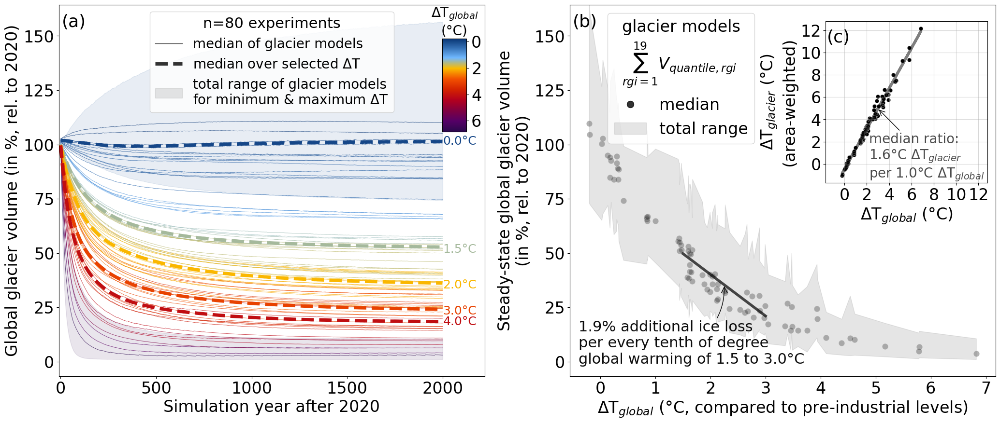

In [29]:
get_vol_timeseries_temp_ch_Xyr_glob_glacier_portrait(region='global', perc=100, sim_year=2000, 
                                                     avg_over = '3yr', # it almost makes no difference fo rthe steady state, but is better for year 0 ...
                                                     smooth_values_percentiles=1,
                                                    exp_decay_temp_fit=False, temp_above_0_8=False,
                                                     shift_years=True,
                                                     landscape = True, show_slope_fit=True)

0.0 2 0.03251493262155865
98.195015
1.5 9 1.4907660648332721
50.02768
2.0 12 2.023811190683504
34.053043
3.0 5 2.958790852856292
22.592299
4.0 3 3.990784131287062
17.661043
ratio: 1.556239566823769 slope: 1.8074004442716765


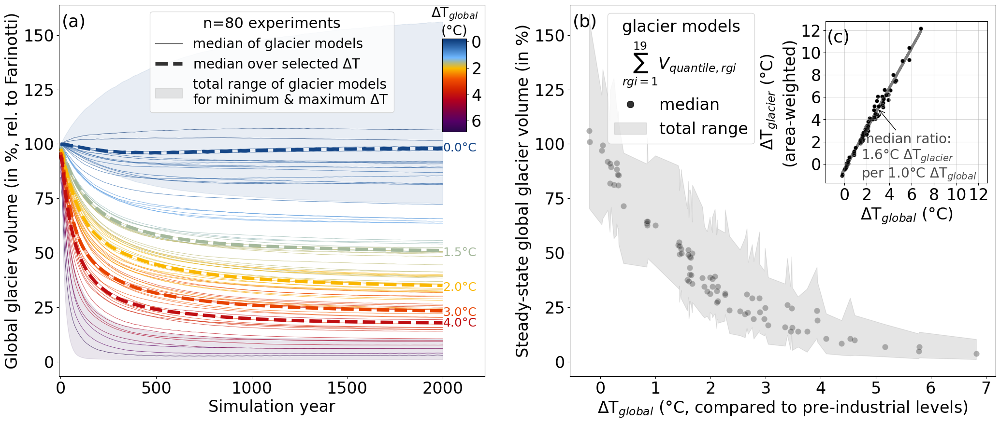

In [78]:
get_vol_timeseries_temp_ch_Xyr_glob_glacier_portrait(region='global', perc=100, sim_year=2000, avg_over = '21yr', smooth_values_percentiles=1,
                                                        exp_decay_temp_fit=False, temp_above_0_8=False, landscape = True)

['PyGEM-OGGM_v13' 'GloGEMflow' 'GloGEMflow3D' 'OGGM_v16' 'GLIMB'
 'Kraaijenbrink']
0.0 2 0.03251493262155865
175.7615390654793
1.5 9 1.4907660648332721
67.34217104535922
2.0 12 2.023811190683504
40.10343312293261
3.0 5 2.958790852856292
19.916908514983714
4.0 3 3.990784131287062
7.338957530581897
ratio: 1.269584999484988 slope: 1.3711520181058807


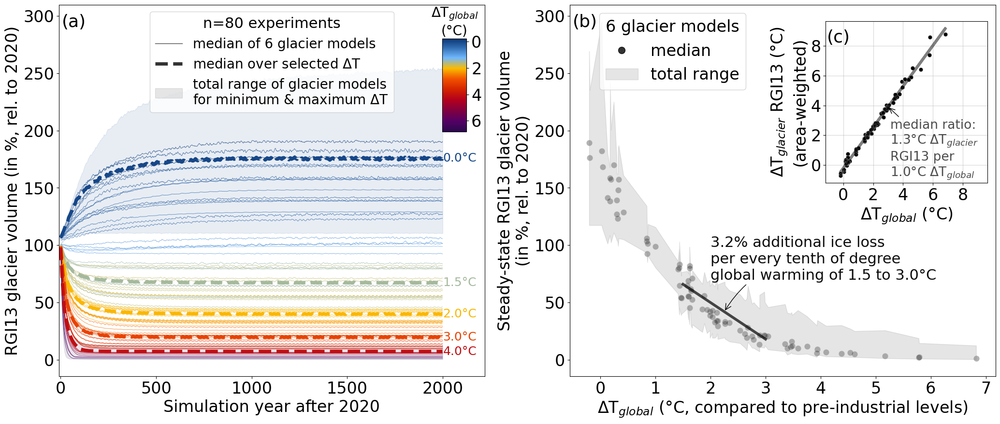

In [85]:
get_vol_timeseries_temp_ch_Xyr_glob_glacier_portrait(region='RGI13_glacier', perc=100, sim_year=2000, 
                                                     avg_over = '3yr', # it almost makes no difference fo rthe steady state, but is better for year 0 ...
                                                     smooth_values_percentiles=1,
                                                    exp_decay_temp_fit=False, temp_above_0_8=False,
                                                     shift_years=True,
                                                     landscape = True, show_slope_fit=True)

['PyGEM-OGGM_v13' 'GloGEMflow' 'OGGM_v16' 'GLIMB']
0.0 2 0.03251493262155865
92.10076714576826
1.5 9 1.4907660648332721
59.87999314509299
2.0 12 2.023811190683504
42.34283026630579
3.0 5 2.958790852856292
30.234937854187898
4.0 3 3.990784131287062
30.79564267557933
ratio: 1.2939134201449431 slope: 1.5021653840158573
['PyGEM-OGGM_v13' 'GloGEMflow' 'GloGEMflow3D' 'OGGM_v16' 'GLIMB']
0.0 2 0.03251493262155865
139.19271383155817
1.5 9 1.4907660648332721
20.610367222932627
2.0 12 2.023811190683504
6.96607573237915
3.0 5 2.958790852856292
1.7907422216486464
4.0 3 3.990784131287062
0.7670845851509528
ratio: 1.2458249675119502 slope: 1.392470540557844
['PyGEM-OGGM_v13' 'GloGEMflow' 'OGGM_v16' 'GLIMB']
0.0 2 0.03251493262155865
106.35805407651586
1.5 9 1.4907660648332721
68.80856804412971
2.0 12 2.023811190683504
53.39105843357979
3.0 5 2.958790852856292
33.62031069948966
4.0 3 3.990784131287062
31.82949100627017
ratio: 2.0080155926331553 slope: 2.4355056496619083
['PyGEM-OGGM_v13' 'GloGEMflow'

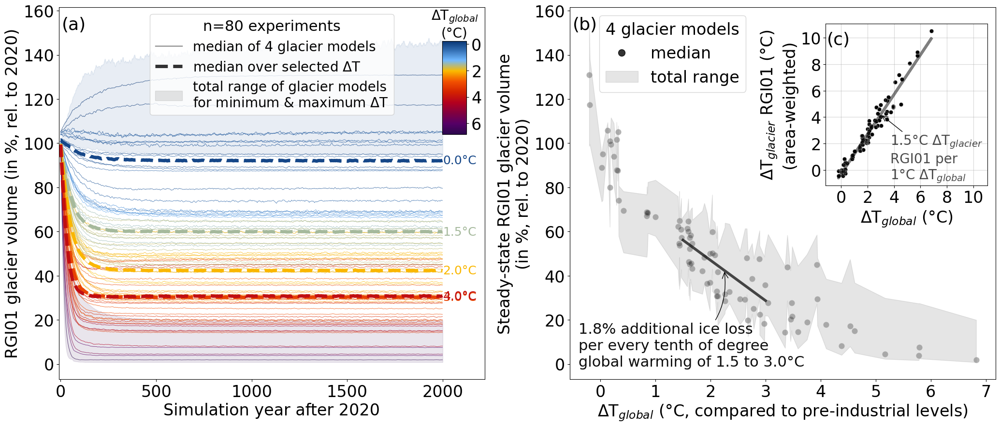

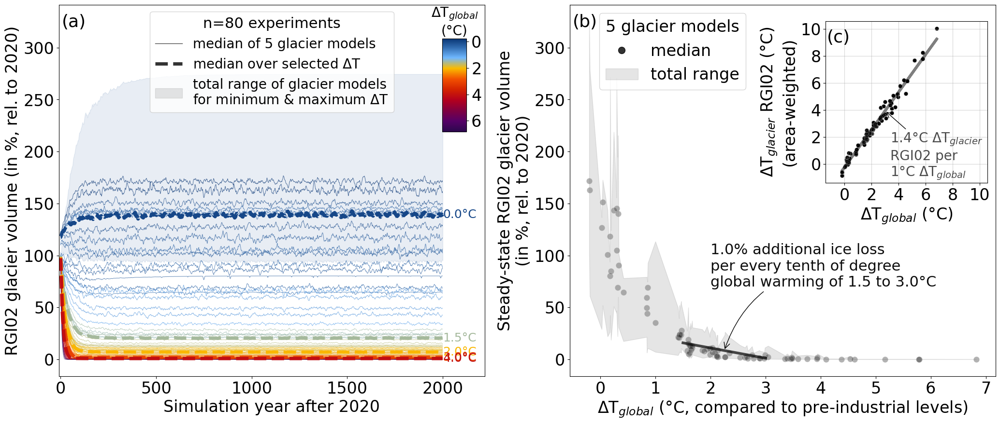

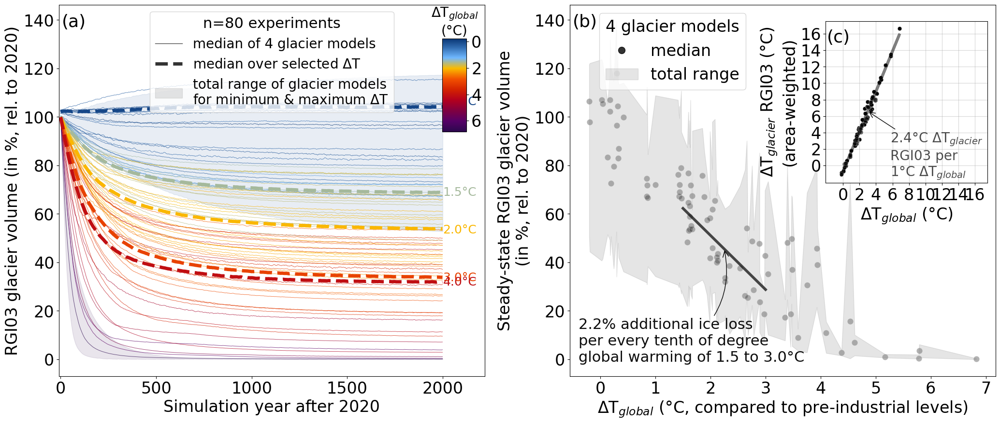

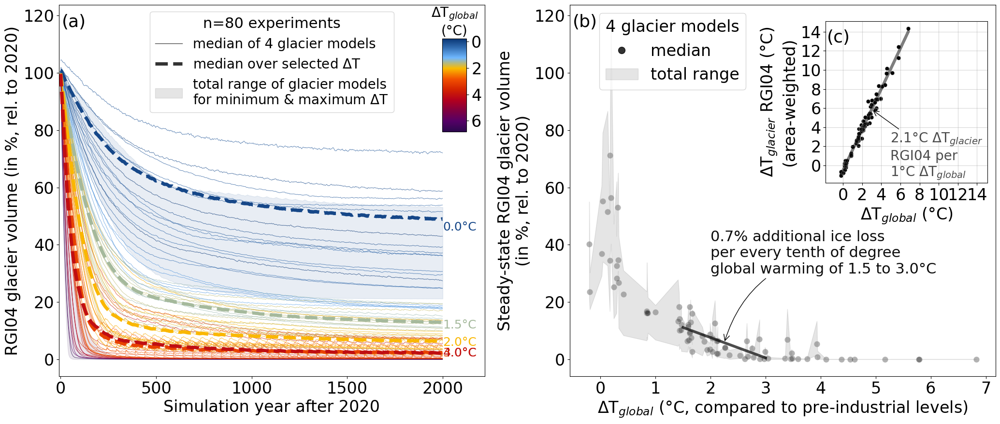

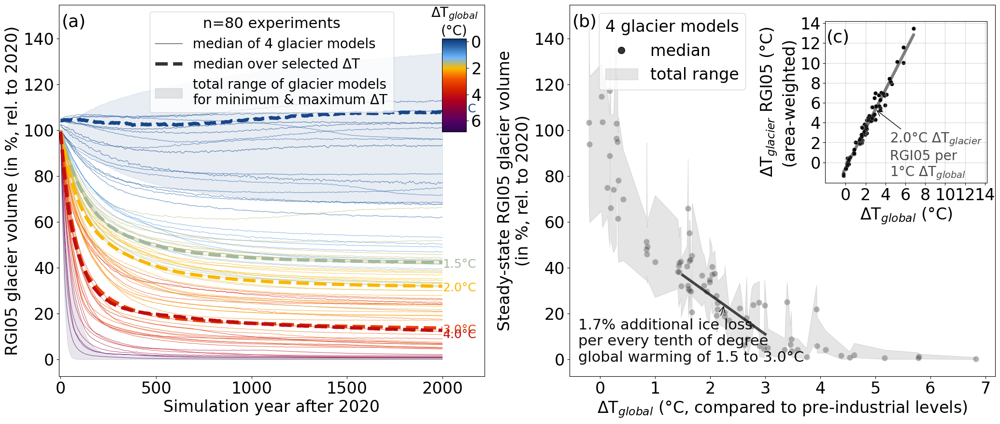

...

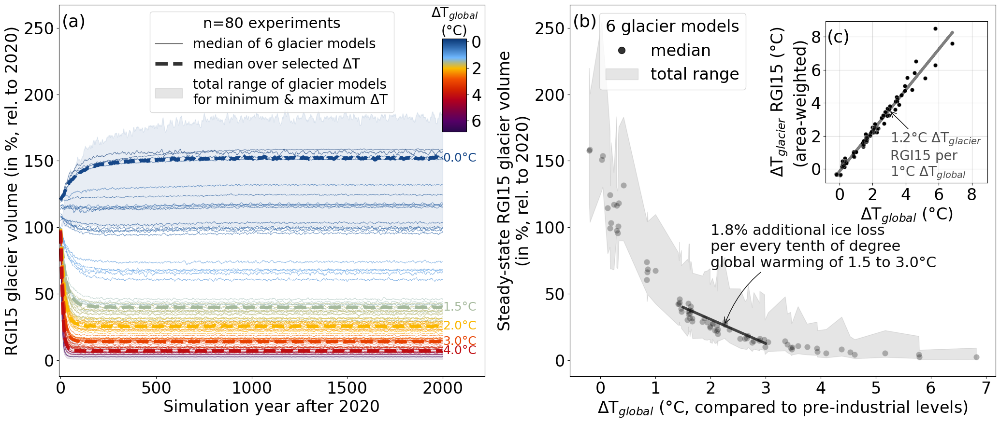

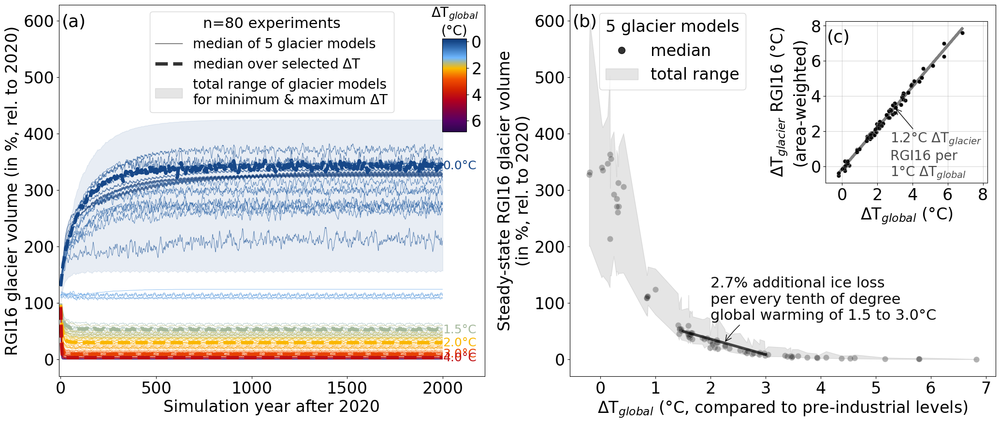

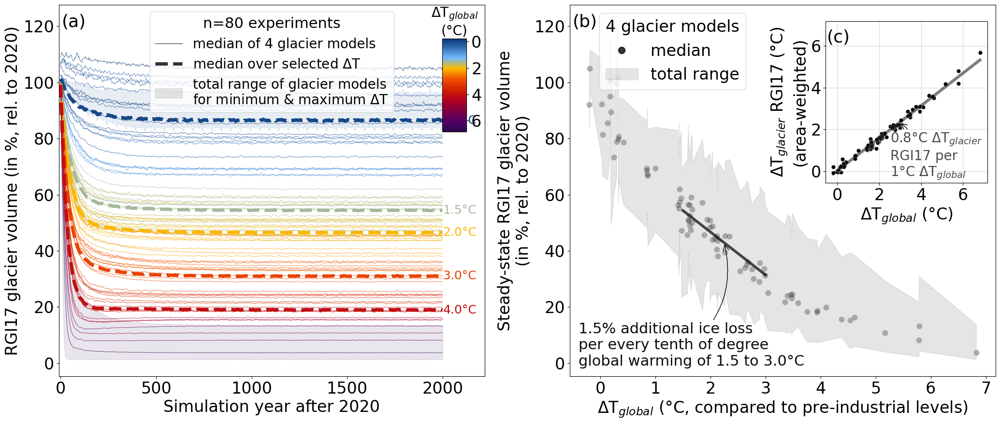

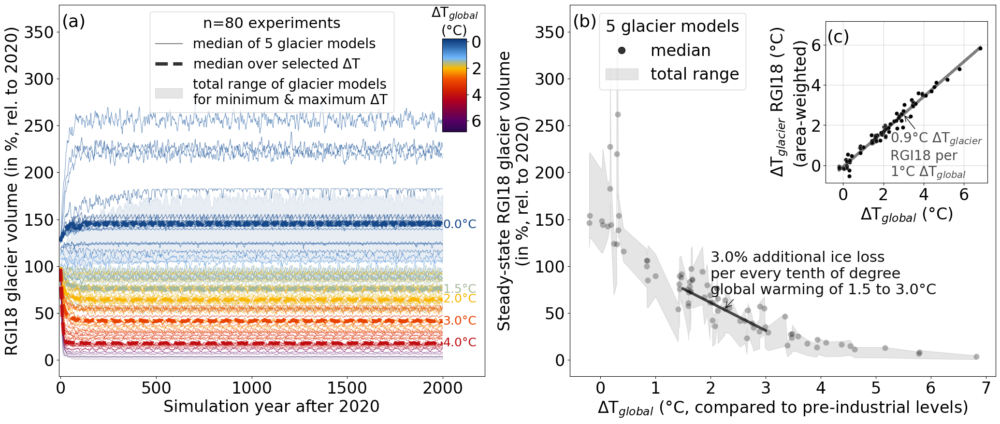

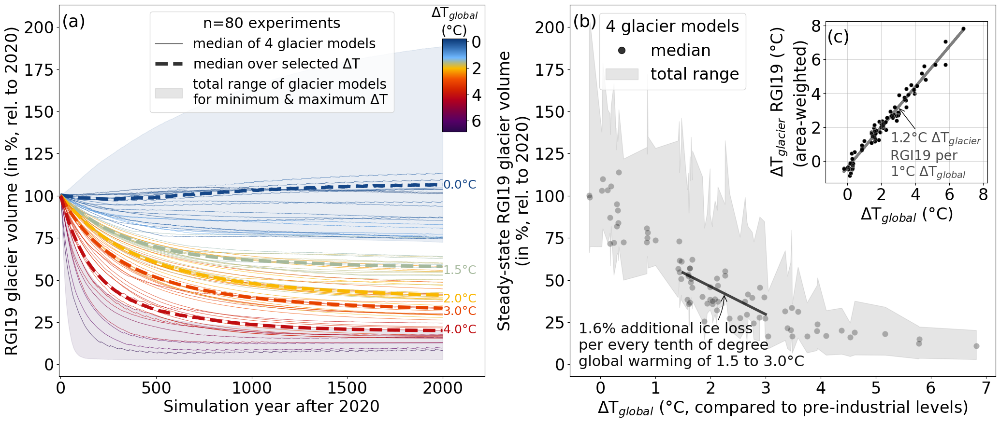

In [57]:
rgi_regs = []
for rgi_reg in np.arange(1,20,1):
    if rgi_reg < 10:
        rgi_reg = '0'+str(rgi_reg)
    else:
        rgi_reg = str(rgi_reg)
    rgi_regs.append(rgi_reg)
    
for rgi_reg in rgi_regs:
    for exp_decay_temp_fit in [False]:
        #get_vol_timeseries_temp_ch_Xyr_glob_glacier(region=f'RGI{rgi_reg}_glacier', perc=90)
        get_vol_timeseries_temp_ch_Xyr_glob_glacier_portrait(region=f'RGI{rgi_reg}_glacier',perc=100, sim_year=2000, 
                                                     avg_over = '3yr', # it almost makes no difference fo rthe steady state, but is better for year 0 ...
                                                     smooth_values_percentiles=1,
                                                    exp_decay_temp_fit=False, temp_above_0_8=False,
                                                     shift_years=True,
                                                     landscape = True, show_slope_fit=True)
        #if rgi_reg!='11':
        #    plt.close()

#### Regional vs glacier-area warming 

global_glacier median ratio: 1.6     median_ratio_15_30:  1.6    fitted slope: 1.8
RGI01_glacier median ratio: 1.3     median_ratio_15_30:  1.3    fitted slope: 1.5
RGI02_glacier median ratio: 1.2     median_ratio_15_30:  1.2    fitted slope: 1.4
RGI03_glacier median ratio: 2.0     median_ratio_15_30:  2.0    fitted slope: 2.4
RGI04_glacier median ratio: 1.8     median_ratio_15_30:  1.9    fitted slope: 2.1
RGI05_glacier median ratio: 1.6     median_ratio_15_30:  1.7    fitted slope: 2.0
RGI06_glacier median ratio: 0.9     median_ratio_15_30:  1.0    fitted slope: 1.1
RGI07_glacier median ratio: 2.6     median_ratio_15_30:  2.8    fitted slope: 2.9
RGI08_glacier median ratio: 1.2     median_ratio_15_30:  1.2    fitted slope: 1.3
RGI09_glacier median ratio: 2.6     median_ratio_15_30:  2.7    fitted slope: 3.2
RGI10_glacier median ratio: 1.5     median_ratio_15_30:  1.5    fitted slope: 1.7
RGI11_glacier median ratio: 1.3     median_ratio_15_30:  1.3    fitted slope: 1.4
RGI12_glacier m

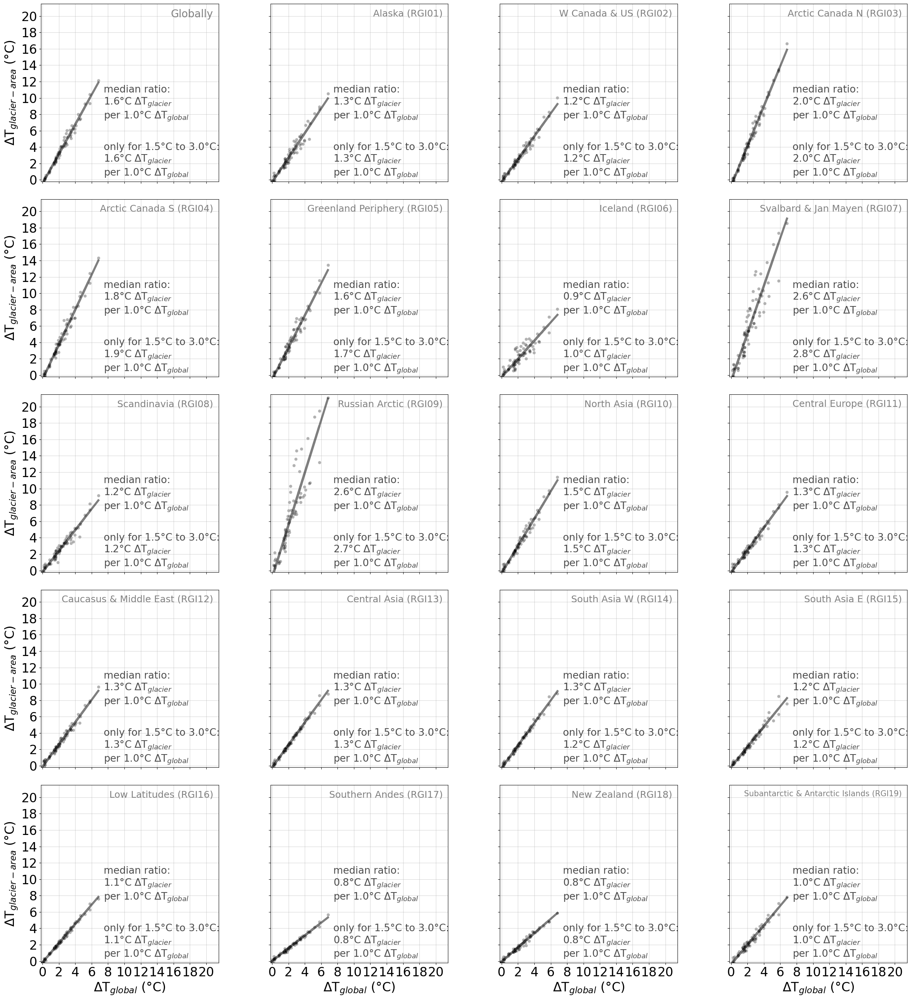

In [17]:
fig, axs = plt.subplots(5,4,figsize=(25,27), sharey=True, sharex=True) #, sharey='row') #, sharex=True)
plt.rc('font', size=20)  
for j, rgi_reg in enumerate(rgi_regs_global):
    if j<4:
        ax = axs[0][j]
    elif j <8:
        ax = axs[1][j-4]
    elif j <12:
        ax = axs[2][j-8]
    elif j <16:
        ax = axs[3][j-12]
    elif j <20:
        ax = axs[4][j-16]

        
    if rgi_reg == 'All':
        ax.text(0.97, 0.97, 'Globally', color='grey',transform=ax.transAxes, fontsize=20, va='top', ha='right')
        #ax.set_title(f'Global glacier volume after {sim_year} years')
    else:
        nam = d_reg_num_name[rgi_reg]
        if rgi_reg == '19':
            fs_rgi = 15
        else:
            fs_rgi = 18
        ax.text(0.97, 0.97, f'{nam} (RGI{rgi_reg})', color='grey',transform=ax.transAxes, fontsize=fs_rgi, va='top', ha='right')

        
    pd_global_temp_exp_m = get_glob_temp_exp(region='global')

    if rgi_reg == 'All':
        region = 'global_glacier'
    else:
        region = f'RGI{rgi_reg}_glacier'
    pd_global_temp_exp_m_glac = get_glob_temp_exp(region=region)
    pd_global_temp_exp_m.loc[pd_global_temp_exp_m_glac.index, 'temp_ch_ipcc_glacier'] = pd_global_temp_exp_m_glac['temp_ch_ipcc'].values
    pd_t = pd_global_temp_exp_m
    
    inset_ax = ax
    sns.scatterplot(data=pd_t, ax = inset_ax,
                    x='temp_ch_ipcc', y='temp_ch_ipcc_glacier',
                    color='black', alpha = 0.3,
                    #hue='temp_ch_ipcc', palette='flare',
                    legend=False)
    #inset_axes.set_title(f'Glacier area-weighted vs global\n'+r'temperature changes ($\Delta$T)'+'\ncompared to preindustrial levels')
    if j >=16:
        inset_ax.set_xlabel(r'$\Delta$T$_{global}$ (°C)')# + '\n(°C, compared to pre-industrial levels)')
    else:
        inset_ax.set_xlabel('')
    
    
    inset_ax.set_ylabel(r'$\Delta$T$_{glacier-area}$ (°C)')

    inset_ax.grid(alpha=0.5)
    # add linear fit
    slope, intercept, rval, pval, stderr = scipy.stats.linregress(pd_t['temp_ch_ipcc'].values, pd_t['temp_ch_ipcc_glacier'])
    inset_ax.plot(pd_t['temp_ch_ipcc'], slope*pd_t['temp_ch_ipcc'].values + intercept, color = 'black', alpha = 0.5, lw=4)
    ratio = np.median(pd_t['temp_ch_ipcc_glacier'].values/pd_t['temp_ch_ipcc'].values)
    pd_t_15_30 = pd_t.loc[(pd_t.temp_ch_ipcc>=1.5)&(pd_t.temp_ch_ipcc<=3.0)]
    median_ratio_15_30 = np.median(pd_t_15_30['temp_ch_ipcc_glacier'].values/pd_t_15_30['temp_ch_ipcc'].values)
    print(region, 'median ratio:', ratio.round(1), '    median_ratio_15_30: ', median_ratio_15_30.round(1), '   fitted slope:' , slope.round(1))

    #inset_ax.annotate(f'fitted slope:\n{slope:.1f}°C '+r'$\Delta$T$_{glacier}$'+'\nper 1.0°C '+r'$\Delta$T$_{global}$',
    inset_ax.annotate(f'median ratio:\n{ratio:.1f}°C '+r'$\Delta$T$_{glacier}$'+'\nper 1.0°C '+r'$\Delta$T$_{global}$',
                  xy=(7.5,7.5),
                  xytext=(7.5,7.5),
                  fontsize = 19,
                  #arrowprops=dict(arrowstyle="->", connectionstyle="arc3"), 
                      color='black', alpha=0.7)
    
    inset_ax.annotate(f'only for 1.5°C to 3.0°C:\n{median_ratio_15_30:.1f}°C '+r'$\Delta$T$_{glacier}$'+'\nper 1.0°C '+r'$\Delta$T$_{global}$',
              xy=(7.5,0.5),
              xytext=(7.5,0.5),
              fontsize = 19,
              #arrowprops=dict(arrowstyle="->", connectionstyle="arc3"), 
                  color='black', alpha=0.7)
    arrow_annotate = False
    if arrow_annotate:
        if region == 'global_glacier':
            inset_ax.annotate(f'{slope:.1f}°C '+r'$\Delta$T$_{glacier}$'+'\nper 1.0°C '+r'$\Delta$T$_{global}$',
                              xy=(3,slope*3 + intercept),
                              xytext=(4-2-0.5,slope*4 + intercept-8),
                              fontsize = 21,
                              arrowprops=dict(arrowstyle="->", connectionstyle="arc3"), color='black', alpha=0.7)
        else:
            inset_ax.annotate(f'{slope:.1f}°C '+r'$\Delta$T$_{glacier}$'+f'\nRGI{rgi_reg} per'+'\n1.0°C '+r'$\Delta$T$_{global}$',
                              xy=(3,slope*3 + intercept),
                              xytext=(0.4,0.04),    #(4-2,slope*4 + intercept-8),
                              textcoords='axes fraction', fontsize=20,
                       arrowprops=dict(arrowstyle="->", connectionstyle="arc3"), color='black', alpha=0.7)

    inset_ax.set_aspect('equal')
    ylim0,ylim1 = inset_ax.get_ylim()
    xlim0,xlim1 = inset_ax.get_xlim()
    lim0 = -0.2 #min(ylim0, xlim0)
    lim1 = 21.5 #max(ylim1, xlim1)
    inset_ax.set_xlim([lim0, lim1])
    inset_ax.set_ylim([lim0, lim1])

    inset_ax.set_xticks(np.arange(0,lim1,2))
    inset_ax.set_yticks(np.arange(0,lim1,2))
plt.tight_layout()

plt.savefig('figures/reg_vs_global_glacier_temp_change_per_rgi_region.png')

**Here directly only for the shifted stuff**

In [18]:
sim_year = 5000 #2000
max_shift_years = 50
pd_global_temp_exp_m = get_glob_temp_exp(region='global')

ds_reg_models_vol = ds_reg_yr_shift.sel(year_after_2020=slice(0,5000-max_shift_years)).volume_m3 #ds_reg_models.isel(simulation_year=slice(0,sim_year+1)).volume_m3
# Let's take the median/iqr estimate from all glacier models for every RGI region and then do the sum:
ds_reg_models_vol = ds_reg_models_vol.stack(experiments=['gcm','period_scenario'])

### regional 
ds_reg_models_vol_roll_steady_state = ds_reg_models_vol.median(dim='model_author').sel(year_after_2020=slice(sim_year-20-max_shift_years,sim_year-max_shift_years)).mean(dim='year_after_2020')
ds_reg_models_med_vol_2020 = 100*ds_reg_models_vol_roll_steady_state/pd_rgi_stats_w_hugonnet[f'regional_volume_m3_2020{approach}'].loc[ds_reg_models_vol_roll_steady_state.rgi_reg].values.reshape(19,1)

# this here takes a while
#ds_reg_models_gcm_q25_q50_q75_vol = ds_reg_models_gcm_vol.quantile([0.25,0.5,0.75], dim='model_author')
# pd_global_temp_exp_m = get_glob_temp_exp(region=f'RGI{rgi_reg}_global') # pd_global_temp_exp.groupby(['gcm','period_scenario']).mean()
ds_reg_models_med_vol_2020 = ds_reg_models_med_vol_2020.assign_coords(temp_ch_ipcc = ('experiments',
                                                                                       pd_global_temp_exp_m.loc[ds_reg_models_med_vol_2020.experiments.values, 'temp_ch_ipcc'].values))
ds_reg_models_med_vol_2020 = ds_reg_models_med_vol_2020.sortby('temp_ch_ipcc')
ds_reg_models_med_vol_2020 = ds_reg_models_med_vol_2020.reset_coords()
pd_reg_models_med_vol_2020 = ds_reg_models_med_vol_2020.to_dataframe().reset_index()
pd_reg_models_med_vol_2020['region'] = 'RGI' + pd_reg_models_med_vol_2020['rgi_reg']

### global
ds_glob_models_vol_roll_steady_state = ds_reg_models_vol.median(dim='model_author').sel(year_after_2020=slice(sim_year-20-max_shift_years,sim_year-max_shift_years)).mean(dim='year_after_2020').sum(dim='rgi_reg')

ds_glob_models_med_vol_2020 = 100*ds_glob_models_vol_roll_steady_state/pd_rgi_stats_w_hugonnet[f'regional_volume_m3_2020{approach}'].loc['Globally']
ds_glob_models_med_vol_2020 = ds_glob_models_med_vol_2020.assign_coords(temp_ch_ipcc = ('experiments',
                                                                                pd_global_temp_exp_m.loc[ds_glob_models_med_vol_2020.experiments.values, 'temp_ch_ipcc'].values))
ds_glob_models_med_vol_2020 = ds_glob_models_med_vol_2020.sortby('temp_ch_ipcc')
ds_glob_models_med_vol_2020 = ds_glob_models_med_vol_2020.reset_coords()
pd_glob_models_med_vol_2020 = ds_glob_models_med_vol_2020.to_dataframe().reset_index()
pd_glob_models_med_vol_2020['region'] = 'global'

### concatenate both
pd_all_models_med_vol_2020 = pd.concat([pd_glob_models_med_vol_2020, pd_reg_models_med_vol_2020])


ds_reg_models_med_vol = ds_reg_models_vol.median(dim='model_author')
ds_reg_models_med_vol_roll = ds_reg_models_med_vol.rolling(year_after_2020=20, center=True).mean().dropna(dim='year_after_2020', how='all')#.sel(simulation_year=slice(0,sim_year))


In [19]:
markers = ['^', 'X','s','o','D','v']

norm2 = plt.Normalize(vmin=pd_global_temp_exp_m['temp_ch_ipcc'].min(),
                     vmax=pd_global_temp_exp_m['temp_ch_ipcc'].max())
cmap2 = sns.color_palette('flare', as_cmap=True) #sns.cubehelix_palette(light=1, as_cmap=True)
sm2 = plt.cm.ScalarMappable(cmap=cmap2, norm=norm2)
sm2.set_array([])
plt.rc('font', size=18)  


In [20]:
col_temp_l = []
exp_l = []
for temp in [0,1.5,2,3,4,5]: #,5,6]:
    exp = np.abs(pd_global_temp_exp_m-temp).sort_values(by='temp_ch_ipcc').iloc[0].name
    #sm.colorbar.norm...
    col_temp = cmap2(norm2(pd_global_temp_exp_m.loc[exp]['temp_ch_ipcc']))
    col_temp_l.append(col_temp)
    exp_l.append(exp)


In [21]:
# first subplot
show_first_plot = False
if show_first_plot:
    plt.figure(figsize=(12,8))
    ax = plt.gca()
    # only important for logarithmic plot ... 
    pd_all_models_med_vol_2020.loc[pd_all_models_med_vol_2020.volume_m3<0.1, 'volume_m3'] = 0.1
    sns.scatterplot(data=pd_all_models_med_vol_2020, y='volume_m3', x='region', hue='temp_ch_ipcc',
                    palette='flare', legend=False, ax=ax)
    #leg = ax.legend(loc='upper left', bbox_to_anchor=(1,1), title = f'$\Delta$T (°C)\n(global)')
    ax.set_ylabel(f'Steady-state volume'+'\n(in % relative to initial state)')
    ax.axhline(100, ls=':', color = 'grey')
    ax.grid(axis='y')
    ax.set_xlabel('region');

    # plot specific delta T:
    col_temp_l = []
    exp_l = []
    for temp in [0,1.5,2,3,4,5]: #,5,6]:
        exp = np.abs(pd_global_temp_exp_m-temp).sort_values(by='temp_ch_ipcc').iloc[0].name
        #sm.colorbar.norm...
        col_temp = cmap(norm(pd_global_temp_exp_m.loc[exp]['temp_ch_ipcc']))
        col_temp_l.append(col_temp)
        exp_l.append(exp)

    pd_t_sel =pd_all_models_med_vol_2020.sel(experiments=exp_l).to_dataframe().reset_index()
    pd_t_sel['region']  = 'RGI' + pd_t_sel['rgi_reg']
    pd_t_sel_glob =pd_all_models_med_vol_2020.sel(experiments=exp_l).to_dataframe().reset_index()
    pd_t_sel_glob['region'] = 'global'
    pd_t_sel_all = pd.concat([pd_t_sel_glob, pd_t_sel])
    # just to make the plot possible
    pd_t_sel_all.loc[pd_t_sel_all.volume_m3 <0.1, 'volume_m3'] = 0.1
    #pd_t_sel_all.loc[pd_t_sel_all.volume_m3 <0.1]['volume_m3'] = 0.1
    #pd_t_sel['volume (km3)'] = pd_t_sel['volume_m3']/1e9
    l_sel = sns.scatterplot(ax=ax,
                 data=pd_t_sel_all,
                            markers=markers,
                            style='temp_ch_ipcc',
                            alpha = 0.8,
                 y='volume_m3', x='region', hue='temp_ch_ipcc',
                            palette=sns.color_palette(col_temp_l),
                 legend=False,size='temp_ch_ipcc', sizes=(200,200));
    #leg = ax.legend(loc='upper left', bbox_to_anchor=(1.005,0.99),
    #                title=f'$\Delta$T (°C)\n(global)',
    #                markerscale=1, handleheight=0.8)

    #for j,t in enumerate(leg.texts):
    #    # truncate label text to 4 characters
    #    if j ==1:
    #        t.set_text(np.round(float(t.get_text()),1))
    #    else:
    #        t.set_text(np.round(float(t.get_text()),0))
    # set the linewidth of each legend object
    #for legobj in leg.legendHandles:
    #    legobj.set_linewidth(4.0)
    #    legobj.set_linestyle('--')
    ax.set_xticks(pd_t_sel_all.region.unique())
    ax.set_xticklabels(pd_t_sel_all.region.unique(), rotation=45)
    #ax.set_yticks([5,10,20,40, 80, 160, 320],[5,10,20,40, 80, 160, 320])

    #x = pd_t_sel_all.volume_m3.values
    #def stratify(ax, power=2):
    #    f     = lambda x: (x + 1)**(1 / power)
    #    f_inv = lambda y: y**power - 1
    #    ax.set_yscale('function', functions=(f, f_inv))
    #stratify(ax, power=2)

    #ax.set_yscale('log', base=2)
    #ax.set_yticks([5,10,20,40, 80, 160, 320],[5,10,20,40, 80, 160, 320])
    ######## Next subplot    


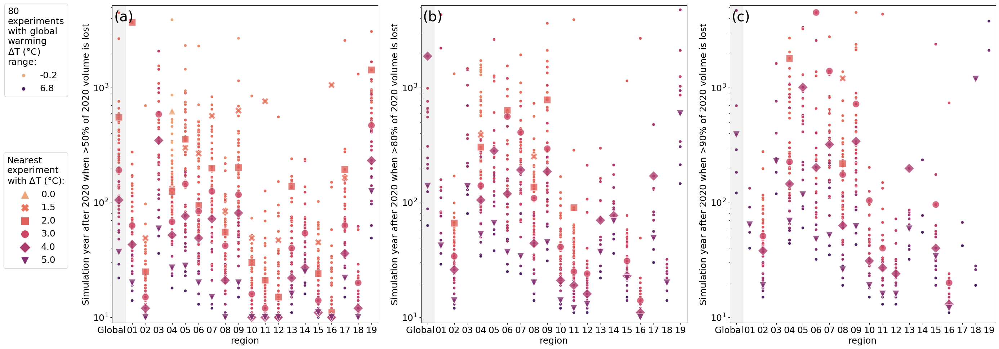

In [22]:
fig, axs= plt.subplots(1,3,figsize=(28,10),sharex=True)
axs = axs.flatten()
################### Next subplot: year where less than 50%/20% /1% remains
for ax, perc in zip(axs, [50,20,10]):
    # make sure that we use the 20-year rolling average !!!
    ds_reg_models_med_vol_glob_rel = 100*ds_reg_models_med_vol_roll.sum(dim='rgi_reg')/ds_reg_models_med_vol.sel(year_after_2020=0).sum(dim='rgi_reg')
    ds_reg_models_med_vol_glob_rel = ds_reg_models_med_vol_glob_rel.assign_coords(temp_ch_ipcc = ('experiments',
                                                                          pd_global_temp_exp_m.loc[ds_reg_models_med_vol_glob_rel.experiments, # make sure thatwe use the same experiments
                                                                                                   'temp_ch_ipcc']))

    ds_reg_below_50_perc = ds_reg_models_med_vol_glob_rel.where(ds_reg_models_med_vol_glob_rel<=perc)
    ds_reg_below_50_perc.max(dim='year_after_2020')
    yr_50_perc = ds_reg_below_50_perc.idxmax(dim='year_after_2020')

    pd_yr_50_perc = yr_50_perc.to_dataframe(f'Year when <{perc}% of initial volume remains').reset_index()
    pd_yr_50_perc['region'] = 'global' 

    for rgi_reg in ds_reg_models_med_vol_roll.rgi_reg.values:
        ds_reg_models_med_vol_sel_rel = 100*ds_reg_models_med_vol_roll.sel(rgi_reg=rgi_reg)/ds_reg_models_med_vol.sel(year_after_2020=0).sel(rgi_reg=rgi_reg)
        ds_reg_models_med_vol_sel_rel = ds_reg_models_med_vol_sel_rel.assign_coords(temp_ch_ipcc = ('experiments',
                                                                              pd_global_temp_exp_m.loc[ds_reg_models_med_vol_sel_rel.experiments, # make sure thatwe use the same experiments
                                                                                                       'temp_ch_ipcc']))

        ds_reg_below_50_perc_sel = ds_reg_models_med_vol_sel_rel.where(ds_reg_models_med_vol_sel_rel<=perc)
        ds_reg_below_50_perc_sel.max(dim='year_after_2020')
        yr_50_perc_sel = ds_reg_below_50_perc_sel.idxmax(dim='year_after_2020')

        pd_yr_50_perc_reg = yr_50_perc_sel.to_dataframe(f'Year when <{perc}% of initial volume remains').reset_index()
        pd_yr_50_perc_reg['region'] = f'RGI{rgi_reg}'
        pd_yr_50_perc = pd.concat([pd_yr_50_perc,pd_yr_50_perc_reg])

    pd_yr_50_perc=pd_yr_50_perc.drop(columns='rgi_reg')
    #pd_yr_50_perc = pd_yr_50_perc.dropna()

    if perc == 50:
        legend_opt = 'full'
    else:
        legend_opt = False
    sns.scatterplot(ax=ax,
                    hue='temp_ch_ipcc',
                    y=f'Year when <{perc}% of initial volume remains',
                    x='region',
                    palette='flare', ### this does not work .. removed it again ... sns.color_palette(col_temp_l_long[::-1], as_cmap=True), #'flare', ### TODO, maybe NOT perfect ???
                    data=pd_yr_50_perc, legend=legend_opt)
    if perc == 50:
        handles, labels = ax.get_legend_handles_labels()
        leg2 = ax.legend()
        leg2.remove()
    # plot specific delta T:
    ds_sel = pd_yr_50_perc.groupby(['gcm','period_scenario','region']).mean().to_xarray().stack(experiments=['gcm','period_scenario'])
    pd_yr_50_perc_sel = ds_sel.sel(experiments=exp_l).to_dataframe().reset_index().dropna()
    if np.all(pd_yr_50_perc_sel.temp_ch_ipcc >=1.6):
        col_temp_l_sel = col_temp_l[2:].copy()
        markers_sel = markers[2:].copy()
    elif np.all(pd_yr_50_perc_sel.temp_ch_ipcc >=0.5):
        # in no region that amount is lost when having 0°C global warming
        col_temp_l_sel = col_temp_l[1:].copy()
        markers_sel = markers[1:].copy()
    else:
        col_temp_l_sel = col_temp_l.copy()
        markers_sel = markers.copy()
        
    if perc == 50:
        legend_opt = 'auto'
    else:
        legend_opt = False
    sns.scatterplot(ax=ax,
                    hue='temp_ch_ipcc',
                    y=f'Year when <{perc}% of initial volume remains',
                    x='region',
                    data=pd_yr_50_perc_sel,
                    markers=markers_sel,
                    style='temp_ch_ipcc',
                    palette=sns.color_palette(col_temp_l_sel),
                    alpha = 0.8,
                 legend=legend_opt,size='temp_ch_ipcc', sizes=(200,200));
    if perc == 50:
        hand1, label1 = ax.get_legend_handles_labels()
        leg = ax.legend(hand1[-6:], label1[-6:], loc='upper right', bbox_to_anchor=(-0.15,0.55), #(1.005,0.55),
                        title=f'Nearest\nexperiment\nwith $\Delta$T (°C):',
                        markerscale=1, handleheight=0.8)
        ax.legend([handles[0], handles[-1]], [np.round(float(labels[0]),1), np.round(float(labels[-1]),1)], loc='upper right', bbox_to_anchor=(-0.15,1.02), #1.005,1.02),
                    title=f'80\nexperiments\nwith global\nwarming\n$\Delta$T (°C)\nrange:',
                    markerscale=1, handleheight=0.8)
        ax.add_artist(leg)
        for j,t in enumerate(leg.texts):
        #    # truncate label text to 4 characters
            if j ==1:
                t.set_text(np.round(float(t.get_text()),1))
            else:
                t.set_text(np.round(float(t.get_text()),0))
                
                
        ## get colormap 
        add_cmap = False
        if add_cmap:
            cax = fig.add_axes([ax.get_position().x1+0.01, ax.get_position().y0, 0.02, ax.get_position().height / 2.1])
            cbar = ax.figure.colorbar(sm, cax=cax)
            cbar.ax.invert_yaxis()
            cbar.set_ticks([0,1.5,3.0,4.5,6.0])
    ax.set_ylim([9,5200])
    ax.set_yscale('log')
    ax.set_xticks(pd_yr_50_perc.region.unique())
    ax.set_xticklabels(pd_yr_50_perc.region.unique(), rotation=0)
    ax.set_ylabel(f'Simulation year after 2020 when >{100-perc}% of 2020 volume is lost')
plt.tight_layout() 
num_text_x = 0.007
r_l = ['Global     ']
for r in np.arange(1,20,1):
    r_l.append(f'{r:02g}')

for j,axi in enumerate(axs):
    #if j <2:
    num_text_y = 0.95
    #else:
    #    num_text_y = 0.87
    axi.text(num_text_x, num_text_y,
             num_dict[j], fontsize=28, transform=axi.transAxes)
    axi.axvspan(-0.5,0.5,color='grey', alpha = 0.1)
    axi.set_xlim([-0.5,19.5])
    ax.set_xticks(np.arange(0,20,1),r_l)

plt.savefig(f'figures/2_w_shift_rel_2020_condensed_steady_state_year_w_perc_to_initial_state_rgi_region_analysis_{DATE}_{sim_year}yr.png')

### From hereon, we take again the correct colorscale (i.e, cmap and scaler)

In [96]:
# needs to be updated to the N500
pd_per_glac_model_fit = pd.read_csv('per_glacier_lowess_calib/fitted_per_model_lowess_best_frac_shift_years_rel_2020_101yr_avg_period_lowess_added_current12deg_5000_Feb12_2024.csv')

In [97]:
col_temp_l_sel_n = [1.2, 1.5, 2.0, 3.0]
cols_n = []
for temp in col_temp_l_sel_n: #,5,6]:
    #sm.colorbar.norm...
    #col_temp = cmap(norm(temp))
    c=cmap(scaler.transform(np.array(temp).reshape(-1,1)))
    cols_n.append(c)
markers_sel_n = markers_sel #[markers_sel[1],markers_sel[2],markers_sel[3],markers_sel[4]]
#cols_n = sns.color_palette(cols_n)



All 3.0 6.499755275914513 [19.11446242] 25.595097594797576
[13.95112272 27.16221257 21.23380662 12.87125609] [19.11446242]
All 3.0 13.087229413083078 [11.82351777] 25.976531382475226
[10.82826078 17.9442238  13.14836196 10.11333409] [11.82351777]
All 3.0 10.256319424606966 [7.78761557] 16.985051434141376
[ 8.39755687 17.36335061  7.01472734  6.28393115] [7.78761557]
01 3.0 6.43009038657234 [18.28129944] 15.570191864241533
[10.92202802 19.02849039 22.35840752 12.03860841] [18.28129944]
01 3.0 11.145344098089623 [11.38059898] 21.692424089237278
[11.2637699  11.31051224 14.87762822 10.45805217] [11.38059898]
01 3.0 10.619195717447829 [7.83999876] 14.178222373988566
[9.51289022 6.56117403 9.0211722  7.79824683] [7.83999876]
02 3.0 6.8085885938422255 [9.861801] 9.414546619460372
[23.36658475  2.38646391  2.68139883 12.48608226 10.76585209] [9.861801]
02 3.0 2.460197636831348 [3.4355451] 20.64645912622312
[14.07214951  0.71482162  0.43813269  3.7773682   6.34877947] [3.4355451]
02 3.0 0.5073

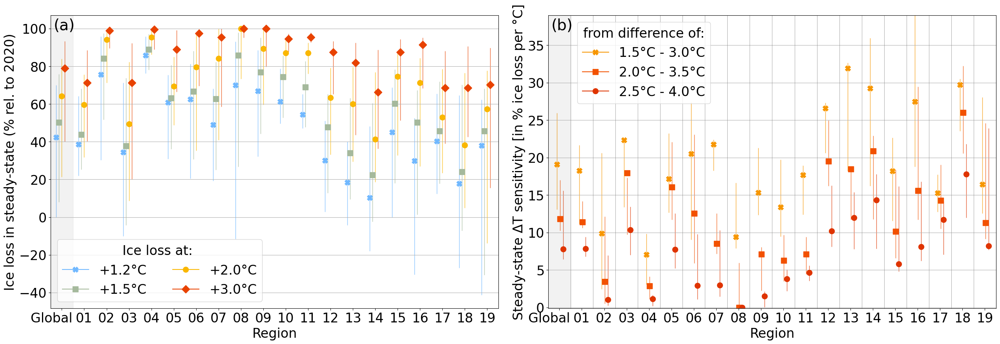

In [99]:
show_temp_sensitivity_uncertainties = True
pd_fit_quantiles_reg_sum_global = pd_sel_global_sum_over_reg_fitted_quantiles.copy().reset_index()
pd_fit_quantiles = pd_lowess_fit.copy()
pd_fit_quantiles['x'] = pd_fit_quantiles.index

r_l = ['Global     ']
for r in np.arange(1,20,1):
    r_l.append(f'{r:02g}')

fig, axs = plt.subplots(1,2, figsize=(26,9))
axs = axs.flatten()

ax = axs[0]
#r_l = []
for j,rgi_reg in enumerate(pd_fit_quantiles.region.unique()):
    if rgi_reg == 'All':
        pd_fit_quantiles_r= pd_fit_quantiles_reg_sum_global #.loc[pd_fit_quantiles_reg_sum_global.region==rgi_reg]
        # here the median is from the fit over the median global estimates (and not the sum over the regional fits)
        pd_fit_quantiles_r_med =  pd_fit_quantiles.loc[pd_fit_quantiles.region==rgi_reg]
    else:
        pd_fit_quantiles_r= pd_fit_quantiles.loc[pd_fit_quantiles.region==rgi_reg]
        pd_fit_quantiles_r_med= pd_fit_quantiles_r.copy()

    for jj,temp in enumerate(col_temp_l_sel_n):
        pd_fit_quantiles_r_sel = pd_fit_quantiles_r.loc[pd_fit_quantiles_r.x.round(2)==temp]
        pd_fit_quantiles_r_sel_med = pd_fit_quantiles_r_med.loc[pd_fit_quantiles_r_med.x.round(2)==temp]
        
        color = cmap(scaler.transform(np.array(temp).reshape(-1,1))).squeeze()

        ax.vlines([j-0.25+jj*0.125],100-pd_fit_quantiles_r_sel['0.05'], 100-pd_fit_quantiles_r_sel['0.95'], 
                  color = color, zorder=-1, alpha=0.8, lw=1)
        ax.plot([j-0.25+jj*0.125],100-pd_fit_quantiles_r_sel_med['0.5'], #'o',
                 color = color, ms=10, label = f'+{temp}°C',
                marker=markers_sel_n[jj])
        
    #r_l.append(rgi_reg)
    
    if j == 0:
        handlesa, labelsa = ax.get_legend_handles_labels() #handlesa, labelsa = ax.get_legend_handles_labels()

        leg = ax.legend(handlesa, labelsa,
                        loc='lower left', title= 'Ice loss at: ', ncol=2)
ax.set_xticks(np.arange(0,20,1),r_l)
ax.grid(axis='y')
ax.set_xlabel('Region')

ax.axvspan(-0.5,0.5,color='grey', alpha = 0.1)
ax.set_xlim([-0.5,19.5])

ax.set_ylabel('Ice loss in steady-state (% rel. to 2020)')

ax = axs[1]
#r_l = []
for j,rgi_reg in enumerate(pd_fit_quantiles.region.unique()):
    #if rgi_reg == 'All':
    #    
    #else:
    pd_fit_quantiles_r= pd_fit_quantiles.loc[pd_fit_quantiles.region==rgi_reg]
    temp0a = 1.5
    temp0b = 2.0
    temp0c = 2.5
    for jj,_temp in enumerate([temp0a,temp0b,temp0c]):
        color = cmap(scaler.transform(np.array(_temp+1.5/2).reshape(-1,1))).squeeze()
        pd_fit_quantiles_r_sel1 = pd_fit_quantiles_r.loc[pd_fit_quantiles_r.x.round(2)==_temp]
        pd_fit_quantiles_r_sel2 = pd_fit_quantiles_r.loc[pd_fit_quantiles_r.x.round(2)==_temp+1.5]

        #_l = (pd_fit_quantiles_r_sel1['0.05'].values-pd_fit_quantiles_r_sel2['0.05'].values)/1.5
        #_u = (pd_fit_quantiles_r_sel1['0.95'].values-pd_fit_quantiles_r_sel2['0.95'].values)/1.5
        _m = (pd_fit_quantiles_r_sel1['0.5'].values-pd_fit_quantiles_r_sel2['0.5'].values)/1.5
        print(rgi_reg, temp, _l,_m, _u)
        if show_temp_sensitivity_uncertainties: 
            #ax.vlines([j-0.2+jj*0.2],_l,
            #          _u, 
            #          color = color, zorder=-1, alpha=0.8, lw=1)
            #if rgi_reg == '19':
            pd_per_glac_model_fit_reg = pd_per_glac_model_fit.loc[pd_per_glac_model_fit.region == rgi_reg]
            pd_3_0 = pd_per_glac_model_fit_reg.loc[pd_per_glac_model_fit_reg.x.round(3)==_temp+1.5]
            pd_3_0 = pd_3_0.set_index('model_author')
            pd_1_5 = pd_per_glac_model_fit_reg.loc[pd_per_glac_model_fit_reg.x.round(3)==_temp]
            pd_1_5 = pd_1_5.set_index('model_author')
            _vals = ((pd_1_5['0.5'] - pd_3_0['0.5'])/1.5).values # % volume changes per 1°C change
            # append median from overall fit as well, and compute out of that a distribution to get the 0.05/0.95 %-iles
            _l,_u = pd.Series(np.concatenate([_vals,_m])).quantile([0.05,0.95]).values
            print(_vals, _m)
            ax.vlines([j-0.12+jj*0.14],_l,
                      _u, 
                      color = color,
                      zorder=-1, alpha=0.8, lw=1)
            #ax = plt.gca()
            # show single values
            #ax.plot(4*[j-0.12+jj*0.12],_vals, 
            #         color = color, ms=3, ls ='',label = f'+{temp}°C',
            #        marker=markers_sel_n[jj])
        ax.plot([j-0.12+jj*0.14],_m, 
                 color = color, ms=10, label = f'+{temp}°C',
                marker=markers_sel_n[jj])
        
    #r_l.append(rgi_reg)
    ax.axvline(0.5+j, lw=0.5, color='grey')

    if j == 0:
        handlesa, labelsa = ax.get_legend_handles_labels() #handlesa, labelsa = ax.get_legend_handles_labels()
        leg = ax.legend(handlesa, [f'{temp0a}°C - {temp0a+1.5}°C',
                                f'{temp0b}°C - {temp0b+1.5}°C',
                        f'{temp0c}°C - {temp0c+1.5}°C'],
            	loc='upper left', title= 'from difference of:', ncol=1, bbox_to_anchor=(0.05,1))
        #leg = ax.legend(handlesa, labelsa,
        #                loc='lower left', title= 'Ice loss at: ', ncol=2)
        

ax.set_xticks(np.arange(0,20,1),r_l)
ax.grid(axis='y')
ax.set_xlabel('Region')

ax.axvspan(-0.5,0.5,color='grey', alpha = 0.1)
ax.set_xlim([-0.5,19.5])
ax.set_ylim([-0.1, 39])
ax.set_ylabel(r'Steady-state ΔT sensitivity [in % ice loss per °C]')

for j,axi in enumerate(axs):
    #if j <2:
    num_text_y = 0.95
    #else:
    #    num_text_y = 0.87
    axi.text(num_text_x, num_text_y,
             num_dict[j], fontsize=28, transform=axi.transAxes)

plt.tight_layout()

plt.savefig(f'figures/2_shifted_rel_2020_steady_state_temperature_sensitivity_slope_global_regions_{DATE}.png')


All 3.0 6.840040648861862 [19.11446242] 24.465171472087373
[15.15408762 27.39662575 18.12843503 13.04564394 12.36829714 17.88463348
 21.57873849 14.29650462 21.6526642   3.88844791  3.63672389 15.91702517
 15.81754666 24.0764523  18.74854203 21.76326505 13.90498397  4.23821998
 10.58972636  9.25595211  2.65991454 23.35470161 23.17618536 16.3894292
 11.78227708 13.1052801  29.42234602 15.42712572 25.45427576 19.25453783
 11.26803763 19.66236603 24.13265812 20.00542373 20.45254436  8.04217923
 12.62729    17.0154348  12.68473198 18.53567159 11.80340291 17.1871379
 16.07758205 18.30830293 20.2052123   9.58914762 12.80825653 22.51810057
 21.67355469  9.77392201 17.26771666 17.62240866 16.59151833 12.98159761
 15.01044426 26.93421051 26.93947544 24.51636585 21.97076036 12.84526354
 21.5817804  32.47746016 34.01308159 20.47365111 21.86916126 20.72898007
 19.76761309 34.59897631 33.46403236 15.86448049 20.6308151  15.72415609
 23.62303064 11.70381194 12.88107554 18.91602405 20.57850941  9.887

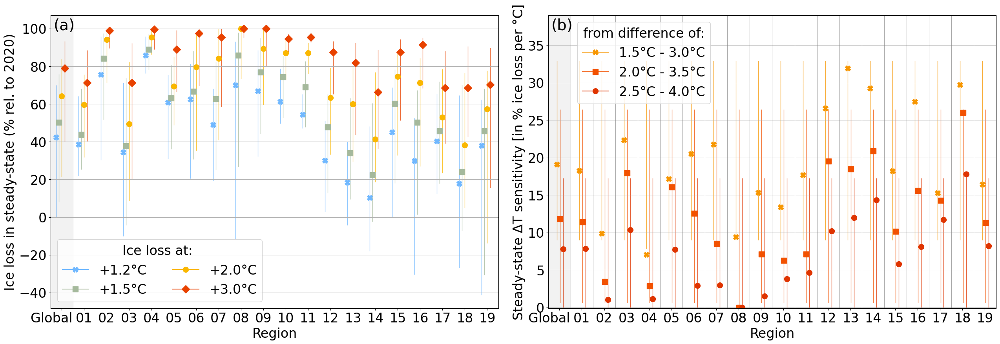

In [93]:
show_temp_sensitivity_uncertainties = True
pd_fit_quantiles_reg_sum_global = pd_sel_global_sum_over_reg_fitted_quantiles.copy().reset_index()
pd_fit_quantiles = pd_lowess_fit.copy()
pd_fit_quantiles['x'] = pd_fit_quantiles.index

r_l = ['Global     ']
for r in np.arange(1,20,1):
    r_l.append(f'{r:02g}')

fig, axs = plt.subplots(1,2, figsize=(26,9))
axs = axs.flatten()

ax = axs[0]
#r_l = []
for j,rgi_reg in enumerate(pd_fit_quantiles.region.unique()):
    if rgi_reg == 'All':
        pd_fit_quantiles_r= pd_fit_quantiles_reg_sum_global #.loc[pd_fit_quantiles_reg_sum_global.region==rgi_reg]
        # here the median is from the fit over the median global estimates (and not the sum over the regional fits)
        pd_fit_quantiles_r_med =  pd_fit_quantiles.loc[pd_fit_quantiles.region==rgi_reg]
    else:
        pd_fit_quantiles_r= pd_fit_quantiles.loc[pd_fit_quantiles.region==rgi_reg]
        pd_fit_quantiles_r_med= pd_fit_quantiles_r.copy()

    for jj,temp in enumerate(col_temp_l_sel_n):
        pd_fit_quantiles_r_sel = pd_fit_quantiles_r.loc[pd_fit_quantiles_r.x.round(2)==temp]
        pd_fit_quantiles_r_sel_med = pd_fit_quantiles_r_med.loc[pd_fit_quantiles_r_med.x.round(2)==temp]
        
        color = cmap(scaler.transform(np.array(temp).reshape(-1,1))).squeeze()

        ax.vlines([j-0.25+jj*0.125],100-pd_fit_quantiles_r_sel['0.05'], 100-pd_fit_quantiles_r_sel['0.95'], 
                  color = color, zorder=-1, alpha=0.8, lw=1)
        ax.plot([j-0.25+jj*0.125],100-pd_fit_quantiles_r_sel_med['0.5'], #'o',
                 color = color, ms=10, label = f'+{temp}°C',
                marker=markers_sel_n[jj])
        
    #r_l.append(rgi_reg)
    
    if j == 0:
        handlesa, labelsa = ax.get_legend_handles_labels() #handlesa, labelsa = ax.get_legend_handles_labels()

        leg = ax.legend(handlesa, labelsa,
                        loc='lower left', title= 'Ice loss at: ', ncol=2)
ax.set_xticks(np.arange(0,20,1),r_l)
ax.grid(axis='y')
ax.set_xlabel('Region')

ax.axvspan(-0.5,0.5,color='grey', alpha = 0.1)
ax.set_xlim([-0.5,19.5])

ax.set_ylabel('Ice loss in steady-state (% rel. to 2020)')

ax = axs[1]
#r_l = []
for j,rgi_reg in enumerate(pd_fit_quantiles.region.unique()):
    #if rgi_reg == 'All':
    #    
    #else:
    pd_fit_quantiles_r= pd_fit_quantiles.loc[pd_fit_quantiles.region==rgi_reg]
    temp0a = 1.5
    temp0b = 2.0
    temp0c = 2.5
    for jj,_temp in enumerate([temp0a,temp0b,temp0c]):
        color = cmap(scaler.transform(np.array(_temp+1.5/2).reshape(-1,1))).squeeze()
        pd_fit_quantiles_r_sel1 = pd_fit_quantiles_r.loc[pd_fit_quantiles_r.x.round(2)==_temp]
        pd_fit_quantiles_r_sel2 = pd_fit_quantiles_r.loc[pd_fit_quantiles_r.x.round(2)==_temp+1.5]

        #_l = (pd_fit_quantiles_r_sel1['0.05'].values-pd_fit_quantiles_r_sel2['0.05'].values)/1.5
        #_u = (pd_fit_quantiles_r_sel1['0.95'].values-pd_fit_quantiles_r_sel2['0.95'].values)/1.5
        _m = (pd_fit_quantiles_r_sel1['0.5'].values-pd_fit_quantiles_r_sel2['0.5'].values)/1.5
        print(rgi_reg, temp, _l,_m, _u)
        if show_temp_sensitivity_uncertainties: 
            #ax.vlines([j-0.2+jj*0.2],_l,
            #          _u, 
            #          color = color, zorder=-1, alpha=0.8, lw=1)
            #if rgi_reg == '19':
            pd_per_glac_model_fit_reg = pd_per_glac_model_fit.loc[pd_per_glac_model_fit.region == rgi_reg]
            pd_3_0 = pd_per_glac_model_fit_reg.loc[pd_per_glac_model_fit_reg.x.round(3)==_temp+1.5]
            pd_3_0 = pd_3_0.set_index('model_author')
            pd_1_5 = pd_per_glac_model_fit_reg.loc[pd_per_glac_model_fit_reg.x.round(3)==_temp]
            pd_1_5 = pd_1_5.set_index('model_author')
            _vals = ((pd_1_5['0.5'] - pd_3_0['0.5'])/1.5).values # % volume changes per 1°C change
            # append median from overall fit as well, and compute out of that a distribution to get the 0.05/0.95 %-iles
            _l,_u = pd.Series(np.concatenate([_vals,_m])).quantile([0.05,0.95]).values
            print(_vals, _m)
            ax.vlines([j-0.12+jj*0.14],_l,
                      _u, 
                      color = color,
                      zorder=-1, alpha=0.8, lw=1)
            #ax = plt.gca()
            # show single values
            #ax.plot(4*[j-0.12+jj*0.12],_vals, 
            #         color = color, ms=3, ls ='',label = f'+{temp}°C',
            #        marker=markers_sel_n[jj])
        ax.plot([j-0.12+jj*0.14],_m, 
                 color = color, ms=10, label = f'+{temp}°C',
                marker=markers_sel_n[jj])
        
    #r_l.append(rgi_reg)
    ax.axvline(0.5+j, lw=0.5, color='grey')

    if j == 0:
        handlesa, labelsa = ax.get_legend_handles_labels() #handlesa, labelsa = ax.get_legend_handles_labels()
        leg = ax.legend(handlesa, [f'{temp0a}°C - {temp0a+1.5}°C',
                                f'{temp0b}°C - {temp0b+1.5}°C',
                        f'{temp0c}°C - {temp0c+1.5}°C'],
            	loc='upper left', title= 'from difference of:', ncol=1, bbox_to_anchor=(0.05,1))
        #leg = ax.legend(handlesa, labelsa,
        #                loc='lower left', title= 'Ice loss at: ', ncol=2)
        

ax.set_xticks(np.arange(0,20,1),r_l)
ax.grid(axis='y')
ax.set_xlabel('Region')

ax.axvspan(-0.5,0.5,color='grey', alpha = 0.1)
ax.set_xlim([-0.5,19.5])
ax.set_ylim([-0.1, 39])
ax.set_ylabel(r'Steady-state ΔT sensitivity [in % ice loss per °C]')

for j,axi in enumerate(axs):
    #if j <2:
    num_text_y = 0.95
    #else:
    #    num_text_y = 0.87
    axi.text(num_text_x, num_text_y,
             num_dict[j], fontsize=28, transform=axi.transAxes)

plt.tight_layout()

plt.savefig(f'figures/2_shifted_rel_2020_steady_state_temperature_sensitivity_slope_global_regions_{DATE}.png')


In [202]:
old = False
if old:
    pd_lowess_ch = pd.read_csv('lowess_fit_cluster3__rel_2020_100yr__fit_to_median_lowess_added_clusters_normalised.csv', index_col=[0])
    pd_lowess_ch = pd_lowess_ch.reset_index()
    pd_lowess_ch.loc[pd_lowess_ch.region == 'Globally', 'region'] = 'Global     '
    pd_lowess_ch.index = pd_lowess_ch['region']
    fig, axs = plt.subplots(1,2, figsize=(24,9))
    axs = axs.flatten()

    ax = axs[0] #plt.gca()
    # ok, the pvalues are small enough anyways ...
    #assert np.all(pd_slope_rgi_reg.pval<1e-4)
    handles_l = []
    labels_l = []
    j = 0
    for t in col_temp_l_sel_n:
        sns.scatterplot(data=pd_lowess_ch, x='region', y=f'ice_loss_{t}°C_%_rel_2020', ax = ax, color=cols_n[j],
                        marker=markers_sel_n[j],
                        sizes=(200,200), s=100,
                        #size='rval', sizes=(200,50),
                        label=f'{t}°C',


                        legend = 'full'
                       )

        handlesa, labelsa = ax.get_legend_handles_labels() #handlesa, labelsa = ax.get_legend_handles_labels()
        handles_l.append(handlesa[-1])
        labels_l.append(labelsa[-1])
        j+=1
    #ax.set_ylabel('Steady ')

    leg = ax.legend(handles_l, labels_l,
                    loc='lower left', title= 'Ice loss at: ', ncol=2)
    #ax.add_artist(cbar);
    #for j,t in enumerate(leg.texts):#
    ax.grid(axis='y')
    ax.set_xlabel('region')
    #ax.set_ylabel(r'')
    #+f'\n(from difference between {np.round(temp0,1)}°C and {np.round(temp1,1)}°C)')

    #ax.set_ylabel('Additional relative lost glacier volume\n(% per °C global warming between 1-4 °C)')
    ax.set_xticks(pd_lowess_ch.index.unique())
    #ax.set_xticklabels(pd_lowess_ch.index.unique(), rotation=45);
    ax.axvspan(-0.5,0.5,color='grey', alpha = 0.1)
    ax.set_xlim([-0.5,19.5])

    ax.set_ylabel('Ice loss in steady-state (% rel. to 2020)')

    ax = axs[1] #plt.gca()
    temp0a = 1.5
    temp1a = 3.0
    # ok, the pvalues are small enough anyways ...
    #assert np.all(pd_slope_rgi_reg.pval<1e-4)

    sns.scatterplot(data=pd_lowess_ch, x='region', y=f'ice_loss_slope_between_{np.round(temp0a,1)}_and_{np.round(temp1a,1)}_per_degC_rel_2020', ax = ax, color= cmap(scaler.transform(np.array(temp0a+(temp1a-temp0a)/2).reshape(-1,1))),
                    marker='o', sizes=(200,200), s=100,
                    #size='rval', sizes=(200,50),
                    label='t',
                    legend = 'full'
                   )

    temp0b = 2.0
    temp1b = 3.5
    handlesa, labelsa = ax.get_legend_handles_labels()

    sns.scatterplot(data=pd_lowess_ch, x='region', y=f'ice_loss_slope_between_{np.round(temp0b,1)}_and_{np.round(temp1b,1)}_per_degC_rel_2020', ax = ax, #color= 'black',
                    marker='o', sizes=(200,200), s=100,
                    color=cmap(scaler.transform(np.array(temp0b+(temp1b-temp0b)/2).reshape(-1,1))),
                    label='t',
                    #size='rval', sizes=(200,50),
                    legend = 'full'
                   )
    handlesb, labelsb = ax.get_legend_handles_labels()
    leg = ax.legend([handlesa[0], handlesb[-1]], [f'{temp0a}°C - {temp1a}°C',
                                    f'{temp0b}°C - {temp1b}°C'],
                    loc='upper left', title= 'from difference between: ', ncol=4)
    #ax.add_artist(cbar);
    #for j,t in enumerate(leg.texts):#
    ax.grid(axis='y')
    ax.set_xlabel('region')
    ax.set_ylabel(r'Steady-state ΔT sensitivity [in % ice loss per °C]')
    #+f'\n(from difference between {np.round(temp0,1)}°C and {np.round(temp1,1)}°C)')

    #ax.set_ylabel('Additional relative lost glacier volume\n(% per °C global warming between 1-4 °C)')
    ax.set_xticks(pd_lowess_ch.index.unique())
    #ax.set_xticklabels(pd_lowess_ch.index.unique(), rotation=45);
    ax.axvspan(-0.5,0.5,color='grey', alpha = 0.1)
    ax.set_xlim([-0.5,19.5])

    plt.savefig('figures/2_shifted_rel_2020_steady_state_temperature_sensitivity_slope_global_regions.png')




# OLD 

### Other plots
- slope plots
- steady state under different temperature scenarios
- amount of years to lose XX% of initial state volume 

In [64]:
sim_year = 5000 #2000
pd_global_temp_exp_m = get_glob_temp_exp(region='global')

ds_reg_models_vol = ds_reg_models.isel(simulation_year=slice(0,sim_year+1)).volume_m3
# Let's take the median/iqr estimate from all glacier models for every RGI region and then do the sum:
ds_reg_models_vol = ds_reg_models_vol.stack(experiments=['gcm','period_scenario'])

### regional 
ds_reg_models_vol_roll_steady_state = ds_reg_models_vol.median(dim='model_author').sel(simulation_year=slice(sim_year-20,sim_year)).mean(dim='simulation_year')
ds_reg_models_med_vol_2000 = 100*ds_reg_models_vol_roll_steady_state/ds_reg_models_vol.median(dim='model_author').isel(simulation_year=0)
# this here takes a while
#ds_reg_models_gcm_q25_q50_q75_vol = ds_reg_models_gcm_vol.quantile([0.25,0.5,0.75], dim='model_author')
# pd_global_temp_exp_m = get_glob_temp_exp(region=f'RGI{rgi_reg}_global') # pd_global_temp_exp.groupby(['gcm','period_scenario']).mean()
ds_reg_models_med_vol_2000 = ds_reg_models_med_vol_2000.assign_coords(temp_ch_ipcc = ('experiments',
                                                                                       pd_global_temp_exp_m.loc[ds_reg_models_med_vol_2000.experiments.values, 'temp_ch_ipcc'].values))
ds_reg_models_med_vol_2000 = ds_reg_models_med_vol_2000.sortby('temp_ch_ipcc')
ds_reg_models_med_vol_2000 = ds_reg_models_med_vol_2000.reset_coords()
pd_reg_models_med_vol_2000 = ds_reg_models_med_vol_2000.to_dataframe().reset_index()
pd_reg_models_med_vol_2000['region'] = 'RGI' + pd_reg_models_med_vol_2000['rgi_reg']

### global
ds_glob_models_med_vol_2000 = 100*ds_reg_models_vol.median(dim='model_author').sel(simulation_year=slice(sim_year-20,sim_year)).mean(dim='simulation_year').sum(dim='rgi_reg')/ds_reg_models_vol.median(dim='model_author').isel(simulation_year=0).sum(dim='rgi_reg')
ds_glob_models_med_vol_2000 = ds_glob_models_med_vol_2000.assign_coords(temp_ch_ipcc = ('experiments',
                                                                                pd_global_temp_exp_m.loc[ds_glob_models_med_vol_2000.experiments.values, 'temp_ch_ipcc'].values))
ds_glob_models_med_vol_2000 = ds_glob_models_med_vol_2000.sortby('temp_ch_ipcc')
ds_glob_models_med_vol_2000 = ds_glob_models_med_vol_2000.reset_coords()
pd_glob_models_med_vol_2000 = ds_glob_models_med_vol_2000.to_dataframe().reset_index()
pd_glob_models_med_vol_2000['region'] = 'global'

### concatenate both
pd_all_models_med_vol_2000 = pd.concat([pd_glob_models_med_vol_2000, pd_reg_models_med_vol_2000])

# get the % lost per °C (here from 1.5 - 3°C)
pd_all_models_med_vol_2000_sel_1o5_3 = pd_all_models_med_vol_2000.loc[(pd_all_models_med_vol_2000.temp_ch_ipcc>=1.5) & (pd_all_models_med_vol_2000.temp_ch_ipcc<=3)]

slope_rgi_dict = {}
pd_slope_rgi_reg_1o5_3 = pd.DataFrame(index=np.arange(0,20))
intercept_l = []
slope_l = []
rval_l = []
pval_l = []
stderr_l = []
region_l = []
for region in pd_all_models_med_vol_2000_sel_1o5_3.region.unique():
    pd_sel = pd_all_models_med_vol_2000_sel_1o5_3.loc[pd_all_models_med_vol_2000_sel_1o5_3.region==region]
    slope, intercept, rval, pval, stderr = scipy.stats.linregress(pd_sel['temp_ch_ipcc'].values, pd_sel['volume_m3'])
    slope_l.append(slope)
    intercept_l.append(intercept)
    stderr_l.append(stderr)
    rval_l.append(rval)
    pval_l.append(pval)
    region_l.append(region)
pd_slope_rgi_reg_1o5_3['slope'] = slope_l
pd_slope_rgi_reg_1o5_3['intercept'] = intercept_l
pd_slope_rgi_reg_1o5_3['stderr'] = stderr_l
pd_slope_rgi_reg_1o5_3['pval'] = pval_l
pd_slope_rgi_reg_1o5_3['rval'] = rval_l
pd_slope_rgi_reg_1o5_3['region'] = region_l


####
# get the % lost per °C (here from 1 - 4 °C)
pd_all_models_med_vol_2000_sel_1_4 = pd_all_models_med_vol_2000.loc[(pd_all_models_med_vol_2000.temp_ch_ipcc>=1) & (pd_all_models_med_vol_2000.temp_ch_ipcc<=4)]
#pd_reg_models_med_vol_2000_sel_1_4 = pd_reg_models_med_vol_2000.loc[(pd_reg_models_med_vol_2000.temp_ch_ipcc>=1) & (pd_reg_models_med_vol_2000.temp_ch_ipcc<=4)]
#pd_glob_models_med_vol_2000_sel_1_4 = pd_glob_models_med_vol_2000.loc[(pd_glob_models_med_vol_2000.temp_ch_ipcc>=1) & (pd_glob_models_med_vol_2000.temp_ch_ipcc<=4)]

slope_rgi_dict = {}
pd_slope_rgi_reg = pd.DataFrame(index=np.arange(0,20))
intercept_l = []
slope_l = []
rval_l = []
pval_l = []
stderr_l = []
region_l = []
for region in pd_all_models_med_vol_2000_sel_1_4.region.unique():
    pd_sel = pd_all_models_med_vol_2000_sel_1_4.loc[pd_all_models_med_vol_2000_sel_1_4.region==region]
    slope, intercept, rval, pval, stderr = scipy.stats.linregress(pd_sel['temp_ch_ipcc'].values, pd_sel['volume_m3'])
    slope_l.append(slope)
    intercept_l.append(intercept)
    stderr_l.append(stderr)
    rval_l.append(rval)
    pval_l.append(pval)
    region_l.append(region)
pd_slope_rgi_reg['slope'] = slope_l
pd_slope_rgi_reg['intercept'] = intercept_l
pd_slope_rgi_reg['stderr'] = stderr_l
pd_slope_rgi_reg['pval'] = pval_l
pd_slope_rgi_reg['rval'] = rval_l
pd_slope_rgi_reg['region'] = region_l

# - in most cases, the temperature sensitivity is larger from 1.5 to 3°C 

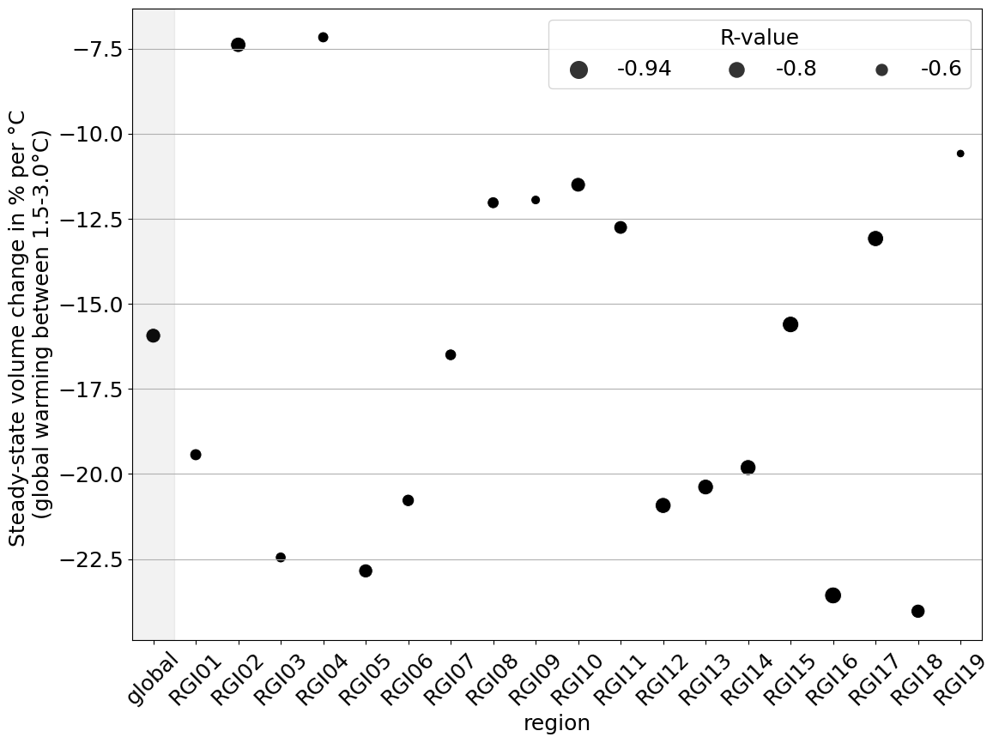

In [65]:
plt.figure(figsize=(12,9))
ax = plt.gca()
# ok, the pvalues are small enough anyways ...
assert np.all(pd_slope_rgi_reg.pval<1e-4)

sns.scatterplot(data=pd_slope_rgi_reg_1o5_3, x='region', y='slope', ax = ax, color= 'black',
                size='rval', sizes=(200,50), legend = 'full')
handles, labels = ax.get_legend_handles_labels()
leg = ax.legend(handles[::8], labels[::8],
                loc='upper right', title= 'R-value', ncol=4)
#ax.add_artist(cbar);
for j,t in enumerate(leg.texts):
    # truncate label text to 4 characters
    t.set_text(np.round(float(t.get_text()),2))
ax.grid(axis='y')
ax.set_xlabel('region')
ax.set_ylabel('Steady-state volume change in % per °C \n(global warming between 1.5-3.0°C)') #, fontsize=20)
#ax.set_ylabel('Additional relative lost glacier volume\n(% per °C global warming between 1-4 °C)')
ax.set_xticks(pd_slope_rgi_reg_1o5_3.region.unique())
ax.set_xticklabels(pd_slope_rgi_reg_1o5_3.region.unique(), rotation=45);
ax.axvspan(-0.5,0.5,color='grey', alpha = 0.1)
ax.set_xlim([-0.5,19.5])
plt.tight_layout()
plt.savefig('figures/2_steady_state_temperature_sensitivity_slope_global_regions.png')

### compare slopes depending on temperature range definition ... 
- just globally for the moment ...

/home/users/lschuster/.local/lib/python3.10/site-packages/scipy/stats/_stats_mstats_common.py:181: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/home/users/lschuster/.local/lib/python3.10/site-packages/scipy/stats/_stats_mstats_common.py:195: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/home/users/lschuster/.local/lib/python3.10/site-packages/scipy/stats/_stats_mstats_common.py:198: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


,slope,intercept,stderr,pval,rval,region,temp_range,n
0,-32.056724,93.036549,2.795703,3.965161e-09,-0.944198,global,0.0-1.0°C: n=18,18
1,-32.101875,93.290283,4.092890,2.591488e-05,-0.934009,global,0.25-1.25°C: n=11,11
2,-18.585758,81.456972,1.837048,3.247261e-06,-0.958738,global,0.5-1.5°C: n=11,11
3,-25.221981,88.079385,3.545555,6.804290e-07,-0.846600,global,0.75-1.75°C: n=22,22
4,-32.515641,99.916056,6.023938,2.774090e-05,-0.770041,global,1.0-2.0°C: n=22,22
5,-26.766535,90.933493,3.847270,1.774562e-07,-0.801204,global,1.25-2.25°C: n=29,29
6,-22.279685,82.090666,4.086987,1.331603e-05,-0.743786,global,1.5-2.5°C: n=26,26
7,-17.108353,71.540296,4.230967,8.436466e-04,-0.700190,global,1.75-2.75°C: n=19,19
8,-12.537372,61.766194,3.509614,2.177312e-03,-0.644088,global,2.0-3.0°C: n=20,20
9,-9.287552,52.252907,5.463254,1.148792e-01,-0.440557,global,2.25-3.25°C: n=14,14


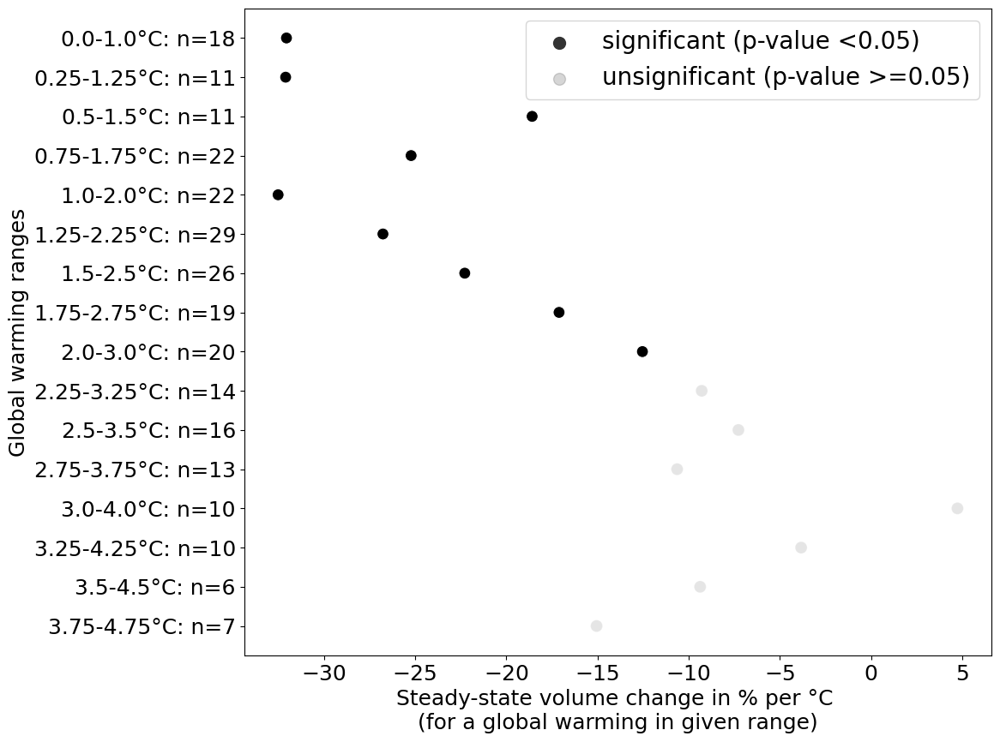

In [98]:
# get the % lost per °C (here from 1.5 - 3°C)
region = 'global'
pd_sel = pd_all_models_med_vol_2000.loc[pd_all_models_med_vol_2000.region==region]

slope_rgi_dict = {}
pd_slope_diff_ranges = pd.DataFrame(index=np.arange(0,20))
intercept_l = []
slope_l = []
rval_l = []
pval_l = []
stderr_l = []
region_l = []

r0_r1_l = []
n_l = []
for r0,r1 in zip(np.arange(0,5,0.25),np.arange(1,6,0.25)):
    pd_sel_r0_r1 = pd_sel.loc[(pd_sel.temp_ch_ipcc>=r0) & (pd_sel.temp_ch_ipcc<=r1)]
    n = len(pd_sel_r0_r1)
    slope, intercept, rval, pval, stderr = scipy.stats.linregress(pd_sel_r0_r1['temp_ch_ipcc'].values, pd_sel_r0_r1['volume_m3'])
    slope_l.append(slope)
    intercept_l.append(intercept)
    stderr_l.append(stderr)
    rval_l.append(rval)
    pval_l.append(pval)
    r0_r1_l.append(f'{r0}-{r1}°C: n={n}')
    n_l.append(n)
pd_slope_diff_ranges['slope'] = slope_l
pd_slope_diff_ranges['intercept'] = intercept_l
pd_slope_diff_ranges['stderr'] = stderr_l
pd_slope_diff_ranges['pval'] = pval_l
pd_slope_diff_ranges['rval'] = rval_l
pd_slope_diff_ranges['region'] = region
pd_slope_diff_ranges['temp_range'] = r0_r1_l
pd_slope_diff_ranges['n'] = n_l

pd_slope_diff_ranges_sel=pd_slope_diff_ranges.loc[pd_slope_diff_ranges.n>=6]
plt.figure(figsize=(12,9))
sns.scatterplot(data=pd_slope_diff_ranges_sel, y='temp_range', x='slope',color= 'grey', alpha = 0.2, sizes=(100,100),size='rval', legend=False)
       #         size='rval', sizes=(200,20)) #, legend = 'full')

sns.scatterplot(data=pd_slope_diff_ranges_sel.loc[pd_slope_diff_ranges_sel.pval<0.05], y='temp_range',sizes=(100,100),size='rval',
                x='slope',color= 'black',legend=True,
                )
                #size='pval',
                #sizes=(200,50)) 
ax = plt.gca()
handles, labels =  ax.get_legend_handles_labels()
handles[0].set_alpha(0.2)
plt.legend([handles[1], handles[0]], ['significant (p-value <0.05)', 'unsignificant (p-value >=0.05)'], fontsize=20)
ax = plt.gca()
ax.set_xlabel('Steady-state volume change in % per °C \n(for a global warming in given range)') #, fontsize=20)

ax.set_ylabel('Global warming ranges')
plt.tight_layout()
plt.savefig(f'figures/2_additional_global_glacier_loss_vs_temp_change_slopes_{DATE}_{sim_year}yr.png')
# as it gets warmer, there is no "significant" slope (as already most glacier ice is gone)
# the more we commit, the less additional lost glacier volume per °C  (less negative slopes)...
pd_slope_diff_ranges_sel

### Steady-state and year until XX% of initial state volume lost

In [72]:
rgi_regs = []
for rgi_reg in np.arange(1,20,1):
    if rgi_reg < 10:
        rgi_reg = '0'+str(rgi_reg)
    else:
        rgi_reg = str(rgi_reg)
    rgi_regs.append(rgi_reg)

In [73]:
ds_reg_models_med_vol_roll = ds_reg_models_med_vol.rolling(simulation_year=20, center=True).mean().dropna(dim='simulation_year', how='all')#.sel(simulation_year=slice(0,sim_year))


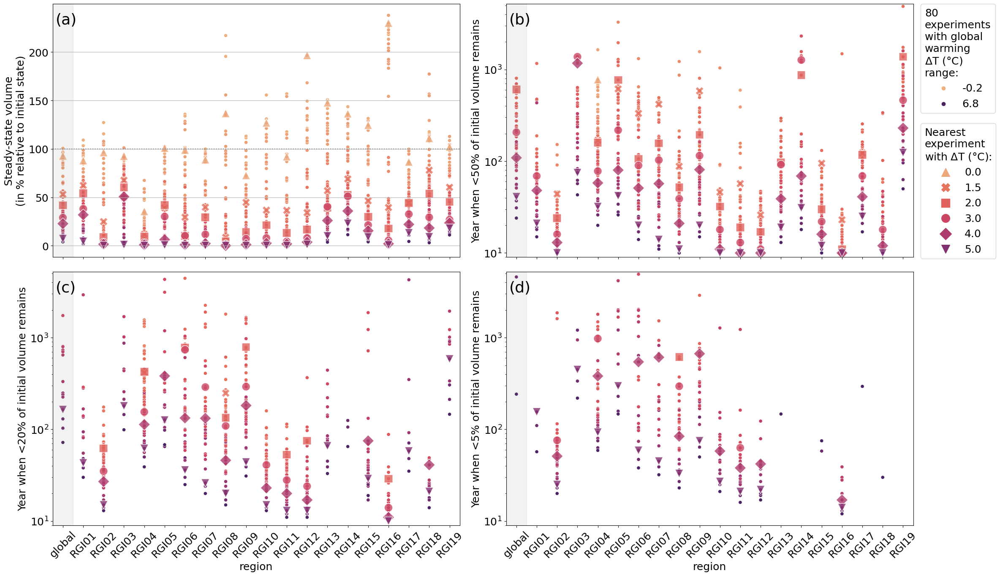

In [96]:
markers = ['^', 'X','s','o','D','v']

norm = plt.Normalize(vmin=pd_global_temp_exp_m['temp_ch_ipcc'].min(),
                     vmax=pd_global_temp_exp_m['temp_ch_ipcc'].max())
cmap = sns.color_palette('flare', as_cmap=True) #sns.cubehelix_palette(light=1, as_cmap=True)
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
plt.rc('font', size=18)  

markers = ['^', 'X','s','o','D','v']

norm = plt.Normalize(vmin=pd_global_temp_exp_m['temp_ch_ipcc'].min(),
                     vmax=pd_global_temp_exp_m['temp_ch_ipcc'].max())
cmap = sns.color_palette('flare', as_cmap=True) #sns.cubehelix_palette(light=1, as_cmap=True)
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])

fig, axs= plt.subplots(2,2,figsize=(24,14),sharex=True)

# first subplot
ax = axs[0][0] #lt.gca()
# only important for logarithmic plot ... 
pd_all_models_med_vol_2000.loc[pd_all_models_med_vol_2000.volume_m3<0.1, 'volume_m3'] = 0.1
sns.scatterplot(data=pd_all_models_med_vol_2000, y='volume_m3', x='region', hue='temp_ch_ipcc',
                palette='flare', legend=False, ax=ax)
#leg = ax.legend(loc='upper left', bbox_to_anchor=(1,1), title = f'$\Delta$T (°C)\n(global)')
ax.set_ylabel(f'Steady-state volume'+'\n(in % relative to initial state)')
ax.axhline(100, ls=':', color = 'grey')
ax.grid(axis='y')
ax.set_xlabel('region');

# plot specific delta T:
col_temp_l = []
exp_l = []
for temp in [0,1.5,2,3,4,5]: #,5,6]:
    exp = np.abs(pd_global_temp_exp_m-temp).sort_values(by='temp_ch_ipcc').iloc[0].name
    #sm.colorbar.norm...
    col_temp = cmap(norm(pd_global_temp_exp_m.loc[exp]['temp_ch_ipcc']))
    col_temp_l.append(col_temp)
    exp_l.append(exp)

pd_t_sel =ds_reg_models_med_vol_2000.sel(experiments=exp_l).to_dataframe().reset_index()
pd_t_sel['region']  = 'RGI' + pd_t_sel['rgi_reg']
pd_t_sel_glob =ds_glob_models_med_vol_2000.sel(experiments=exp_l).to_dataframe().reset_index()
pd_t_sel_glob['region'] = 'global'
pd_t_sel_all = pd.concat([pd_t_sel_glob, pd_t_sel])
# just to make the plot possible
pd_t_sel_all.loc[pd_t_sel_all.volume_m3 <0.1, 'volume_m3'] = 0.1
#pd_t_sel_all.loc[pd_t_sel_all.volume_m3 <0.1]['volume_m3'] = 0.1
#pd_t_sel['volume (km3)'] = pd_t_sel['volume_m3']/1e9
l_sel = sns.scatterplot(ax=ax,
             data=pd_t_sel_all,
                        markers=markers,
                        style='temp_ch_ipcc',
                        alpha = 0.8,
             y='volume_m3', x='region', hue='temp_ch_ipcc',
                        palette=sns.color_palette(col_temp_l),
             legend=False,size='temp_ch_ipcc', sizes=(200,200));
#leg = ax.legend(loc='upper left', bbox_to_anchor=(1.005,0.99),
#                title=f'$\Delta$T (°C)\n(global)',
#                markerscale=1, handleheight=0.8)

#for j,t in enumerate(leg.texts):
#    # truncate label text to 4 characters
#    if j ==1:
#        t.set_text(np.round(float(t.get_text()),1))
#    else:
#        t.set_text(np.round(float(t.get_text()),0))
# set the linewidth of each legend object
#for legobj in leg.legendHandles:
#    legobj.set_linewidth(4.0)
#    legobj.set_linestyle('--')
ax.set_xticks(pd_t_sel_all.region.unique())
ax.set_xticklabels(pd_t_sel_all.region.unique(), rotation=45)
#ax.set_yticks([5,10,20,40, 80, 160, 320],[5,10,20,40, 80, 160, 320])

#x = pd_t_sel_all.volume_m3.values
#def stratify(ax, power=2):
#    f     = lambda x: (x + 1)**(1 / power)
#    f_inv = lambda y: y**power - 1
#    ax.set_yscale('function', functions=(f, f_inv))
#stratify(ax, power=2)

#ax.set_yscale('log', base=2)
#ax.set_yticks([5,10,20,40, 80, 160, 320],[5,10,20,40, 80, 160, 320])
######## Next subplot    


################### Next subplot: year where less than 50%/20% /1% remains
for ax, perc in zip([axs[0][1], axs[1][0], axs[1][1]], [50,20,5]):
    # make sure that we use the 20-year rolling average !!!
    ds_reg_models_med_vol_glob_rel = 100*ds_reg_models_med_vol_roll.sum(dim='rgi_reg')/ds_reg_models_med_vol.sel(simulation_year=0).sum(dim='rgi_reg')
    ds_reg_models_med_vol_glob_rel = ds_reg_models_med_vol_glob_rel.assign_coords(temp_ch_ipcc = ('experiments',
                                                                          pd_global_temp_exp_m.loc[ds_reg_models_med_vol_glob_rel.experiments, # make sure thatwe use the same experiments
                                                                                                   'temp_ch_ipcc']))

    ds_reg_below_50_perc = ds_reg_models_med_vol_glob_rel.where(ds_reg_models_med_vol_glob_rel<=perc)
    ds_reg_below_50_perc.max(dim='simulation_year')
    yr_50_perc = ds_reg_below_50_perc.idxmax(dim='simulation_year')

    pd_yr_50_perc = yr_50_perc.to_dataframe(f'Year when <{perc}% of initial volume remains').reset_index()
    pd_yr_50_perc['region'] = 'global' 

    for rgi_reg in rgi_regs:
        ds_reg_models_med_vol_sel_rel = 100*ds_reg_models_med_vol_roll.sel(rgi_reg=rgi_reg)/ds_reg_models_med_vol.sel(simulation_year=0).sel(rgi_reg=rgi_reg)
        ds_reg_models_med_vol_sel_rel = ds_reg_models_med_vol_sel_rel.assign_coords(temp_ch_ipcc = ('experiments',
                                                                              pd_global_temp_exp_m.loc[ds_reg_models_med_vol_sel_rel.experiments, # make sure thatwe use the same experiments
                                                                                                       'temp_ch_ipcc']))

        ds_reg_below_50_perc_sel = ds_reg_models_med_vol_sel_rel.where(ds_reg_models_med_vol_sel_rel<=perc)
        ds_reg_below_50_perc_sel.max(dim='simulation_year')
        yr_50_perc_sel = ds_reg_below_50_perc_sel.idxmax(dim='simulation_year')

        pd_yr_50_perc_reg = yr_50_perc_sel.to_dataframe(f'Year when <{perc}% of initial volume remains').reset_index()
        pd_yr_50_perc_reg['region'] = f'RGI{rgi_reg}'
        pd_yr_50_perc = pd.concat([pd_yr_50_perc,pd_yr_50_perc_reg])

    pd_yr_50_perc=pd_yr_50_perc.drop(columns='rgi_reg')
    #pd_yr_50_perc = pd_yr_50_perc.dropna()

    if perc == 50:
        legend_opt = 'full'
    else:
        legend_opt = False
    sns.scatterplot(ax=ax,
                    hue='temp_ch_ipcc',
                    y=f'Year when <{perc}% of initial volume remains',
                    x='region',
                    palette='flare',
                    data=pd_yr_50_perc, legend=legend_opt)
    if perc == 50:
        handles, labels = ax.get_legend_handles_labels()
        leg2 = ax.legend()
        leg2.remove()
    # plot specific delta T:
    ds_sel = pd_yr_50_perc.groupby(['gcm','period_scenario','region']).mean().to_xarray().stack(experiments=['gcm','period_scenario'])
    pd_yr_50_perc_sel = ds_sel.sel(experiments=exp_l).to_dataframe().reset_index().dropna()
    if np.all(pd_yr_50_perc_sel.temp_ch_ipcc >=1.6):
        col_temp_l_sel = col_temp_l[2:].copy()
        markers_sel = markers[2:].copy()
    elif np.all(pd_yr_50_perc_sel.temp_ch_ipcc >=0.5):
        # in no region that amount is lost when having 0°C global warming
        col_temp_l_sel = col_temp_l[1:].copy()
        markers_sel = markers[1:].copy()
    else:
        col_temp_l_sel = col_temp_l.copy()
        markers_sel = markers.copy()
        
    if perc == 50:
        legend_opt = 'auto'
    else:
        legend_opt = False
    sns.scatterplot(ax=ax,
                    hue='temp_ch_ipcc',
                    y=f'Year when <{perc}% of initial volume remains',
                    x='region',
                    data=pd_yr_50_perc_sel,
                    markers=markers_sel,
                    style='temp_ch_ipcc',
                    palette=sns.color_palette(col_temp_l_sel),
                    alpha = 0.8,
                 legend=legend_opt,size='temp_ch_ipcc', sizes=(200,200));
    if perc == 50:
        hand1, label1 = ax.get_legend_handles_labels()
        leg = ax.legend(hand1[-6:], label1[-6:], loc='upper left', bbox_to_anchor=(1.005,0.55),
                        title=f'Nearest\nexperiment\nwith $\Delta$T (°C):',
                        markerscale=1, handleheight=0.8)
        ax.legend([handles[0], handles[-1]], [np.round(float(labels[0]),1), np.round(float(labels[-1]),1)], loc='upper left', bbox_to_anchor=(1.005,1.02),
                    title=f'80\nexperiments\nwith global\nwarming\n$\Delta$T (°C)\nrange:',
                    markerscale=1, handleheight=0.8)
        ax.add_artist(leg)
        for j,t in enumerate(leg.texts):
        #    # truncate label text to 4 characters
            if j ==1:
                t.set_text(np.round(float(t.get_text()),1))
            else:
                t.set_text(np.round(float(t.get_text()),0))
                
                
        ## get colormap 
        add_cmap = False
        if add_cmap:
            cax = fig.add_axes([ax.get_position().x1+0.01, ax.get_position().y0, 0.02, ax.get_position().height / 2.1])
            cbar = ax.figure.colorbar(sm, cax=cax)
            cbar.ax.invert_yaxis()
            cbar.set_ticks([0,1.5,3.0,4.5,6.0])
    ax.set_ylim([9,5200])
    ax.set_yscale('log')
    ax.set_xticks(pd_yr_50_perc.region.unique())
    ax.set_xticklabels(pd_yr_50_perc.region.unique(), rotation=45)
    
plt.tight_layout() 
num_text_x = 0.007
for j,axi in enumerate([axs[0][0],axs[0][1], axs[1][0], axs[1][1]]):
    #if j <2:
    num_text_y = 0.92
    #else:
    #    num_text_y = 0.87
    axi.text(num_text_x, num_text_y,
             num_dict[j], fontsize=26, transform=axi.transAxes)
    axi.axvspan(-0.5,0.5,color='grey', alpha = 0.1)
    axi.set_xlim([-0.5,19.5])
plt.savefig(f'figures/2_condensed_steady_state_year_w_perc_to_initial_state_rgi_region_analysis_{DATE}_{sim_year}yr.png')

In [74]:
markers_sel

['X', 's', 'o', 'D', 'v']

In [73]:
pd_yr_50_perc_sel

,region,gcm,period_scenario,temp_ch_ipcc,Year when <1% of initial glacier volume remains
11,RGI02,ukesm1-0-ll,2061-2080_ssp585,5.170543,35.0
22,RGI04,gfdl-esm4,2081-2100_ssp585,3.941455,4390.0
23,RGI04,ukesm1-0-ll,2061-2080_ssp585,5.170543,156.0
29,RGI05,ukesm1-0-ll,2061-2080_ssp585,5.170543,741.0
35,RGI06,ukesm1-0-ll,2061-2080_ssp585,5.170543,75.0
41,RGI07,ukesm1-0-ll,2061-2080_ssp585,5.170543,75.0
46,RGI08,gfdl-esm4,2081-2100_ssp585,3.941455,147.0
47,RGI08,ukesm1-0-ll,2061-2080_ssp585,5.170543,48.0
53,RGI09,ukesm1-0-ll,2061-2080_ssp585,5.170543,120.0
59,RGI10,ukesm1-0-ll,2061-2080_ssp585,5.170543,68.0


### OLD???

In [165]:
def get_vol_timeseries_temp_ch_Xyr_glob_glacier_portrait(region='global', perc=90, sim_year=2000, avg_last_20yr = False, smooth_values_percentiles=1,
                                                        exp_decay_temp_fit=False, temp_above_1_1=False, landscape = False):
    

    if temp_above_1_1:
        add= '_temp_above_1_1'
        current_deltaT = 1.1
    else:
        add = ''
        current_deltaT = 0
        
    pd_exp_decay_fits_simple = pd.read_csv(f'fitted_glacier_response_to_global_temp_ch_simple_20yr_avg_period{add}.csv', index_col=0)

        
    q1=(50-perc/2)/100
    q2=(50+perc/2)/100
    
    
    plt.rc('font', size=24)  
    if landscape:
        fig,axs= plt.subplots(1,2,figsize=(26,10))
        add = add+'_landscape'

    else:
        fig,axs= plt.subplots(2,1,figsize=(12,20))

    ax = axs[0]
    # get global temp. change
    pd_global_temp_exp_m = get_glob_temp_exp(region='global')

    if region == 'global':
        # get global glacier temp.change
        pd_global_temp_exp_m_glac = get_glob_temp_exp(region='global_glacier')
        ds_reg_models_med_vol_sel = ds_reg_models_med_vol.sum(dim='rgi_reg')
        n_models = ''
        rgi_reg = 'global'
        rgi_reg_f = 'All'

    else:
        # get regional glacier temp. change
        pd_global_temp_exp_m_glac = get_glob_temp_exp(region=region)
        rgi_reg = region[3:5]
        rgi_reg_f = rgi_reg
        ds_reg_models_med_vol_sel = ds_reg_models_med_vol.sel(rgi_reg=rgi_reg)
        # check how many glacier models have at least some estimates
        reg_glac_models = ds_reg_models_vol.sel(rgi_reg=rgi_reg).dropna(dim='model_author', how='all').model_author
        print(reg_glac_models.values)
        n_models = len(reg_glac_models)
        n_models = f'{n_models} '
    if exp_decay_temp_fit:
        # only for exp_decay_temp_fit
        _,_,a,b = pd_exp_decay_fits_simple.loc[(pd_exp_decay_fits_simple.rgi_reg==rgi_reg_f)&(pd_exp_decay_fits_simple.year==5000)].values.squeeze()
        pd_global_temp_exp_m['fitted_vol_ch'] = a*np.exp(-b*(pd_global_temp_exp_m['temp_ch_ipcc']-current_deltaT))
        if temp_above_1_1:
            # don't plot above 0°C
            pd_global_temp_exp_m.loc[pd_global_temp_exp_m.temp_ch_ipcc<current_deltaT, 'fitted_vol_ch'] = np.NaN
    
    ds_reg_models_med_vol_sel = ds_reg_models_med_vol_sel.assign_coords(temp_ch_ipcc = ('experiments',
                                                                          pd_global_temp_exp_m.loc[ds_reg_models_med_vol_sel.experiments, # make sure thatwe use the same experiments pd_global_temp_exp_m_glac
                                                                                                 'temp_ch_ipcc']))
    
    ds_reg_models_med_vol_sel = ds_reg_models_med_vol_sel.assign_coords(temp_ch_ipcc_glacier = ('experiments',
                                                                          pd_global_temp_exp_m_glac.loc[ds_reg_models_med_vol_sel.experiments, # make sure thatwe use the same experiments pd_global_temp_exp_m_glac
                                                                                                 'temp_ch_ipcc']))
    # need that to have bot volume_m3 and temp_ch_ipcc as variables
    ds_reg_models_med_vol_sel = ds_reg_models_med_vol_sel.reset_coords()
    init_vol = ds_reg_models_med_vol_sel.volume_m3.isel(simulation_year=0)
    ds_reg_models_med_vol_sel['relative volume change (in %)'] = 100*ds_reg_models_med_vol_sel.volume_m3/init_vol
    #print(ds_reg_models_med_vol_sel)
    pd_t =ds_reg_models_med_vol_sel.to_dataframe().reset_index()
    #pd_t['volume (km3)'] = pd_t['volume_m3']/1e9

    g = sns.lineplot(ax=ax,
                 data=pd_t,
                 x='simulation_year',
                 y='relative volume change (in %)', #'volume (km3)',
                hue='temp_ch_ipcc', palette='flare',legend=False,lw=1, alpha = 0.7);

    ## get colormap 
    norm = plt.Normalize(vmin=pd_global_temp_exp_m['temp_ch_ipcc'].min(),
                         vmax=pd_global_temp_exp_m['temp_ch_ipcc'].max())
    cmap = sns.color_palette('flare', as_cmap=True) #sns.cubehelix_palette(light=1, as_cmap=True)
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])
    
    if landscape:
        cax = fig.add_axes([ax.get_position().x1-0.07, ax.get_position().y0+0.01, 0.02, ax.get_position().height / 2.6])
    else:
        cax = fig.add_axes([ax.get_position().x1-0.12, ax.get_position().y0+0.01, 0.02, ax.get_position().height / 2.6])
    cbar = ax.figure.colorbar(sm, cax=cax)
    cbar.ax.invert_yaxis()
    cbar.set_ticks([0,1.5,3.0,4.5,6.0])
    cbar.set_label(r'$\Delta$T (°C, global)')
    
    # plot specific delta T:
    col_temp_l = []
    exp_l = []
    for temp in [0,1.5,2,3,4,5]: #,5,6]:
        exp = np.abs(pd_global_temp_exp_m-temp).sort_values(by='temp_ch_ipcc').iloc[0].name
        col_temp = cmap(sm.colorbar.norm(pd_global_temp_exp_m.loc[exp]['temp_ch_ipcc']))
        col_temp_l.append(col_temp)
        exp_l.append(exp)
    pd_t_sel =ds_reg_models_med_vol_sel.sel(experiments=exp_l).to_dataframe().reset_index()
    #pd_t_sel['volume (km3)'] = pd_t_sel['volume_m3']/1e9
    l_sel = sns.lineplot(ax=ax,
                 data=pd_t_sel,
                 x='simulation_year',
                 y='relative volume change (in %)', #'volume (km3)',
                hue='temp_ch_ipcc', palette=sns.color_palette(col_temp_l),
                 legend='auto',lw=5, ls='--');
    ax.legend(loc='upper right', bbox_to_anchor=(1,1), markerscale=1, handleheight=0.8)
    leg = ax.get_legend()
    for j,t in enumerate(leg.texts):
        # truncate label text to 4 characters
        if j ==1:
            t.set_text(np.round(float(t.get_text()),1))
        else:
            t.set_text(np.round(float(t.get_text()),0))
    # set the linewidth of each legend object
    for legobj in leg.legendHandles:
        legobj.set_linewidth(4.0)
        legobj.set_linestyle('--')
    #g.legend(loc='upper right', bbox_to_anchor=(1.2, 1.0), ncol=1)

    exp_temp_min = ds_reg_models_med_vol_sel.temp_ch_ipcc.idxmin()
    # only compute the quantile for the experiment w. minimum / maximum temperature, then just sum up the quantiles to get from regional to global estimates
    q1_2_min = ds_reg_models_vol.sel(experiments=exp_temp_min).quantile([q1,q2], dim='model_author')/1e9
    if region == 'global':
        q1_2_min_glob = q1_2_min.sum(dim='rgi_reg')
    else:
        q1_2_min_glob = q1_2_min.sel(rgi_reg=rgi_reg)
    q1_2_min_glob = (100*q1_2_min_glob/q1_2_min_glob.isel(simulation_year=0))
    ax.fill_between(ds_reg_models_med_vol_sel.simulation_year,
             q1_2_min_glob.sel(quantile=q1), q1_2_min_glob.sel(quantile=q2), alpha = 0.2, color=l_sel.lines[0].get_color())
    #handles, labels = ax.get_legend_handles_labels()
    #t = plt.legend(handles, labels)
    #ax.add_artist(leg)

    exp_temp_max = ds_reg_models_med_vol_sel.temp_ch_ipcc.idxmax()
    # only compute the quantile for the experiment w. minimum / maximum temperature, then just sum up the quantiles to get from regional to global estimates
    q1_2_max = ds_reg_models_vol.sel(experiments=exp_temp_max).quantile([q1,q2], dim='model_author')/1e9
    if region == 'global':
        q1_2_max_glob = q1_2_max.sum(dim='rgi_reg')
    else:
        q1_2_max_glob = q1_2_max.sel(rgi_reg=rgi_reg)
    q1_2_max_glob = (100*q1_2_max_glob/q1_2_max_glob.isel(simulation_year=0))

    ax.fill_between(ds_reg_models_med_vol_sel.simulation_year,
             q1_2_max_glob.sel(quantile=q1), q1_2_max_glob.sel(quantile=q2), alpha = 0.2, color=l_sel.lines[-1].get_color());
    if region == 'global':
        ax.set_ylabel(f'Global glacier volume (in %, relative to initial state)')
    else:
        ax.set_ylabel(f'RGI{rgi_reg} glacier volume (in %, relative to initial state)')
    ax.set_xlabel('Simulation year')
    #ax.legend(loc='upper left', bbox_to_anchor=(1.01,0.98))
    #leg = ax.get_legend()
    #leg.loc('upper right')
    leg.set_title(r'$\Delta$T (°C)'+f'\n(global)')

    # add additional legend for glacier model uncertatinties and other things ... 
    #define patches and lines to add to legend
    #patch_min = mpatches.Patch(label=f'{perc}th %-ile minimum temperature',  alpha = 0.2, color=l.lines[0].get_color())
    patch_max = mpatches.Patch(label=f'{perc}th %-ile of {n_models}glacier models',  alpha = 0.2, color='grey')
    line1 = Line2D([0], [0], label=f'median of {n_models}glacier models', color='black', lw=1, alpha = 0.7)
    line2 = Line2D([0], [0], label=r'experiment nearest to $\Delta$T', color='black', lw=5, alpha = 0.8, ls = '--')
    #add handles
    handles= [line1, line2, patch_max]
    #add legend
    ax.legend(handles=handles, title='n=80 experiments', loc='upper left', bbox_to_anchor=(0.1,1))
    ax.add_artist(leg)
    
    if region == 'global':
        ax.set_title(f'Global glacier volume equilibration experiments')
    else:
        ax.set_title(f'RGI{rgi_reg} glacier volume equilibration experiments')
    if sim_year == 2000:
        ax.set_xlim(ax.get_xlim()[0], 2600)
        ax.set_xticks(np.arange(0,2100,500),np.arange(0,2100,500))
    else:
        ax.set_xlim(ax.get_xlim()[0], 6400)
        ax.set_xticks(np.arange(0,5100,1000),np.arange(0,5100,1000))
    ########################## Second subplot
    ax=axs[1]
    ax0_ylim0, ax0_ylim1 = axs[0].get_ylim()
    if region == 'global':
        ax.set_title(f'Global glacier volume after {sim_year} years')
    else:
        ax.set_title(f'RGI{rgi_reg} glacier volume after {sim_year} years')
    sns.scatterplot(ax=ax,
                    x='temp_ch_ipcc',
                 y='relative volume change (in %)', #'volume (km3)',
                    data = pd_t.loc[pd_t.simulation_year==sim_year],
                #    color='black', alpha = 0.3,
                hue='temp_ch_ipcc', palette='flare',
                    legend=False, s=80)

    ax.set_xlabel(r'$\Delta$T$_{global}$ (°C, compared to pre-industrial levels)')
    #ax.get_legend().set_title(r'$\Delta$T (°C)');

    q1_2_2000 = ds_reg_models_vol.isel(simulation_year=sim_year).quantile([q1,q2], dim='model_author')
    if region == 'global':
        q1_2_2000_glob = q1_2_2000.sum(dim='rgi_reg')
    else:
        q1_2_2000_glob = q1_2_2000.sel(rgi_reg=rgi_reg)

    q1_2_2000_glob = q1_2_2000_glob.assign_coords(temp_ch_ipcc = ('experiments',
                                                   pd_global_temp_exp_m.loc[ds_reg_models_med_vol_sel.experiments.values, 'temp_ch_ipcc'].values))
    q1_2_2000_glob = q1_2_2000_glob.reset_coords()
    # init_vol is the same
    q1_2_2000_glob['relative volume change (in %)'] = 100*q1_2_2000_glob.volume_m3/init_vol[0]

    q1_2_2000_glob = q1_2_2000_glob.sortby('temp_ch_ipcc')
    def smoothen(x, winsize=smooth_values_percentiles):
        return np.array(pd.Series(x).rolling(winsize).mean())[winsize-1:] # want to have a centered rolling mean 
    #print(pd.Series(q1_2_2000_glob['relative volume change (in %)'].sel(quantile=q1)).rolling(smooth_values_percentiles).mean())
    #r = smoothen(q1_2_2000_glob['relative volume change (in %)'].sel(quantile=q1))
    #print(   r     )
    #print(len(r))
    if exp_decay_temp_fit:
        handles= [line1]
        if region=='global':
            line1 = Line2D([0], [0], label='median', color='black', ms=10, marker='o', lw=0,alpha = 0.8)
            handles= [line1]
            ax.legend(handles=handles, title=f'{n_models}glacier models', loc = 'upper left', bbox_to_anchor=(0.1,1))
        else:
            ds_t = 100*ds_reg_models_vol.sel(rgi_reg=rgi_reg).isel(simulation_year=slice(sim_year-21,sim_year-1)).mean(dim='simulation_year').dropna(dim='model_author')/ds_reg_models_vol.sel(rgi_reg=rgi_reg).isel(simulation_year=0).dropna(dim='model_author')
            #ds_t = ds_t.to_dataset().assign_coords(temp_ch_ipcc=pd_global_temp_exp_m_glac['temp_ch_ipcc'].values)
            pd_tt = ds_t.to_dataframe()
            pd_tt = pd_tt.reset_index()
            for m in pd_tt.model_author.unique():
                pd_tt.loc[pd_tt.model_author == m, 'temp_ch_ipcc']  = pd_global_temp_exp_m['temp_ch_ipcc'].values
            
            sns.scatterplot(ax=ax,
                x='temp_ch_ipcc',
                y='volume_m3', #'volume (km3)',
                data = pd_tt,
                hue='temp_ch_ipcc', palette='flare',
                #color='black', alpha=0.3,
                            legend=False, s=80)
            line1 = Line2D([0], [0], label='all', color='black', ms=10, marker='o', lw=0,alpha = 0.8)
            handles= [line1]
            ax.legend(handles=handles, title=f'{n_models}glacier models', loc = 'upper left', bbox_to_anchor=(0.1,1))


    else:
        if smooth_values_percentiles>1:
            ax.fill_between(q1_2_2000_glob.temp_ch_ipcc[int((smooth_values_percentiles-1)/2):-int((smooth_values_percentiles-1)/2)],
                             smoothen(q1_2_2000_glob['relative volume change (in %)'].sel(quantile=q1)),
                             smoothen(q1_2_2000_glob['relative volume change (in %)'].sel(quantile=q2)),
                             #step='mid',
                             #interpolate=True,
                             alpha = 0.2, color='grey');
        else:
            ax.fill_between(q1_2_2000_glob.temp_ch_ipcc,
                            q1_2_2000_glob['relative volume change (in %)'].sel(quantile=q1),
                            q1_2_2000_glob['relative volume change (in %)'].sel(quantile=q2),
            #                #step='mid',
            #                #interpolate=True,
                             alpha = 0.2, color='grey')

        #define patches and lines to add to legend
        line1 = Line2D([0], [0], label='median', color='black', ms=10, marker='o', lw=0,alpha = 0.8)
        if smooth_values_percentiles == 1: 
            patch = mpatches.Patch(label=f'{perc}th %-ile',  alpha = 0.2, color='grey')
        else:
            patch = mpatches.Patch(label=f'{perc}th %-ile\n({smooth_values_percentiles}-yr avg.)',
                                   alpha = 0.2, color='grey')
        
        #line1 = Line2D([0], [0], label='First Manual Line', color='purple')
        #add handles
        handles= [line1,patch]
        #add legend
        ax.legend(handles=handles, title=f'{n_models}glacier models', loc = 'upper left', bbox_to_anchor=(0.1,1))
    pd_t_sel_1o5_3 = pd_t.loc[(pd_t.temp_ch_ipcc>=1.5) & (pd_t.temp_ch_ipcc<=3)]
    pd_t_sel_1o5_3 = pd_t_sel_1o5_3.loc[pd_t_sel_1o5_3.simulation_year==sim_year]
    slope, intercept, rval, pval, stderr = scipy.stats.linregress(pd_t_sel_1o5_3['temp_ch_ipcc'].values, pd_t_sel_1o5_3['relative volume change (in %)'])
    
    if exp_decay_temp_fit:
        sns.lineplot(data=pd_global_temp_exp_m, x='temp_ch_ipcc', y='fitted_vol_ch', lw=4, color='black', ax=ax)
        func_vars = r'$V_{rel}$'+'(%)='+f'{a:.1f}*exp(-{b:.2f}*ΔT)'
        if temp_above_1_1:
            func_vars= r'$V_{rel}$'+'(%)='+f'{a:.1f}*exp(-{b:.2f}*(ΔT-{current_deltaT}°C))' #\n+'+f'{c_opt:.1f}*exp(-{d_opt:.2f}*ΔT²)' #+{c_opt:.2f}'
        y_deltaT2 =  a*np.exp(-b*(2-current_deltaT))
        if rgi_reg not in ['01','04','03','05','14','17','19','13', 'global']:
            ax.annotate(f'{func_vars}', xy=(2,y_deltaT2),xytext=(2,),
                        arrowprops=dict(arrowstyle="->"), color='black', alpha=0.95)
        elif rgi_reg in ['04']:
            ax.annotate(f'{func_vars}', xy=(2,y_deltaT2),xytext=(0,30),
                        arrowprops=dict(arrowstyle="->"),  color='black', alpha=0.95)
        else:
            ax.annotate(f'{func_vars}', xy=(2,y_deltaT2),xytext=(-0.25,-4),
                        arrowprops=dict(arrowstyle="->"), color='black', alpha=0.95) #, connectionstyle="arc3, rad=0.3"),
    else:
        ax.plot(pd_t_sel_1o5_3['temp_ch_ipcc'], slope*pd_t_sel_1o5_3['temp_ch_ipcc'].values + intercept, color = 'black', alpha = 0.7, lw=4)

        if rgi_reg not in ['01','04','03','05','14','17','19', 'global']:
            ax.annotate(f'{-slope:.0f}% volume loss\nper °C additional\nglobal warming', xy=(2,slope*2 + intercept),xytext=(2,50),
                        arrowprops=dict(arrowstyle="->", connectionstyle="arc3, rad=0.3"), color='black', alpha=0.95)
        elif rgi_reg in ['04']:
            ax.annotate(f'{-slope:.0f}% volume loss\nper °C additional\nglobal warming', xy=(2,slope*2 + intercept),xytext=(2,30),
                        arrowprops=dict(arrowstyle="->", connectionstyle="arc3, rad=0.3"), color='black', alpha=0.95)
        else:
            ax.annotate(f'{-slope:.0f}% volume loss\nper °C additional\nglobal warming', xy=(2,slope*2 + intercept),xytext=(-0.25,0),
                        arrowprops=dict(arrowstyle="->", connectionstyle="arc3, rad=0.3"), color='black', alpha=0.95)
    ax.set_ylim([ax0_ylim0, ax0_ylim1])
    ################ 3rd inset subplot ##############
    #plt.tight_layout()
    inset_ax = inset_axes(ax,
                        width="38%", # width = 30% of parent_bbox
                        height="48%", # height : 1 inch
                        loc='upper right'
                           #bbox_to_anchor=(1,)
                           )
    sns.scatterplot(data=pd_t, ax = inset_ax,
                    x='temp_ch_ipcc', y='temp_ch_ipcc_glacier',
                    #color='black', alpha = 0.3,
                    hue='temp_ch_ipcc', palette='flare',
                    legend=False)
    #inset_axes.set_title(f'Glacier area-weighted vs global\n'+r'temperature changes ($\Delta$T)'+'\ncompared to preindustrial levels')
    inset_ax.set_xlabel(r'$\Delta$T$_{global}$ (°C)')# + '\n(°C, compared to pre-industrial levels)')
    if region == 'global':
        inset_ax.set_ylabel(r'$\Delta$T$_{glacier}$ (°C)'+'\n(area-weighted)')
    else:
        inset_ax.set_ylabel(r'$\Delta$T$_{glacier}$ '+f'RGI{rgi_reg} (°C)\n(area-weighted)')
    inset_ax.grid(alpha=0.5)
    # add linear fit
    slope, intercept, rval, pval, stderr = scipy.stats.linregress(pd_t['temp_ch_ipcc'].values, pd_t['temp_ch_ipcc_glacier'])
    inset_ax.plot(pd_t['temp_ch_ipcc'], slope*pd_t['temp_ch_ipcc'].values + intercept, color = 'black', alpha = 0.5, lw=4)
    if region == 'global':
        inset_ax.annotate(f'{slope:.1f}°C '+r'$\Delta$T$_{glacier}$'+'\nper 1.0°C '+r'$\Delta$T$_{global}$',
                          xy=(3,slope*3 + intercept),
                          xytext=(4-2-0.5,slope*4 + intercept-8),
                          fontsize = 21,
                          arrowprops=dict(arrowstyle="->", connectionstyle="arc3"), color='black', alpha=0.7)
    else:
        inset_ax.annotate(f'{slope:.1f}°C '+r'$\Delta$T$_{glacier}$'+f'\nRGI{rgi_reg} per'+'\n1°C '+r'$\Delta$T$_{global}$',
                          xy=(3,slope*3 + intercept),
                          xytext=(0.4,0.04),    #(4-2,slope*4 + intercept-8),
                          textcoords='axes fraction', fontsize=20,
                   arrowprops=dict(arrowstyle="->", connectionstyle="arc3"), color='black', alpha=0.7)
    
    inset_ax.set_aspect('equal')
    ylim0,ylim1 = inset_ax.get_ylim()
    xlim0,xlim1 = inset_ax.get_xlim()
    lim0 = min(ylim0, xlim0)
    lim1 = max(ylim1, xlim1)
    inset_ax.set_xlim([lim0, lim1])
    inset_ax.set_ylim([lim0, lim1])

    inset_ax.set_xticks(np.arange(0,lim1,2))
    inset_ax.set_yticks(np.arange(0,lim1,2))
    #inset_ax.add_artist(Line2D([pd_t.temp_ch_ipcc_glacier.min(), pd_t.temp_ch_ipcc_glacier.max()],
    #                           [pd_t.temp_ch_ipcc_glacier.min(), pd_t.temp_ch_ipcc_glacier.max()], color='grey'))

    # add a,b,c
    num_text_x = 0.007
    for j,axi in enumerate([axs[0],axs[1], inset_ax]):
        if j <2:
            num_text_y = 0.94
        else:
            num_text_y = 0.87
        axi.text(num_text_x, num_text_y,
                 num_dict[j], fontsize=26, transform=axi.transAxes)
        
    
    if region == 'global':
        for ax in axs:
            ax.set_ylabel('Glacier volume (in %)')
            ax.set_yticks(np.arange(0,160,25),np.arange(0,160,25))

    # plt.tight_layout()
    #plt.savefig(f'/home/www/lschuster/glacierMIP3_analysis/2_{region}_timeseries_vol_temp_ch_{perc}percentile_portrait.png', bbox_inches='tight')
    if exp_decay_temp_fit:
        plt.savefig(f'figures/2_timeseries_temp_ch_reg_glob/2_{region}_timeseries_vol_temp_ch_{perc}percentile_portrait_{sim_year}yr_exp_decay_temp_fit{add}.png', bbox_inches='tight')
        #plt.savefig(f'figures/2_timeseries_temp_ch_reg_glob/2_{region}_timeseries_vol_temp_ch_{perc}percentile_portrait_{sim_year}yr_exp_decay_temp_fit{add}.pdf', bbox_inches='tight')

    else:
        plt.savefig(f'figures/2_timeseries_temp_ch_reg_glob/2_{region}_timeseries_vol_temp_ch_{perc}percentile_portrait_{sim_year}yr_slope.png', bbox_inches='tight')
        #plt.savefig(f'figures/2_timeseries_temp_ch_reg_glob/2_{region}_timeseries_vol_temp_ch_{perc}percentile_portrait_{sim_year}yr_slope.pdf', bbox_inches='tight')



    #plt.savefig(f'figures/2_timeseries_temp_ch_reg_glob/2_{region}_timeseries_vol_temp_ch_{perc}percentile_portrait_{sim_year}yr.pdf', bbox_inches='tight')
    return (pd_t.loc[pd_t.simulation_year==sim_year], q1_2_2000_glob['relative volume change (in %)'].sel(quantile=q1), q1_2_2000_glob['relative volume change (in %)'].sel(quantile=q2))

['Rounce' 'Compagno' 'OGGM_v16' 'OGGM-VAS' 'GLIMB' 'Kraaijenbrink']


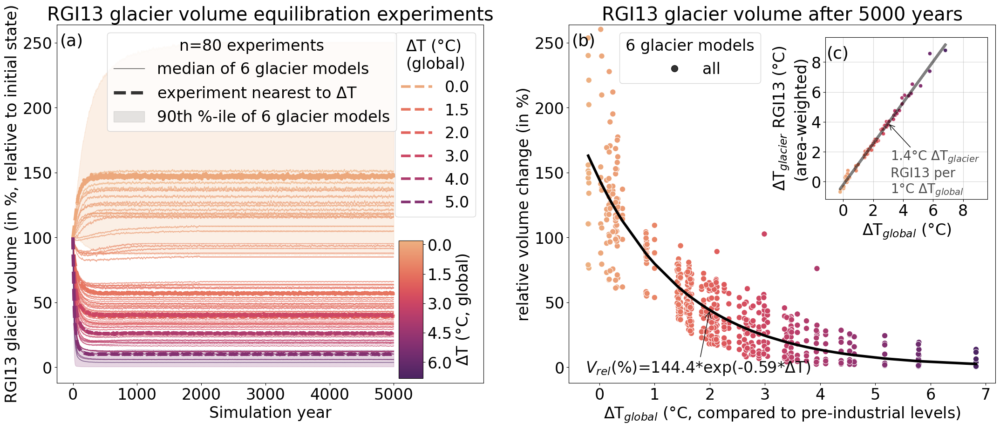

In [166]:
_ = get_vol_timeseries_temp_ch_Xyr_glob_glacier_portrait(region=f'RGI13_glacier', perc=90, sim_year=5000, exp_decay_temp_fit = True, temp_above_1_1=False, landscape=True)

['Rounce' 'Compagno' 'OGGM_v16' 'OGGM-VAS' 'GLIMB' 'Kraaijenbrink']


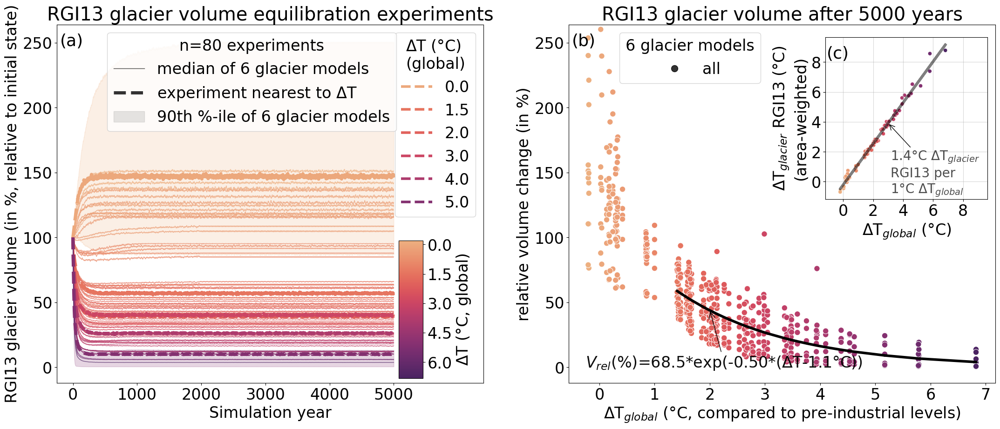

In [158]:
_ = get_vol_timeseries_temp_ch_Xyr_glob_glacier_portrait(region=f'RGI13_glacier', perc=90, sim_year=5000, exp_decay_temp_fit = True, temp_above_1_1=True, landscape=True)

- if the GMTs between 1.5 and 3°C, how much glacier volume is left per °C ? 
    - -16% of global glacier volume gets lost per degree warming in a 1.5 copmared to a 3° warmer world ...  

## Overview plot

In [28]:
markers = ['^', 'X','s','o','D','v']

norm = plt.Normalize(vmin=pd_global_temp_exp_m['temp_ch_ipcc'].min(),
                     vmax=pd_global_temp_exp_m['temp_ch_ipcc'].max())
cmap = sns.color_palette('flare', as_cmap=True) #sns.cubehelix_palette(light=1, as_cmap=True)
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
plt.rc('font', size=18)  

markers = ['^', 'X','s','o','D','v']

norm = plt.Normalize(vmin=pd_global_temp_exp_m['temp_ch_ipcc'].min(),
                     vmax=pd_global_temp_exp_m['temp_ch_ipcc'].max())
cmap = sns.color_palette('flare', as_cmap=True) #sns.cubehelix_palette(light=1, as_cmap=True)
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])

fig, axs= plt.subplots(2,2,figsize=(24,14),sharex=True)

# first subplot
ax = axs[0][0] #lt.gca()
pd_all_models_med_vol_2000.loc[pd_all_models_med_vol_2000.volume_m3<0.1, 'volume_m3'] = 0.1
sns.scatterplot(data=pd_all_models_med_vol_2000, y='volume_m3', x='region', hue='temp_ch_ipcc',
                palette='flare', legend=False, ax=ax)
#leg = ax.legend(loc='upper left', bbox_to_anchor=(1,1), title = f'$\Delta$T (°C)\n(global)')
ax.set_ylabel(f'Glacier volume after {sim_year} years'+'\n(in % relative to initial state)')
ax.axhline(100, ls=':', color = 'grey')
ax.grid(axis='y')
ax.set_xlabel('region');

# plot specific delta T:
col_temp_l = []
exp_l = []
for temp in [0,1.5,2,3,4,5]: #,5,6]:
    exp = np.abs(pd_global_temp_exp_m-temp).sort_values(by='temp_ch_ipcc').iloc[0].name
    #sm.colorbar.norm...
    col_temp = cmap(norm(pd_global_temp_exp_m.loc[exp]['temp_ch_ipcc']))
    col_temp_l.append(col_temp)
    exp_l.append(exp)

pd_t_sel =ds_reg_models_med_vol_2000.sel(experiments=exp_l).to_dataframe().reset_index()
pd_t_sel['region']  = 'RGI' + pd_t_sel['rgi_reg']
pd_t_sel_glob =ds_glob_models_med_vol_2000.sel(experiments=exp_l).to_dataframe().reset_index()
pd_t_sel_glob['region'] = 'global'
pd_t_sel_all = pd.concat([pd_t_sel_glob, pd_t_sel])
# just to make the plot possible
pd_t_sel_all.loc[pd_t_sel_all.volume_m3 <0.1, 'volume_m3'] = 0.1
#pd_t_sel_all.loc[pd_t_sel_all.volume_m3 <0.1]['volume_m3'] = 0.1
#pd_t_sel['volume (km3)'] = pd_t_sel['volume_m3']/1e9
l_sel = sns.scatterplot(ax=ax,
             data=pd_t_sel_all,
                        markers=markers,
                        style='temp_ch_ipcc',
                        alpha = 0.8,
             y='volume_m3', x='region', hue='temp_ch_ipcc',
                        palette=sns.color_palette(col_temp_l),
             legend=False,size='temp_ch_ipcc', sizes=(200,200));
#leg = ax.legend(loc='upper left', bbox_to_anchor=(1.005,0.99),
#                title=f'$\Delta$T (°C)\n(global)',
#                markerscale=1, handleheight=0.8)

#for j,t in enumerate(leg.texts):
#    # truncate label text to 4 characters
#    if j ==1:
#        t.set_text(np.round(float(t.get_text()),1))
#    else:
#        t.set_text(np.round(float(t.get_text()),0))
# set the linewidth of each legend object
#for legobj in leg.legendHandles:
#    legobj.set_linewidth(4.0)
#    legobj.set_linestyle('--')
ax.set_xticks(pd_t_sel_all.region.unique())
ax.set_xticklabels(pd_t_sel_all.region.unique(), rotation=45)
#ax.set_yticks([5,10,20,40, 80, 160, 320],[5,10,20,40, 80, 160, 320])

#x = pd_t_sel_all.volume_m3.values
#def stratify(ax, power=2):
#    f     = lambda x: (x + 1)**(1 / power)
#    f_inv = lambda y: y**power - 1
#    ax.set_yscale('function', functions=(f, f_inv))
#stratify(ax, power=2)

#ax.set_yscale('log', base=2)
#ax.set_yticks([5,10,20,40, 80, 160, 320],[5,10,20,40, 80, 160, 320])
######## Next subplot    
ax = axs[0][1]
# ok, the pvalues are small enough anyways ...
assert np.all(pd_slope_rgi_reg.pval<1e-4)

sns.scatterplot(data=pd_slope_rgi_reg_1o5_3, x='region', y='slope', ax = ax, color= 'black',
                size='rval', sizes=(200,50), legend = 'full')
handles, labels = ax.get_legend_handles_labels()
leg = ax.legend(handles[::5], labels[::5],
                loc='upper right', title= 'R-value', ncol=4)
#ax.add_artist(cbar);
for j,t in enumerate(leg.texts):
    # truncate label text to 4 characters
    t.set_text(np.round(float(t.get_text()),2))
ax.grid(axis='y')
ax.set_xlabel('region')
ax.set_ylabel('Additional relative lost glacier volume\n(% per °C global warming between 1.5-3.0°C)')
#ax.set_ylabel('Additional relative lost glacier volume\n(% per °C global warming between 1-4 °C)')
ax.set_xticks(pd_slope_rgi_reg_1o5_3.region.unique())
ax.set_xticklabels(pd_slope_rgi_reg_1o5_3.region.unique(), rotation=45)

################### Next subplot: year where less than 50%/20% left
for ax, perc in zip(axs[1][0:2], [50,20]):
    ds_reg_models_med_vol_glob_rel = 100*ds_reg_models_med_vol.sum(dim='rgi_reg')/ds_reg_models_med_vol.sel(simulation_year=0).sum(dim='rgi_reg')
    ds_reg_models_med_vol_glob_rel = ds_reg_models_med_vol_glob_rel.assign_coords(temp_ch_ipcc = ('experiments',
                                                                          pd_global_temp_exp_m.loc[ds_reg_models_med_vol_glob_rel.experiments, # make sure thatwe use the same experiments
                                                                                                   'temp_ch_ipcc']))

    ds_reg_below_50_perc = ds_reg_models_med_vol_glob_rel.where(ds_reg_models_med_vol_glob_rel<=perc)
    ds_reg_below_50_perc.max(dim='simulation_year')
    yr_50_perc = ds_reg_below_50_perc.idxmax(dim='simulation_year')

    pd_yr_50_perc = yr_50_perc.to_dataframe(f'Year when <{perc}% glacier volume left').reset_index()
    pd_yr_50_perc['region'] = 'global' 

    for rgi_reg in rgi_regs:
        ds_reg_models_med_vol_sel_rel = 100*ds_reg_models_med_vol.sel(rgi_reg=rgi_reg)/ds_reg_models_med_vol.sel(simulation_year=0).sel(rgi_reg=rgi_reg)
        ds_reg_models_med_vol_sel_rel = ds_reg_models_med_vol_sel_rel.assign_coords(temp_ch_ipcc = ('experiments',
                                                                              pd_global_temp_exp_m.loc[ds_reg_models_med_vol_sel_rel.experiments, # make sure thatwe use the same experiments
                                                                                                       'temp_ch_ipcc']))

        ds_reg_below_50_perc_sel = ds_reg_models_med_vol_sel_rel.where(ds_reg_models_med_vol_sel_rel<=perc)
        ds_reg_below_50_perc_sel.max(dim='simulation_year')
        yr_50_perc_sel = ds_reg_below_50_perc_sel.idxmax(dim='simulation_year')

        pd_yr_50_perc_reg = yr_50_perc_sel.to_dataframe(f'Year when <{perc}% glacier volume left').reset_index()
        pd_yr_50_perc_reg['region'] = f'RGI{rgi_reg}'
        pd_yr_50_perc = pd.concat([pd_yr_50_perc,pd_yr_50_perc_reg])

    pd_yr_50_perc=pd_yr_50_perc.drop(columns='rgi_reg')
    #pd_yr_50_perc = pd_yr_50_perc.dropna()

    sns.scatterplot(ax=ax,
                    hue='temp_ch_ipcc',
                    y=f'Year when <{perc}% glacier volume left',
                    x='region',
                    palette='flare',
                    data=pd_yr_50_perc, legend=False)

    # plot specific delta T:
    ds_sel = pd_yr_50_perc.groupby(['gcm','period_scenario','region']).mean().to_xarray().stack(experiments=['gcm','period_scenario'])
    pd_yr_50_perc_sel = ds_sel.sel(experiments=exp_l).to_dataframe().reset_index().dropna()
    
    if np.all(pd_yr_50_perc_sel.temp_ch_ipcc >=0.5):
        # in no region that amount is lost when having 0°C global warming
        col_temp_l_sel = col_temp_l[1:].copy()
        markers_sel = markers[1:].copy()
    else:
        col_temp_l_sel = col_temp_l.copy()
        markers_sel = markers.copy()
        
    if perc == 50:
        legend_opt = 'auto'
    else:
        legend_opt = False
    sns.scatterplot(ax=ax,
                    hue='temp_ch_ipcc',
                    y=f'Year when <{perc}% glacier volume left',
                    x='region',
                    data=pd_yr_50_perc_sel,
                    markers=markers_sel,
                    style='temp_ch_ipcc',
                    palette=sns.color_palette(col_temp_l_sel),
                    alpha = 0.8,
                 legend=legend_opt,size='temp_ch_ipcc', sizes=(200,200));
    if perc == 50:
        leg = ax.legend(loc='upper left', bbox_to_anchor=(1.005,1.02),
                        title=f'$\Delta$T (°C)\n(global)',
                        markerscale=1, handleheight=0.8)
        for j,t in enumerate(leg.texts):
        #    # truncate label text to 4 characters
            if j ==1:
                t.set_text(np.round(float(t.get_text()),1))
            else:
                t.set_text(np.round(float(t.get_text()),0))
                
                
        ## get colormap 
        add_cmap = True
        if add_cmap:
            cax = fig.add_axes([ax.get_position().x1+0.01, ax.get_position().y0, 0.02, ax.get_position().height / 2.1])
            cbar = ax.figure.colorbar(sm, cax=cax)
            cbar.ax.invert_yaxis()
            cbar.set_ticks([0,1.5,3.0,4.5,6.0])
    ax.set_ylim([1,5100])
    ax.set_yscale('log')
    ax.set_xticks(pd_yr_50_perc.region.unique())
    ax.set_xticklabels(pd_yr_50_perc.region.unique(), rotation=45)
    
plt.tight_layout() 
num_text_x = 0.007
for j,axi in enumerate([axs[0][0],axs[0][1], axs[1][0], axs[1][1]]):
    #if j <2:
    num_text_y = 0.92
    #else:
    #    num_text_y = 0.87
    axi.text(num_text_x, num_text_y,
             num_dict[j], fontsize=26, transform=axi.transAxes)
    axi.axvspan(-0.5,0.5,color='grey', alpha = 0.1)
    axi.set_xlim([-0.5,19.5])
plt.savefig(f'figures/2_condensed_rgi_region_analysis_{DATE}_{sim_year}yr.png')

/tmp/ipykernel_39449/700884027.py:187: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


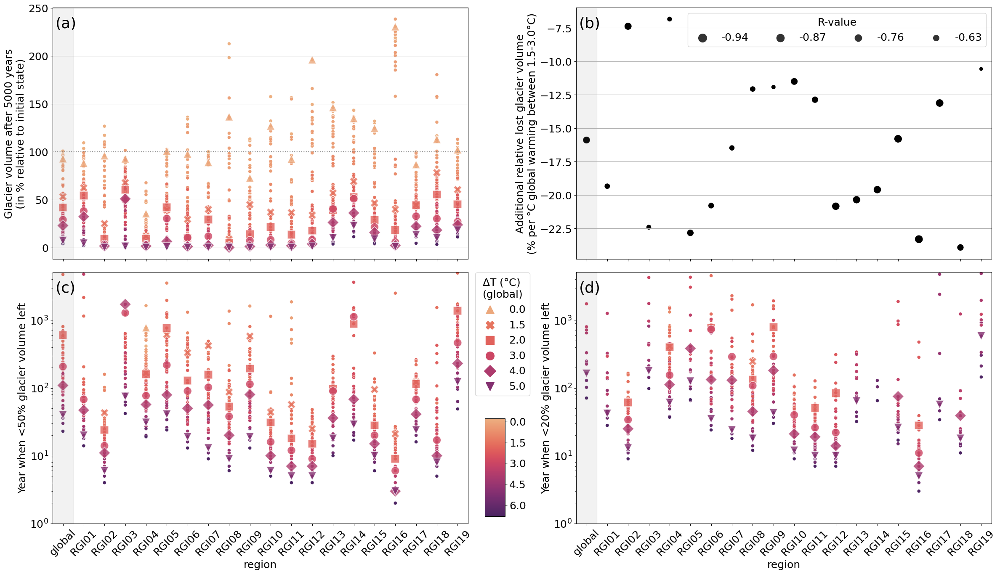

### Below is rather old stuff that got mostly replaced ...

### compare "response time"
three options where experiments and model simulations need to be classified in: 
- are "shrinking" 
- are "growing" 
- stay around the same (even if there is a spinup) (final volume +/- min_perc_change)

In [38]:
fill_option = 'repeat_last_20yrs'
ds_reg_models_extend = xr.open_dataset(f'/home/www/lschuster/glacierMIP3_analysis/glacierMIP3_{DATE}_models_all_rgi_regions_sum_scaled_extended_{fill_option}.nc')
pd_global_temp_exp_m = get_glob_temp_exp(region='global')



plt.rc('font', size=18)  

markers = ['^', 'X','s','o','D','v']

norm = plt.Normalize(vmin=pd_global_temp_exp_m['temp_ch_ipcc'].min(),
                     vmax=pd_global_temp_exp_m['temp_ch_ipcc'].max())
cmap = sns.color_palette('flare', as_cmap=True) #sns.cubehelix_palette(light=1, as_cmap=True)
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])

# plot specific delta T:
col_temp_l = []
exp_l = []
for temp in [0,1.5,2,3,4,5]: #,5,6]:
    exp = np.abs(pd_global_temp_exp_m-temp).sort_values(by='temp_ch_ipcc').iloc[0].name
    #sm.colorbar.norm...
    col_temp = cmap(norm(pd_global_temp_exp_m.loc[exp]['temp_ch_ipcc']))
    col_temp_l.append(col_temp)
    exp_l.append(exp)

**Attention: Fig. below probably needs to be updated with the function `resp_time_estimate`**

/tmp/ipykernel_1218951/3044322566.py:107: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(pd_yr_perc_resp_time.region.unique(), rotation=45)
/tmp/ipykernel_1218951/3044322566.py:107: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(pd_yr_perc_resp_time.region.unique(), rotation=45)
/tmp/ipykernel_1218951/3044322566.py:144: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


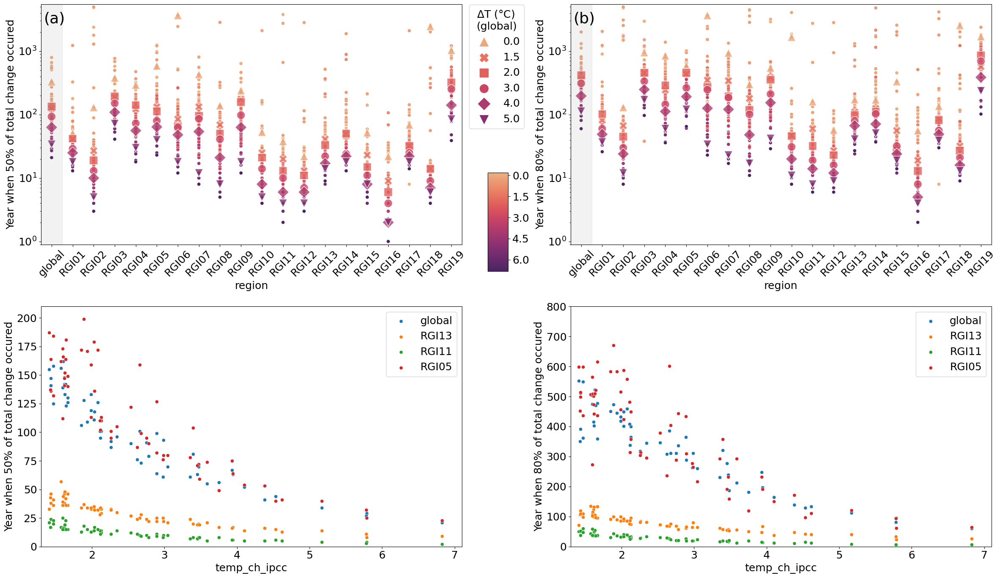

In [26]:
fig, axss= plt.subplots(2,2,figsize=(24,14))

# first subplot
axs = axss[0]
jj=0
for ax, perc in zip(axs[0:2], [50,80]):

    ds_reg_models_vol_all = ds_reg_models_extend.volume_m3 # .sel(simulation_year=slice(0,2000)) # need to do the interpolation first !!!!
    # Let's take the median/iqr estimate from all glacier models for every RGI region and then do the sum:
    ds_reg_models_vol_all = ds_reg_models_vol_all.stack(experiments=['gcm','period_scenario'])
    ds_reg_models_med_vol_all = ds_reg_models_vol_all.median(dim='model_author')
    
    eq_med_vol = ds_reg_models_med_vol_all.isel(simulation_year=np.arange(-20,0,1)).sum(dim='rgi_reg').mean(dim='simulation_year')
    begin_med_vol = ds_reg_models_med_vol_all.isel(simulation_year=0).sum(dim='rgi_reg')

    
    ds_reg_models_med_vol_glob_resp_time =   np.abs(100*(begin_med_vol-ds_reg_models_med_vol_all.sum(dim='rgi_reg')) / (begin_med_vol- eq_med_vol)) # can be positive and negative 
    ds_reg_models_med_vol_glob_resp_time = ds_reg_models_med_vol_glob_resp_time.assign_coords(temp_ch_ipcc = ('experiments',
                                                                          pd_global_temp_exp_m.loc[ds_reg_models_med_vol_glob_resp_time.experiments, # make sure thatwe use the same experiments
                                                                                                   'temp_ch_ipcc']))

    ds_reg_models_med_vol_glob_resp_time_perc = ds_reg_models_med_vol_glob_resp_time.where((ds_reg_models_med_vol_glob_resp_time<=perc) | (ds_reg_models_med_vol_glob_resp_time>=100+perc)) #ds_reg_models_med_vol_glob_resp_time.where(ds_reg_models_med_vol_glob_resp_time<=perc)
    #ds_reg_below_50_perc.max(dim='simulation_year')
    yr_perc = ds_reg_models_med_vol_glob_resp_time_perc.idxmax(dim='simulation_year')

    pd_yr_perc_resp_time = yr_perc.to_dataframe(f'Year when {perc}% of total change occured').reset_index()
    pd_yr_perc_resp_time['region'] = 'global' 
    
    for rgi_reg in ds_reg_models_extend.rgi_reg.values:
        eq_med_vol_reg = ds_reg_models_med_vol_all.isel(simulation_year=np.arange(-20,0,1)).sel(rgi_reg=rgi_reg).mean(dim='simulation_year')
        begin_med_vol_reg = ds_reg_models_med_vol_all.isel(simulation_year=0).sel(rgi_reg=rgi_reg)

        ds_reg_models_med_vol_sel_rel = np.abs(100*(begin_med_vol_reg-ds_reg_models_med_vol_all.sel(rgi_reg=rgi_reg))/(begin_med_vol_reg-eq_med_vol_reg)) # can be positive and negative 
        ds_reg_models_med_vol_sel_rel = ds_reg_models_med_vol_sel_rel.assign_coords(temp_ch_ipcc = ('experiments',
                                                                              pd_global_temp_exp_m.loc[ds_reg_models_med_vol_sel_rel.experiments, # make sure thatwe use the same experiments
                                                                                                       'temp_ch_ipcc']))

        ds_reg_below_perc_sel = ds_reg_models_med_vol_sel_rel.where((ds_reg_models_med_vol_sel_rel<=perc) | (ds_reg_models_med_vol_sel_rel>=100+perc)) #ds_reg_models_med_vol_sel_rel.where(ds_reg_models_med_vol_sel_rel<=perc)
        yr_perc_sel = ds_reg_below_perc_sel.idxmax(dim='simulation_year')

        pd_yr_perc_resp_time_reg = yr_perc_sel.to_dataframe(f'Year when {perc}% of total change occured').reset_index()
        pd_yr_perc_resp_time_reg['region'] = f'RGI{rgi_reg}'
        pd_yr_perc_resp_time = pd.concat([pd_yr_perc_resp_time,pd_yr_perc_resp_time_reg])

    pd_yr_perc_resp_time=pd_yr_perc_resp_time.drop(columns='rgi_reg')
    
    sns.scatterplot(ax=ax,
                    hue='temp_ch_ipcc',
                    y=f'Year when {perc}% of total change occured',
                    x='region',
                    palette='flare',
                    data=pd_yr_perc_resp_time, legend=False)
    

    #axss[1][jj].set_ylim([0.9,2000])
    
    
    # plot specific delta T:
    ds_sel = pd_yr_perc_resp_time.groupby(['gcm','period_scenario','region']).mean().to_xarray().stack(experiments=['gcm','period_scenario'])
    pd_yr_perc_resp_time_sel = ds_sel.sel(experiments=exp_l).to_dataframe().reset_index().dropna()
    
    if np.all(pd_yr_perc_resp_time_sel.temp_ch_ipcc >=0.5):
        # in no region that amount is lost when having 0°C global warming
        col_temp_l_sel = col_temp_l[1:].copy()
        markers_sel = markers[1:].copy()
    else:
        col_temp_l_sel = col_temp_l.copy()
        markers_sel = markers.copy()
        
    if perc == 50:
        legend_opt = 'auto'
    else:
        legend_opt = False
    sns.scatterplot(ax=ax,
                    hue='temp_ch_ipcc',
                    y=f'Year when {perc}% of total change occured',
                    x='region',
                    data=pd_yr_perc_resp_time_sel,
                    markers=markers_sel,
                    style='temp_ch_ipcc',
                    palette=sns.color_palette(col_temp_l_sel),
                    alpha = 0.8,
                 legend=legend_opt,size='temp_ch_ipcc', sizes=(200,200));
    
    if perc == 50:
        leg = ax.legend(loc='upper left', bbox_to_anchor=(1.005,1.02),
                        title=f'$\Delta$T (°C)\n(global)',
                        markerscale=1, handleheight=0.8)
        for j,t in enumerate(leg.texts):
        #    # truncate label text to 4 characters
            if j ==1:
                t.set_text(np.round(float(t.get_text()),1))
            else:
                t.set_text(np.round(float(t.get_text()),0))
                
                
        ## get colormap 
        add_cmap = True
        if add_cmap:
            cax = fig.add_axes([ax.get_position().x1+0.01, ax.get_position().y0, 0.02, ax.get_position().height / 2.1])
            cbar = ax.figure.colorbar(sm, cax=cax)
            cbar.ax.invert_yaxis()
            cbar.set_ticks([0,1.5,3.0,4.5,6.0])

    ax.set_yscale('log')
    
    ax.set_xticklabels(pd_yr_perc_resp_time.region.unique(), rotation=45)
    ax.set_ylim([0.9,5500])
    
    
    sns.scatterplot(x='temp_ch_ipcc',
          y=f'Year when {perc}% of total change occured',
          data=pd_yr_perc_resp_time.loc[pd_yr_perc_resp_time.region == 'global'], ax=axss[1][jj], label='global')
    sns.scatterplot(x='temp_ch_ipcc',
          y=f'Year when {perc}% of total change occured',
          data=pd_yr_perc_resp_time.loc[pd_yr_perc_resp_time.region == 'RGI13'], ax=axss[1][jj], label='RGI13')
    sns.scatterplot(x='temp_ch_ipcc',
          y=f'Year when {perc}% of total change occured',
          data=pd_yr_perc_resp_time.loc[pd_yr_perc_resp_time.region == 'RGI11'], ax=axss[1][jj], label='RGI11')
    sns.scatterplot(x='temp_ch_ipcc',
          y=f'Year when {perc}% of total change occured',
          data=pd_yr_perc_resp_time.loc[pd_yr_perc_resp_time.region == 'RGI05'], ax=axss[1][jj], label='RGI05')
    if perc == 50:
        axss[1][jj].set_ylim([0,210])
    else:
        axss[1][jj].set_ylim([0,800])
    axss[1][jj].set_xlim([1.3,7.1])

    jj+=1
    
    
num_text_x = 0.007
for j,axi in enumerate([axs[0],axs[1]]): #0][1], axs[1][0], axs[1][1]]):
    #if j <2:
    num_text_y = 0.92
    #else:
    #    num_text_y = 0.87
    axi.text(num_text_x, num_text_y,
             num_dict[j], fontsize=26, transform=axi.transAxes)
    axi.axvspan(-0.5,0.5,color='grey', alpha = 0.1)
    axi.set_xlim([-0.5,19.5])
    
    
plt.tight_layout()
plt.savefig(f'figures/2_resp_time_rgi_region_analysis_{DATE}.png')

- spinup effect that creates the large spread at the beginning probably ... 
- need to clarify what is growing
- at the moment assume equilibrium after 5000 years and we take the average over the last 20 years

** For every glacier model separately** -> in 3_response_time_analysis.ipynb**

In [ ]:
### Random old code...

In [ ]:
pd_global_temp_exp_m = get_glob_temp_exp(region='global')

ds_reg_models_vol = ds_reg_models.isel(simulation_year=slice(0,2000)).volume_m3
# Let's take the median/iqr estimate from all glacier models for every RGI region and then do the sum:
ds_reg_models_vol = ds_reg_models_vol.stack(experiments=['gcm','period_scenario'])

In [ ]:


### regional 
ds_reg_models_med_vol_2000 = 100*ds_reg_models_vol.median(dim='model_author').isel(simulation_year=1999)/ds_reg_models_vol.median(dim='model_author').isel(simulation_year=0)
# this here takes a while
#ds_reg_models_gcm_q25_q50_q75_vol = ds_reg_models_gcm_vol.quantile([0.25,0.5,0.75], dim='model_author')
# pd_global_temp_exp_m = get_glob_temp_exp(region=f'RGI{rgi_reg}_global') # pd_global_temp_exp.groupby(['gcm','period_scenario']).mean()
ds_reg_models_med_vol_2000 = ds_reg_models_med_vol_2000.assign_coords(temp_ch_ipcc = ('experiments',
                                                                                pd_global_temp_exp_m.loc[ds_reg_models_med_vol_2000.experiments.values, 'temp_ch_ipcc'].values))
ds_reg_models_med_vol_2000 = ds_reg_models_med_vol_2000.sortby('temp_ch_ipcc')
ds_reg_models_med_vol_2000 = ds_reg_models_med_vol_2000.reset_coords()
pd_reg_models_med_vol_2000 = ds_reg_models_med_vol_2000.to_dataframe().reset_index()
pd_reg_models_med_vol_2000['region'] = 'RGI' + pd_reg_models_med_vol_2000['rgi_reg']

### global
ds_glob_models_med_vol_2000 = 100*ds_reg_models_vol.median(dim='model_author').isel(simulation_year=1999).sum(dim='rgi_reg')/ds_reg_models_vol.median(dim='model_author').isel(simulation_year=0).sum(dim='rgi_reg')
ds_glob_models_med_vol_2000 = ds_glob_models_med_vol_2000.assign_coords(temp_ch_ipcc = ('experiments',
                                                                                pd_global_temp_exp_m.loc[ds_glob_models_med_vol_2000.experiments.values, 'temp_ch_ipcc'].values))
ds_glob_models_med_vol_2000 = ds_glob_models_med_vol_2000.sortby('temp_ch_ipcc')
ds_glob_models_med_vol_2000 = ds_glob_models_med_vol_2000.reset_coords()
pd_glob_models_med_vol_2000 = ds_glob_models_med_vol_2000.to_dataframe().reset_index()
pd_glob_models_med_vol_2000['region'] = 'global'

### concatenate both
pd_all_models_med_vol_2000 = pd.concat([pd_glob_models_med_vol_2000, pd_reg_models_med_vol_2000])

# get the % lost per °C (here from 1.5 - 3°C)
pd_all_models_med_vol_2000_sel_1o5_3 = pd_all_models_med_vol_2000.loc[(pd_all_models_med_vol_2000.temp_ch_ipcc>=1.5) & (pd_all_models_med_vol_2000.temp_ch_ipcc<=3)]

slope_rgi_dict = {}
pd_slope_rgi_reg_1o5_3 = pd.DataFrame(index=np.arange(0,20))
intercept_l = []
slope_l = []
rval_l = []
pval_l = []
stderr_l = []
region_l = []
for region in pd_all_models_med_vol_2000_sel_1o5_3.region.unique():
    pd_sel = pd_all_models_med_vol_2000_sel_1o5_3.loc[pd_all_models_med_vol_2000_sel_1o5_3.region==region]
    slope, intercept, rval, pval, stderr = scipy.stats.linregress(pd_sel['temp_ch_ipcc'].values, pd_sel['volume_m3'])
    slope_l.append(slope)
    intercept_l.append(intercept)
    stderr_l.append(stderr)
    rval_l.append(rval)
    pval_l.append(pval)
    region_l.append(region)
pd_slope_rgi_reg_1o5_3['slope'] = slope_l
pd_slope_rgi_reg_1o5_3['intercept'] = intercept_l
pd_slope_rgi_reg_1o5_3['stderr'] = stderr_l
pd_slope_rgi_reg_1o5_3['pval'] = pval_l
pd_slope_rgi_reg_1o5_3['rval'] = rval_l
pd_slope_rgi_reg_1o5_3['region'] = region_l


In [ ]:
#global
#global
plt.rc('font', size=18)     
for rgi_reg in rgi_regs:
    fig,axs= plt.subplots(1,2,figsize=(24,8),sharey=True)
    plt.suptitle(f'RGI{rgi_reg} (Shading is 0.25 to 0.75 quantiles, i.e., the interquartile range)')
    ax = axs[0]
    ds_reg_models_med_vol_glob = ds_reg_models_med_vol.sel(rgi_reg=rgi_reg) #ds_reg_models_med_vol.sum(dim='rgi_reg')
    pd_global_temp_exp_m = get_glob_temp_exp(region='global')
    ds_reg_models_med_vol_glob = ds_reg_models_med_vol_glob.assign_coords(temp_ch_ipcc = ('experiments',
                                                                          pd_global_temp_exp_m.loc[ds_reg_models_med_vol_glob.experiments.values, 'temp_ch_ipcc'].values))
    # need that to have bot volume_m3 and temp_ch_ipcc as variables
    ds_reg_models_med_vol_glob = ds_reg_models_med_vol_glob.reset_coords()

    # normi = matplotlib.colors.Normalize(vmax=4, vmin=-4)
    pd_t =ds_reg_models_med_vol_glob.to_dataframe().reset_index()
    #pd_q25 =ds_reg_models_gcm_q25_q50_q75_vol_glob.sel(quantile=0.25).to_dataframe().reset_index()
    #pd_q75 =ds_reg_models_gcm_q25_q50_q75_vol_glob.sel(quantile=0.75).to_dataframe().reset_index()
    pd_t['volume (km3)'] = pd_t['volume_m3']/1e9
    #pd_q25['volume (km3)'] = pd_q25['volume_m3']/1e9
    #pd_q75['volume (km3)'] = pd_q75['volume_m3']/1e9
    sns.lineplot(ax=ax,
                 data=pd_t,
                 x='simulation_year',
                 y='volume (km3)',
                hue='temp_ch_ipcc', palette='flare',legend='auto',lw=1.5);
    leg = ax.get_legend()

    exp_temp_min = ds_reg_models_med_vol_glob.temp_ch_ipcc.idxmin()
    # only compute the quantile for the experiment w. minimum / maximum temperature, then just sum up the quantiles to get from regional to global estimates
    q25_75_min = ds_reg_models_vol.sel(experiments=exp_temp_min).quantile([0.25,0.75], dim='model_author')/1e9
    q25_75_min_glob = q25_75_min.sel(rgi_reg=rgi_reg)
    ax.fill_between(ds_reg_models_gcm_q25_q50_q75_vol_glob.simulation_year,
             q25_75_min_glob.sel(quantile=0.75), q25_75_min_glob.sel(quantile=0.25), alpha = 0.2, color=lines.lines[0].get_color(), label='IQR')
    handles, labels = ax.get_legend_handles_labels()
    t = plt.legend(handles, labels)
    ax.add_artist(leg)

    exp_temp_max = ds_reg_models_med_vol_glob.temp_ch_ipcc.idxmax()
    # only compute the quantile for the experiment w. minimum / maximum temperature, then just sum up the quantiles to get from regional to global estimates
    q25_75_max = ds_reg_models_vol.sel(experiments=exp_temp_max).quantile([0.25,0.75], dim='model_author')/1e9
    q25_75_max_glob = q25_75_max.sel(rgi_reg=rgi_reg)
    ax.fill_between(ds_reg_models_gcm_q25_q50_q75_vol_glob.simulation_year,
                    q25_75_max_glob.sel(quantile=0.75),
                    q25_75_max_glob.sel(quantile=0.25), alpha = 0.2, color=lines.lines[-1].get_color());
    ax.set_ylabel(f'RGI{rgi_reg} glacier volume (km³)')
    ax.get_legend().set_title(r'$\Delta$T (°C)')

    
    ax=axs[1]
    ax.set_title(f'RGI{rgi_reg} glacier volume (km³) after 2000 years')
    sns.scatterplot(ax=ax,
                    x='temp_ch_ipcc',
                 y='volume (km3)', data = pd_t.loc[pd_t.simulation_year==1999],
                hue='temp_ch_ipcc', palette='flare',legend='auto', s=80)

    ax.set_xlabel('Global temperature change (°C, compared to pre-industrial levels)')
    ax.get_legend().set_title(r'$\Delta$T (°C)')


    q25_75_2000 = ds_reg_models_vol.isel(simulation_year=1999).quantile([0.25,0.75], dim='model_author')/1e9
    q25_75_2000_glob = q25_75_2000.sel(rgi_reg=rgi_reg) #sum(dim='rgi_reg')

    q25_75_2000_glob = q25_75_2000_glob.assign_coords(temp_ch_ipcc = ('experiments',
                                                   pd_global_temp_exp_m.loc[ds_reg_models_med_vol_glob.experiments.values, 'temp_ch_ipcc'].values))
    q25_75_2000_glob = q25_75_2000_glob.reset_coords()

    q25_75_2000_glob = q25_75_2000_glob.sortby('temp_ch_ipcc')
    def smoothen(x, winsize=5):
        return np.array(pd.Series(x).rolling(winsize).mean())[winsize-1:]

    plt.fill_between(smoothen(q25_75_2000_glob.temp_ch_ipcc),
                     smoothen(q25_75_2000_glob.volume_m3.sel(quantile=0.25)),
                     smoothen(q25_75_2000_glob.volume_m3.sel(quantile=0.75)),
                     step='mid',
                     interpolate=True,
                     alpha = 0.2, color='grey');
    plt.tight_layout()
    plt.savefig(f'figures/2_timeseries_temp_ch_reg_glob/2_RGI{rgi_reg}_timeseries_vol_temp_ch.png')
    plt.close()

    
#########################
#############  Now the same but for regional glacier temperature change:#############
plt.rc('font', size=18)     
for rgi_reg in rgi_regs:
    fig,axs= plt.subplots(1,2,figsize=(24,8),sharey=True)
    plt.suptitle(f'RGI{rgi_reg} (Shading is 0.25 to 0.75 quantiles, i.e., the interquartile range)')
    ax = axs[0]
    ds_reg_models_med_vol_glob = ds_reg_models_med_vol.sel(rgi_reg=rgi_reg) #ds_reg_models_med_vol.sum(dim='rgi_reg')
    # add global temp. change to the dataset 
    pd_global_temp_exp_m = get_glob_temp_exp(region=f'RGI{rgi_reg}_global') # pd_global_temp_exp.groupby(['gcm','period_scenario']).mean()
    ds_reg_models_med_vol_glob = ds_reg_models_med_vol_glob.assign_coords(temp_ch_ipcc = ('experiments',
                                                                                pd_global_temp_exp_m.loc[ds_reg_models_med_vol_glob.experiments.values, 'temp_ch_ipcc'].values))
    # need that to have bot volume_m3 and temp_ch_ipcc as variables
    ds_reg_models_med_vol_glob = ds_reg_models_med_vol_glob.reset_coords()

    # normi = matplotlib.colors.Normalize(vmax=4, vmin=-4)
    pd_t =ds_reg_models_med_vol_glob.to_dataframe().reset_index()
    #pd_q25 =ds_reg_models_gcm_q25_q50_q75_vol_glob.sel(quantile=0.25).to_dataframe().reset_index()
    #pd_q75 =ds_reg_models_gcm_q25_q50_q75_vol_glob.sel(quantile=0.75).to_dataframe().reset_index()
    pd_t['volume (km3)'] = pd_t['volume_m3']/1e9
    #pd_q25['volume (km3)'] = pd_q25['volume_m3']/1e9
    #pd_q75['volume (km3)'] = pd_q75['volume_m3']/1e9
    sns.lineplot(ax=ax,
                 data=pd_t,
                 x='simulation_year',
                 y='volume (km3)',
                hue='temp_ch_ipcc', palette='flare',legend='auto',lw=1.5);
    leg = ax.get_legend()

    exp_temp_min = ds_reg_models_med_vol_glob.temp_ch_ipcc.idxmin()
    # only compute the quantile for the experiment w. minimum / maximum temperature, then just sum up the quantiles to get from regional to global estimates
    q25_75_min = ds_reg_models_vol.sel(experiments=exp_temp_min).quantile([0.25,0.75], dim='model_author')/1e9
    q25_75_min_glob = q25_75_min.sel(rgi_reg=rgi_reg)
    ax.fill_between(ds_reg_models_gcm_q25_q50_q75_vol_glob.simulation_year,
             q25_75_min_glob.sel(quantile=0.75), q25_75_min_glob.sel(quantile=0.25), alpha = 0.2, color=lines.lines[0].get_color(), label='IQR')
    handles, labels = ax.get_legend_handles_labels()
    t = plt.legend(handles, labels)
    ax.add_artist(leg)

    exp_temp_max = ds_reg_models_med_vol_glob.temp_ch_ipcc.idxmax()
    # only compute the quantile for the experiment w. minimum / maximum temperature, then just sum up the quantiles to get from regional to global estimates
    q25_75_max = ds_reg_models_vol.sel(experiments=exp_temp_max).quantile([0.25,0.75], dim='model_author')/1e9
    q25_75_max_glob = q25_75_max.sel(rgi_reg=rgi_reg)
    ax.fill_between(ds_reg_models_gcm_q25_q50_q75_vol_glob.simulation_year,
             q25_75_max_glob.sel(quantile=0.75), q25_75_max_glob.sel(quantile=0.25), alpha = 0.2, color=lines.lines[-1].get_color());
    ax.set_ylabel(f'RGI{rgi_reg} glacier volume (km³)')
    ax.get_legend().set_title(r'$\Delta$T (°C)'+'\nregional glacier')


    ax=axs[1]
    ax.set_title(f'RGI{rgi_reg} glacier volume (km³) after 2000 years')
    sns.scatterplot(ax=ax,
                    x='temp_ch_ipcc',
                 y='volume (km3)', data = pd_t.loc[pd_t.simulation_year==1999],
                hue='temp_ch_ipcc', palette='flare',legend='auto', s=80)
    
    ax.set_xlabel('Regional glacier temperature change (°C, compared to pre-industrial levels)')

    ax.get_legend().set_title(r'$\Delta$T (°C)'+'\nregional glacier');

    q25_75_2000 = ds_reg_models_vol.isel(simulation_year=1999).quantile([0.25,0.75], dim='model_author')/1e9
    q25_75_2000_glob = q25_75_2000.sel(rgi_reg=rgi_reg) #sum(dim='rgi_reg')

    q25_75_2000_glob = q25_75_2000_glob.assign_coords(temp_ch_ipcc = ('experiments',
                                                   pd_global_temp_exp_m.loc[ds_reg_models_med_vol_glob.experiments.values, 'temp_ch_ipcc'].values))
    q25_75_2000_glob = q25_75_2000_glob.reset_coords()

    q25_75_2000_glob = q25_75_2000_glob.sortby('temp_ch_ipcc')
    def smoothen(x, winsize=3):
        return np.array(pd.Series(x).rolling(winsize).mean())[winsize-1:]

    plt.fill_between(smoothen(q25_75_2000_glob.temp_ch_ipcc),
                     smoothen(q25_75_2000_glob.volume_m3.sel(quantile=0.25)),
                     smoothen(q25_75_2000_glob.volume_m3.sel(quantile=0.75)),
                     step='mid',
                     interpolate=True,
                     alpha = 0.2, color='grey');
    plt.tight_layout()
    plt.savefig(f'figures/2_timeseries_temp_ch_reg_glob/2_RGI{rgi_reg}_timeseries_vol_reg_glac_temp_ch.png')    
    plt.close()

In [ ]:
# OLD: just one GCM

gcm = 'gfdl-esm4'

pd_global_temp_exp_gcm = pd_global_temp_exp.loc[pd_global_temp_exp.gcm ==gcm]
ds_reg_models_gcm_vol = ds_reg_models.sel(gcm = gcm).isel(simulation_year=slice(0,2000)).volume_m3
# Let's take the median/iqr estimate from all glacier models for every RGI region and then do the sum:
ds_reg_models_gcm_med_vol = ds_reg_models_gcm_vol.median(dim='model_author')
# this here takes a while
ds_reg_models_gcm_q25_q50_q75_vol = ds_reg_models_gcm_vol.quantile([0.25,0.5,0.75], dim='model_author')
#global
ds_reg_models_gcm_q25_q50_q75_vol_glob = ds_reg_models_gcm_q25_q50_q75_vol.sum(dim='rgi_reg')
# add global temp. change to the dataset 
pd_global_temp_exp_gcm.index = pd_global_temp_exp_gcm.period_scenario
ds_reg_models_gcm_q25_q50_q75_vol_glob = ds_reg_models_gcm_q25_q50_q75_vol_glob.assign_coords(temp_ch_ipcc = ('period_scenario',
                                                                            pd_global_temp_exp_gcm.loc[ds_reg_models_gcm_q25_q50_q75_vol_glob.period_scenario.values, 'temp_ch_ipcc'].values))
# need that to have bot volume_m3 and temp_ch_ipcc as variables
ds_reg_models_gcm_q25_q50_q75_vol_glob = ds_reg_models_gcm_q25_q50_q75_vol_glob.reset_coords()

# normi = matplotlib.colors.Normalize(vmax=4, vmin=-4)
pd_t =ds_reg_models_gcm_q25_q50_q75_vol_glob.sel(quantile=0.5).to_dataframe().reset_index()
#pd_q25 =ds_reg_models_gcm_q25_q50_q75_vol_glob.sel(quantile=0.25).to_dataframe().reset_index()
#pd_q75 =ds_reg_models_gcm_q25_q50_q75_vol_glob.sel(quantile=0.75).to_dataframe().reset_index()
pd_t['volume (km3)'] = pd_t['volume_m3']/1e9
#pd_q25['volume (km3)'] = pd_q25['volume_m3']/1e9
#pd_q75['volume (km3)'] = pd_q75['volume_m3']/1e9
lines = sns.lineplot(data=pd_t,
             x='simulation_year',
             y='volume (km3)',
            hue='temp_ch_ipcc', palette='flare',legend='auto',lw=2);


period_ssp_temp_min = ds_reg_models_gcm_q25_q50_q75_vol_glob.temp_ch_ipcc.idxmin()
sel = ds_reg_models_gcm_q25_q50_q75_vol_glob.volume_m3.sel(period_scenario=period_ssp_temp_min)/1e9
plt.fill_between(ds_reg_models_gcm_q25_q50_q75_vol_glob.simulation_year,
         sel.sel(quantile=0.75), sel.sel(quantile=0.25), alpha = 0.2, color=lines.lines[0].get_color())

period_ssp_temp_max = ds_reg_models_gcm_q25_q50_q75_vol_glob.temp_ch_ipcc.idxmax()
sel = ds_reg_models_gcm_q25_q50_q75_vol_glob.volume_m3.sel(period_scenario=period_ssp_temp_max)/1e9
plt.fill_between(ds_reg_models_gcm_q25_q50_q75_vol_glob.simulation_year,
         sel.sel(quantile=0.75), sel.sel(quantile=0.25), alpha = 0.2, color=lines.lines[-1].get_color());


In [ ]:
for period_scenario in ds_reg_models_gcm_q25_q50_q75_vol_glob.period_scenario:
    ds_reg_models_gcm_q25_q50_q75_vol_glob
    plt.scatter(ds_reg_models_gcm_q25_q50_q75_vol_glob.simulation_year,
             ds_reg_models_gcm_q25_q50_q75_vol_glob.volume_m3.sel(quantile=0.5).sel(period_scenario=period_scenario),
               color=c);

In [ ]:


pd_global_temp_exp_gcm.index = pd_global_temp_exp_gcm.period_scenario

ds_reg_models_med_v_glob = ds_reg_models_med_v.sum(dim='rgi_reg')

# this is really unefficient
ds_reg_models_med_v_glob.to_dataframe().reset_index().pivot_table(values = 'volume_m3', index=)

In [4]:


pd_reg_models_med_v_glob =  ds_reg_models_med_v.sum(dim='rgi_reg').to_dataframe().reset_index().groupby(['period_scenario', 'simulation_year', 'gcm']).sum().reset_index()

pd_v_l = []
for gcm in ds_reg_models.gcm:
    pd_global_temp_exp_gcm = pd_global_temp_exp.loc[pd_global_temp_exp.gcm == 'gcm']
    ds_reg_models_med_v = ds_reg_models.volume_m3.median(dim='model_author').sel(gcm=gcm).sum(dim='rgi_reg')

    ds_reg_models_med_v = ds_reg_models_med_v.assign_coords(temp_ch_ipcc = ('period_ssp',
                                                                            pd_global_temp_exp_gcm.loc[pd_reg_models_med_v_glob.period_scenario, 'temp_ch_ipcc'].values))
    
    pd_v = ds_reg_models_med_v.to_dataframe().reset_index()
    pd_v['gcm'] = gcm.values
    pd_v_l.append(pd_v)
pd_glob_models_med_v = pd.concat(pd_v_l)

ds = pd_glob_models_med_v.groupby(['simulation_year','period_scenario', 'gcm']).mean().to_xarray()

d2000 = pd_glob_models_med_v.loc[pd_glob_models_med_v.simulation_year == 2000]

,gcm,period_scenario,temp_ch_ipcc
0,gfdl-esm4,1851-1870_hist,0.171409
1,gfdl-esm4,1901-1920_hist,0.418289
2,gfdl-esm4,1951-1970_hist,0.332281
3,gfdl-esm4,1995-2014_hist,0.841467
4,gfdl-esm4,2021-2040_ssp126,1.433792
...,...,...,...
75,ukesm1-0-ll,2081-2100_ssp370,5.780495
76,ukesm1-0-ll,2021-2040_ssp585,2.259733
77,ukesm1-0-ll,2041-2060_ssp585,3.586968
78,ukesm1-0-ll,2061-2080_ssp585,5.170544


In [ ]:
plt.plot(ds_reg_models_med_v.simulation_year, ds_reg_models_med_v.volume_m3.sum(dim='rgi_reg'));

In [ ]:

sns.scatterplot(data = pd_glob_models_med_v, x = 'simulation_year', hue='temp_ch_ipcc',
             y='volume_m3', palette='viridis');


sns.lineplot(data = d2000, x = 'temp_ch_ipcc',
             y='volume_m3', palette='viridis');

### OLD

In [ ]:
def get_vol_timeseries_temp_ch_Xyr_glob_glacier_portrait(region='global', perc=90, sim_year=2000, avg_over = '100yr', smooth_values_percentiles=1,
                                                        exp_decay_temp_fit=False, temp_above_0_8=False, landscape = False):
    

    if temp_above_0_8:
        add= '_temp_above_0_8'
        current_deltaT = 1.1
    else:
        add = ''
        current_deltaT = 0
        
    pd_exp_decay_fits_simple = pd.read_csv(f'fitted_glacier_response_to_global_temp_ch_simple_{avg_over}_avg_period{add}.csv', index_col=0)

        
    q1=(50-perc/2)/100
    q2=(50+perc/2)/100
    
    
    plt.rc('font', size=24)  
    if landscape:
        fig,axs= plt.subplots(1,2,figsize=(26,10))
        add = add+'_landscape'

    else:
        fig,axs= plt.subplots(2,1,figsize=(12,20))

    ax = axs[0]
    # get global temp. change
    pd_global_temp_exp_m = get_glob_temp_exp(region='global')

    if region == 'global':
        # get global glacier temp.change
        pd_global_temp_exp_m_glac = get_glob_temp_exp(region='global_glacier')
        ds_reg_models_med_vol_sel = ds_reg_models_med_vol.sum(dim='rgi_reg')
        n_models = ''
        rgi_reg = 'global'
        rgi_reg_f = 'All'

    else:
        # get regional glacier temp. change
        pd_global_temp_exp_m_glac = get_glob_temp_exp(region=region)
        rgi_reg = region[3:5]
        rgi_reg_f = rgi_reg
        ds_reg_models_med_vol_sel = ds_reg_models_med_vol.sel(rgi_reg=rgi_reg)
        # check how many glacier models have at least some estimates
        reg_glac_models = ds_reg_models_vol.sel(rgi_reg=rgi_reg).dropna(dim='model_author', how='all').model_author
        print(reg_glac_models.values)
        n_models = len(reg_glac_models)
        n_models = f'{n_models} '
    if exp_decay_temp_fit:
        # only for exp_decay_temp_fit
        _,_,a,b = pd_exp_decay_fits_simple.loc[(pd_exp_decay_fits_simple.rgi_reg==rgi_reg_f)&(pd_exp_decay_fits_simple.year==5000)].values.squeeze()
        pd_global_temp_exp_m['fitted_vol_ch'] = a*np.exp(-b*(pd_global_temp_exp_m['temp_ch_ipcc']-current_deltaT))
        if temp_above_0_8:
            # don't plot above 0°C
            pd_global_temp_exp_m.loc[pd_global_temp_exp_m.temp_ch_ipcc<current_deltaT, 'fitted_vol_ch'] = np.NaN
    
    ds_reg_models_med_vol_sel = ds_reg_models_med_vol_sel.assign_coords(temp_ch_ipcc = ('experiments',
                                                                          pd_global_temp_exp_m.loc[ds_reg_models_med_vol_sel.experiments, # make sure thatwe use the same experiments pd_global_temp_exp_m_glac
                                                                                                 'temp_ch_ipcc']))
    
    ds_reg_models_med_vol_sel = ds_reg_models_med_vol_sel.assign_coords(temp_ch_ipcc_glacier = ('experiments',
                                                                          pd_global_temp_exp_m_glac.loc[ds_reg_models_med_vol_sel.experiments, # make sure thatwe use the same experiments pd_global_temp_exp_m_glac
                                                                                                 'temp_ch_ipcc']))
    # need that to have bot volume_m3 and temp_ch_ipcc as variables
    ds_reg_models_med_vol_sel = ds_reg_models_med_vol_sel.reset_coords()
    init_vol = ds_reg_models_med_vol_sel.volume_m3.isel(simulation_year=0)
    ds_reg_models_med_vol_sel['relative volume change (in %)'] = 100*ds_reg_models_med_vol_sel.volume_m3/init_vol
    #print(ds_reg_models_med_vol_sel)
    pd_t =ds_reg_models_med_vol_sel.to_dataframe()
    pd_t = pd_t.drop(columns=['gcm','period_scenario'])
    pd_t = pd_t.reset_index()
    #pd_t['volume (km3)'] = pd_t['volume_m3']/1e9

    g = sns.lineplot(ax=ax,
                 data=pd_t,
                 x='simulation_year',
                 y='relative volume change (in %)', #'volume (km3)',
                hue='temp_ch_ipcc', palette='flare',legend=False,lw=1, alpha = 0.7);

    ## get colormap 
    norm = plt.Normalize(vmin=pd_global_temp_exp_m['temp_ch_ipcc'].min(),
                         vmax=pd_global_temp_exp_m['temp_ch_ipcc'].max())
    cmap = sns.color_palette('flare', as_cmap=True) #sns.cubehelix_palette(light=1, as_cmap=True)
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])
    
    if landscape:
        cax = fig.add_axes([ax.get_position().x1-0.07, ax.get_position().y0+0.01, 0.02, ax.get_position().height / 2.6])
    else:
        cax = fig.add_axes([ax.get_position().x1-0.12, ax.get_position().y0+0.01, 0.02, ax.get_position().height / 2.6])
    cbar = ax.figure.colorbar(sm, cax=cax)
    cbar.ax.invert_yaxis()
    cbar.set_ticks([0,1.5,3.0,4.5,6.0])
    cbar.set_label(r'$\Delta$T (°C, global)')
    
    # plot specific delta T:
    col_temp_l = []
    exp_l = []
    for deltaT in [0,1.5,2,3,4]:
        _deltaT_sel = ds_reg_models_med_vol_sel.where((ds_reg_models_med_vol_sel.temp_ch_ipcc>deltaT-0.25) & (ds_reg_models_med_vol_sel.temp_ch_ipcc<deltaT+0.25)).dropna(dim='experiments')
        n_deltaT=len(_deltaT_sel.experiments)
        print(n_deltaT)
        _deltaT_sel = _deltaT_sel.median(dim='experiments')
    for temp in [0,1.5,2,3,4,5]: #,5,6]:
        exp = np.abs(pd_global_temp_exp_m-temp).sort_values(by='temp_ch_ipcc').iloc[0].name
        col_temp = cmap(sm.colorbar.norm(pd_global_temp_exp_m.loc[exp]['temp_ch_ipcc']))
        col_temp_l.append(col_temp)
        exp_l.append(exp)
    pd_t_sel =ds_reg_models_med_vol_sel.sel(experiments=exp_l).to_dataframe()
    pd_t_sel = pd_t_sel.drop(columns=['gcm','period_scenario'])
    pd_t_sel = pd_t_sel.reset_index()
    #pd_t_sel['volume (km3)'] = pd_t_sel['volume_m3']/1e9
    l_sel = sns.lineplot(ax=ax,
                 data=pd_t_sel,
                 x='simulation_year',
                 y='relative volume change (in %)', #'volume (km3)',
                hue='temp_ch_ipcc', palette=sns.color_palette(col_temp_l),
                 legend='auto',lw=5, ls='--');
    ax.legend(loc='upper right', bbox_to_anchor=(1,1), markerscale=1, handleheight=0.8)
    leg = ax.get_legend()
    for j,t in enumerate(leg.texts):
        # truncate label text to 4 characters
        if j ==1:
            t.set_text(np.round(float(t.get_text()),1))
        else:
            t.set_text(np.round(float(t.get_text()),0))
    # set the linewidth of each legend object
    for legobj in leg.legend_handles:
        legobj.set_linewidth(4.0)
        legobj.set_linestyle('--')
    #g.legend(loc='upper right', bbox_to_anchor=(1.2, 1.0), ncol=1)

    exp_temp_min = ds_reg_models_med_vol_sel.temp_ch_ipcc.idxmin()
    # only compute the quantile for the experiment w. minimum / maximum temperature, then just sum up the quantiles to get from regional to global estimates
    q1_2_min = ds_reg_models_vol.sel(experiments=exp_temp_min).quantile([q1,q2], dim='model_author')/1e9
    if region == 'global':
        q1_2_min_glob = q1_2_min.sum(dim='rgi_reg')
    else:
        q1_2_min_glob = q1_2_min.sel(rgi_reg=rgi_reg)
    q1_2_min_glob = (100*q1_2_min_glob/q1_2_min_glob.isel(simulation_year=0))
    ax.fill_between(ds_reg_models_med_vol_sel.simulation_year,
             q1_2_min_glob.sel(quantile=q1), q1_2_min_glob.sel(quantile=q2), alpha = 0.2, color=l_sel.lines[0].get_color())
    #handles, labels = ax.get_legend_handles_labels()
    #t = plt.legend(handles, labels)
    #ax.add_artist(leg)

    exp_temp_max = ds_reg_models_med_vol_sel.temp_ch_ipcc.idxmax()
    # only compute the quantile for the experiment w. minimum / maximum temperature, then just sum up the quantiles to get from regional to global estimates
    q1_2_max = ds_reg_models_vol.sel(experiments=exp_temp_max).quantile([q1,q2], dim='model_author')/1e9
    if region == 'global':
        q1_2_max_glob = q1_2_max.sum(dim='rgi_reg')
    else:
        q1_2_max_glob = q1_2_max.sel(rgi_reg=rgi_reg)
    q1_2_max_glob = (100*q1_2_max_glob/q1_2_max_glob.isel(simulation_year=0))

    ax.fill_between(ds_reg_models_med_vol_sel.simulation_year,
             q1_2_max_glob.sel(quantile=q1), q1_2_max_glob.sel(quantile=q2), alpha = 0.2, color=l_sel.lines[-1].get_color());
    if region == 'global':
        ax.set_ylabel(f'Global glacier volume (in %, relative to initial state)')
    else:
        ax.set_ylabel(f'RGI{rgi_reg} glacier volume (in %, relative to initial state)')
    ax.set_xlabel('Simulation year')
    #ax.legend(loc='upper left', bbox_to_anchor=(1.01,0.98))
    #leg = ax.get_legend()
    #leg.loc('upper right')
    leg.set_title(r'$\Delta$T (°C)'+f'\n(global)')

    # add additional legend for glacier model uncertatinties and other things ... 
    #define patches and lines to add to legend
    #patch_min = mpatches.Patch(label=f'{perc}th %-ile minimum temperature',  alpha = 0.2, color=l.lines[0].get_color())
    patch_max = mpatches.Patch(label=f'{perc}th %-ile of {n_models}glacier models',  alpha = 0.2, color='grey')
    line1 = Line2D([0], [0], label=f'median of {n_models}glacier models', color='black', lw=1, alpha = 0.7)
    line2 = Line2D([0], [0], label=r'experiment nearest to $\Delta$T', color='black', lw=5, alpha = 0.8, ls = '--')
    #add handles
    handles= [line1, line2, patch_max]
    #add legend
    ax.legend(handles=handles, title='n=80 experiments', loc='upper left', bbox_to_anchor=(0.1,1))
    ax.add_artist(leg)
    
    if region == 'global':
        ax.set_title(f'Global glacier volume equilibration experiments')
    else:
        ax.set_title(f'RGI{rgi_reg} glacier volume equilibration experiments')
    if sim_year == 2000:
        ax.set_xlim(ax.get_xlim()[0], 2600)
        ax.set_xticks(np.arange(0,2100,500),np.arange(0,2100,500))
    else:
        ax.set_xlim(ax.get_xlim()[0], 6400)
        ax.set_xticks(np.arange(0,5100,1000),np.arange(0,5100,1000))
    ########################## Second subplot
    ax=axs[1]
    ax0_ylim0, ax0_ylim1 = axs[0].get_ylim()
    if region == 'global':
        ax.set_title(f'Global glacier volume after {sim_year} years')
    else:
        ax.set_title(f'RGI{rgi_reg} glacier volume after {sim_year} years')
    sns.scatterplot(ax=ax,
                    x='temp_ch_ipcc',
                 y='relative volume change (in %)', #'volume (km3)',
                    data = pd_t.loc[pd_t.simulation_year==sim_year],
                    color='black', alpha = 0.3,
                #hue='temp_ch_ipcc', palette='flare',
                    legend=False, s=80)

    ax.set_xlabel(r'$\Delta$T$_{global}$ (°C, compared to pre-industrial levels)')
    #ax.get_legend().set_title(r'$\Delta$T (°C)');

    q1_2_2000 = ds_reg_models_vol.isel(simulation_year=sim_year).quantile([q1,q2], dim='model_author')
    if region == 'global':
        q1_2_2000_glob = q1_2_2000.sum(dim='rgi_reg')
    else:
        q1_2_2000_glob = q1_2_2000.sel(rgi_reg=rgi_reg)

    q1_2_2000_glob = q1_2_2000_glob.assign_coords(temp_ch_ipcc = ('experiments',
                                                   pd_global_temp_exp_m.loc[ds_reg_models_med_vol_sel.experiments.values, 'temp_ch_ipcc'].values))
    q1_2_2000_glob = q1_2_2000_glob.reset_coords()
    # init_vol is the same
    q1_2_2000_glob['relative volume change (in %)'] = 100*q1_2_2000_glob.volume_m3/init_vol[0]

    q1_2_2000_glob = q1_2_2000_glob.sortby('temp_ch_ipcc')
    def smoothen(x, winsize=smooth_values_percentiles):
        return np.array(pd.Series(x).rolling(winsize).mean())[winsize-1:] # want to have a centered rolling mean 
    #print(pd.Series(q1_2_2000_glob['relative volume change (in %)'].sel(quantile=q1)).rolling(smooth_values_percentiles).mean())
    #r = smoothen(q1_2_2000_glob['relative volume change (in %)'].sel(quantile=q1))
    #print(   r     )
    #print(len(r))
    if exp_decay_temp_fit:
        handles= [line1]
        if region=='global':
            line1 = Line2D([0], [0], label='median', color='black', ms=10, marker='o', lw=0,alpha = 0.8)
            handles= [line1]
            ax.legend(handles=handles, title=f'{n_models}glacier models', loc = 'upper left', bbox_to_anchor=(0.1,1))
        else:
            ds_t = 100*ds_reg_models_vol.sel(rgi_reg=rgi_reg).isel(simulation_year=slice(sim_year-21,sim_year-1)).mean(dim='simulation_year').dropna(dim='model_author')/ds_reg_models_vol.sel(rgi_reg=rgi_reg).isel(simulation_year=0).dropna(dim='model_author')
            #ds_t = ds_t.to_dataset().assign_coords(temp_ch_ipcc=pd_global_temp_exp_m_glac['temp_ch_ipcc'].values)
            pd_tt = ds_t.to_dataframe()
            pd_tt = pd_tt.drop(columns=['gcm','period_scenario'])
            pd_tt = pd_tt.reset_index()
            for m in pd_tt.model_author.unique():
                pd_tt.loc[pd_tt.model_author == m, 'temp_ch_ipcc']  = pd_global_temp_exp_m['temp_ch_ipcc'].values
            
            sns.scatterplot(ax=ax,
                x='temp_ch_ipcc',
                y='volume_m3', #'volume (km3)',
                data = pd_tt,
                #hue='temp_ch_ipcc', palette='flare',
                color='black', alpha=0.3,
                            legend=False, s=80)
            line1 = Line2D([0], [0], label='all', color='black', ms=10, marker='o', lw=0,alpha = 0.8)
            handles= [line1]
            ax.legend(handles=handles, title=f'{n_models}glacier models', loc = 'upper left', bbox_to_anchor=(0.1,1))


    else:
        if smooth_values_percentiles>1:
            ax.fill_between(q1_2_2000_glob.temp_ch_ipcc[int((smooth_values_percentiles-1)/2):-int((smooth_values_percentiles-1)/2)],
                             smoothen(q1_2_2000_glob['relative volume change (in %)'].sel(quantile=q1)),
                             smoothen(q1_2_2000_glob['relative volume change (in %)'].sel(quantile=q2)),
                             #step='mid',
                             #interpolate=True,
                             alpha = 0.2, color='grey');
        else:
            ax.fill_between(q1_2_2000_glob.temp_ch_ipcc,
                            q1_2_2000_glob['relative volume change (in %)'].sel(quantile=q1),
                            q1_2_2000_glob['relative volume change (in %)'].sel(quantile=q2),
            #                #step='mid',
            #                #interpolate=True,
                             alpha = 0.2, color='grey')

        #define patches and lines to add to legend
        line1 = Line2D([0], [0], label='median', color='black', ms=10, marker='o', lw=0,alpha = 0.8)
        if smooth_values_percentiles == 1: 
            patch = mpatches.Patch(label=f'{perc}th %-ile',  alpha = 0.2, color='grey')
        else:
            patch = mpatches.Patch(label=f'{perc}th %-ile\n({smooth_values_percentiles}-yr avg.)',
                                   alpha = 0.2, color='grey')
        
        #line1 = Line2D([0], [0], label='First Manual Line', color='purple')
        #add handles
        handles= [line1,patch]
        #add legend
        ax.legend(handles=handles, title=f'{n_models}glacier models', loc = 'upper left', bbox_to_anchor=(0.1,1))
    pd_t_sel_1o5_3 = pd_t.loc[(pd_t.temp_ch_ipcc>=1.5) & (pd_t.temp_ch_ipcc<=3)]
    pd_t_sel_1o5_3 = pd_t_sel_1o5_3.loc[pd_t_sel_1o5_3.simulation_year==sim_year]
    slope, intercept, rval, pval, stderr = scipy.stats.linregress(pd_t_sel_1o5_3['temp_ch_ipcc'].values, pd_t_sel_1o5_3['relative volume change (in %)'])
    
    if exp_decay_temp_fit:
        sns.lineplot(data=pd_global_temp_exp_m, x='temp_ch_ipcc', y='fitted_vol_ch', lw=4, color='black', ax=ax)
        func_vars = r'$V_{rel}$'+'(%)='+f'{a:.1f}*exp(-{b:.2f}*ΔT)'
        if temp_above_0_8:
            func_vars= r'$V$'+'(%)='+f'{a:.1f}*exp(-{b:.2f}*(ΔT-{current_deltaT}°C))' #\n+'+f'{c_opt:.1f}*exp(-{d_opt:.2f}*ΔT²)' #+{c_opt:.2f}'
        y_deltaT2 =  a*np.exp(-b*(2-current_deltaT))
        if rgi_reg not in ['01','04','03','05','14','17','19', 'global']:
            ax.annotate(f'{func_vars}', xy=(2,y_deltaT2),xytext=(2,60),
                        arrowprops=dict(arrowstyle="->"), color='black', alpha=0.95)
        elif rgi_reg in ['04']:
            ax.annotate(f'{func_vars}', xy=(2,y_deltaT2),xytext=(2,30),
                        arrowprops=dict(arrowstyle="->"),  color='black', alpha=0.95)
        else:
            ax.annotate(f'{func_vars}', xy=(2,y_deltaT2),xytext=(-0.25,0),
                        arrowprops=dict(arrowstyle="->"), color='black', alpha=0.95) #, connectionstyle="arc3, rad=0.3"),
    else:
        ax.plot(pd_t_sel_1o5_3['temp_ch_ipcc'], slope*pd_t_sel_1o5_3['temp_ch_ipcc'].values + intercept, color = 'black', alpha = 0.7, lw=4)

        if rgi_reg not in ['01','04','03','05','14','17','19', 'global']:
            ax.annotate(f'{-slope:.0f}% volume loss\nper °C additional\nglobal warming', xy=(2,slope*2 + intercept),xytext=(2,50),
                        arrowprops=dict(arrowstyle="->", connectionstyle="arc3, rad=0.3"), color='black', alpha=0.95)
        elif rgi_reg in ['04']:
            ax.annotate(f'{-slope:.0f}% volume loss\nper °C additional\nglobal warming', xy=(2,slope*2 + intercept),xytext=(2,30),
                        arrowprops=dict(arrowstyle="->", connectionstyle="arc3, rad=0.3"), color='black', alpha=0.95)
        else:
            ax.annotate(f'{-slope:.0f}% volume loss\nper °C additional\nglobal warming', xy=(2,slope*2 + intercept),xytext=(-0.25,0),
                        arrowprops=dict(arrowstyle="->", connectionstyle="arc3, rad=0.3"), color='black', alpha=0.95)
    ax.set_ylim([ax0_ylim0, ax0_ylim1])
    ################ 3rd inset subplot ##############
    #plt.tight_layout()
    inset_ax = inset_axes(ax,
                        width="38%", # width = 30% of parent_bbox
                        height="48%", # height : 1 inch
                        loc='upper right'
                           #bbox_to_anchor=(1,)
                           )
    sns.scatterplot(data=pd_t, ax = inset_ax,
                    x='temp_ch_ipcc', y='temp_ch_ipcc_glacier',
                    color='black', alpha = 0.3,
                    #hue='temp_ch_ipcc', palette='flare',
                    legend=False)
    #inset_axes.set_title(f'Glacier area-weighted vs global\n'+r'temperature changes ($\Delta$T)'+'\ncompared to preindustrial levels')
    inset_ax.set_xlabel(r'$\Delta$T$_{global}$ (°C)')# + '\n(°C, compared to pre-industrial levels)')
    if region == 'global':
        inset_ax.set_ylabel(r'$\Delta$T$_{glacier}$ (°C)'+'\n(area-weighted)')
    else:
        inset_ax.set_ylabel(r'$\Delta$T$_{glacier}$ '+f'RGI{rgi_reg} (°C)\n(area-weighted)')
    inset_ax.grid(alpha=0.5)
    # add linear fit
    slope, intercept, rval, pval, stderr = scipy.stats.linregress(pd_t['temp_ch_ipcc'].values, pd_t['temp_ch_ipcc_glacier'])
    inset_ax.plot(pd_t['temp_ch_ipcc'], slope*pd_t['temp_ch_ipcc'].values + intercept, color = 'black', alpha = 0.5, lw=4)
    if region == 'global':
        inset_ax.annotate(f'{slope:.1f}°C '+r'$\Delta$T$_{glacier}$'+'\nper 1.0°C '+r'$\Delta$T$_{global}$',
                          xy=(3,slope*3 + intercept),
                          xytext=(4-2-0.5,slope*4 + intercept-8),
                          fontsize = 21,
                          arrowprops=dict(arrowstyle="->", connectionstyle="arc3"), color='black', alpha=0.7)
    else:
        inset_ax.annotate(f'{slope:.1f}°C '+r'$\Delta$T$_{glacier}$'+f'\nRGI{rgi_reg} per'+'\n1°C '+r'$\Delta$T$_{global}$',
                          xy=(3,slope*3 + intercept),
                          xytext=(0.4,0.04),    #(4-2,slope*4 + intercept-8),
                          textcoords='axes fraction', fontsize=20,
                   arrowprops=dict(arrowstyle="->", connectionstyle="arc3"), color='black', alpha=0.7)
    
    inset_ax.set_aspect('equal')
    ylim0,ylim1 = inset_ax.get_ylim()
    xlim0,xlim1 = inset_ax.get_xlim()
    lim0 = min(ylim0, xlim0)
    lim1 = max(ylim1, xlim1)
    inset_ax.set_xlim([lim0, lim1])
    inset_ax.set_ylim([lim0, lim1])

    inset_ax.set_xticks(np.arange(0,lim1,2))
    inset_ax.set_yticks(np.arange(0,lim1,2))
    #inset_ax.add_artist(Line2D([pd_t.temp_ch_ipcc_glacier.min(), pd_t.temp_ch_ipcc_glacier.max()],
    #                           [pd_t.temp_ch_ipcc_glacier.min(), pd_t.temp_ch_ipcc_glacier.max()], color='grey'))

    # add a,b,c
    num_text_x = 0.007
    for j,axi in enumerate([axs[0],axs[1], inset_ax]):
        if j <2:
            num_text_y = 0.94
        else:
            num_text_y = 0.87
        axi.text(num_text_x, num_text_y,
                 num_dict[j], fontsize=26, transform=axi.transAxes)
        
    
    if region == 'global':
        for ax in axs:
            ax.set_ylabel('Glacier volume (in %)')
            ax.set_yticks(np.arange(0,160,25),np.arange(0,160,25))

    # plt.tight_layout()
    #plt.savefig(f'/home/www/lschuster/glacierMIP3_analysis/2_{region}_timeseries_vol_temp_ch_{perc}percentile_portrait.png', bbox_inches='tight')
    if exp_decay_temp_fit:
        plt.savefig(f'figures/2_timeseries_temp_ch_reg_glob/2_{region}_timeseries_vol_temp_ch_{perc}percentile_portrait_{sim_year}yr_exp_decay_temp_fit{add}.png', bbox_inches='tight')
        plt.savefig(f'figures/2_timeseries_temp_ch_reg_glob/2_{region}_timeseries_vol_temp_ch_{perc}percentile_portrait_{sim_year}yr_exp_decay_temp_fit{add}.pdf', bbox_inches='tight')

    else:
        plt.savefig(f'figures/2_timeseries_temp_ch_reg_glob/2_{region}_timeseries_vol_temp_ch_{perc}percentile_portrait_{sim_year}yr_slope.png', bbox_inches='tight')
        plt.savefig(f'figures/2_timeseries_temp_ch_reg_glob/2_{region}_timeseries_vol_temp_ch_{perc}percentile_portrait_{sim_year}yr_slope.pdf', bbox_inches='tight')



    #plt.savefig(f'figures/2_timeseries_temp_ch_reg_glob/2_{region}_timeseries_vol_temp_ch_{perc}percentile_portrait_{sim_year}yr.pdf', bbox_inches='tight')
    return (pd_t.loc[pd_t.simulation_year==sim_year], q1_2_2000_glob['relative volume change (in %)'].sel(quantile=q1), q1_2_2000_glob['relative volume change (in %)'].sel(quantile=q2))

In [ ]:
def get_vol_timeseries_temp_ch_Xyr_glob_glacier(region='global', perc=90):
    
    q1=(50-perc/2)/100
    q2=(50+perc/2)/100
    
    
    plt.rc('font', size=18)  
    fig,axs= plt.subplots(1,2,figsize=(24,8),sharey=True)

    ax = axs[0]
    # get global temp. change
    pd_global_temp_exp_m = get_glob_temp_exp(region='global')
    if region == 'global':
        # get global glacier temp.change
        pd_global_temp_exp_m_glac = get_glob_temp_exp(region='global_glacier')
        ds_reg_models_med_vol_sel = ds_reg_models_med_vol.sum(dim='rgi_reg')
        n_models = ''
    else:
        # get regional glacier temp. change
        pd_global_temp_exp_m_glac = get_glob_temp_exp(region=region)
        rgi_reg = region[3:5]
        ds_reg_models_med_vol_sel = ds_reg_models_med_vol.sel(rgi_reg=rgi_reg)
        # check how many glacier models have at least some estimates
        reg_glac_models = ds_reg_models_vol.sel(rgi_reg=rgi_reg).dropna(dim='model_author', how='all').model_author
        print(reg_glac_models.values)
        n_models = len(reg_glac_models)
        n_models = f'{n_models} '


    ds_reg_models_med_vol_sel = ds_reg_models_med_vol_sel.assign_coords(temp_ch_ipcc = ('experiments',
                                                                          pd_global_temp_exp_m.loc[ds_reg_models_med_vol_sel.experiments, # make sure thatwe use the same experiments
                                                                                                   'temp_ch_ipcc']))
    ds_reg_models_med_vol_sel = ds_reg_models_med_vol_sel.assign_coords(temp_ch_ipcc_glacier = ('experiments',
                                                                          pd_global_temp_exp_m_glac.loc[ds_reg_models_med_vol_sel.experiments, # make sure thatwe use the same experiments
                                                                                                 'temp_ch_ipcc']))
    # need that to have bot volume_m3 and temp_ch_ipcc as variables
    ds_reg_models_med_vol_sel = ds_reg_models_med_vol_sel.reset_coords()
    init_vol = ds_reg_models_med_vol_sel.volume_m3.isel(simulation_year=0)
    ds_reg_models_med_vol_sel['relative volume change (in %)'] = 100*ds_reg_models_med_vol_sel.volume_m3/init_vol

    pd_t =ds_reg_models_med_vol_sel.to_dataframe().reset_index()
    #pd_t['volume (km3)'] = pd_t['volume_m3']/1e9

    g = sns.lineplot(ax=ax,
                 data=pd_t,
                 x='simulation_year',
                 y='relative volume change (in %)', #'volume (km3)',
                hue='temp_ch_ipcc', palette='flare',legend=False,lw=1, alpha = 0.7);

    ## get colormap 
    norm = plt.Normalize(vmin=pd_global_temp_exp_m['temp_ch_ipcc'].min(),
                         vmax=pd_global_temp_exp_m['temp_ch_ipcc'].max())
    cmap = sns.color_palette('flare', as_cmap=True) #sns.cubehelix_palette(light=1, as_cmap=True)
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])

    cax = fig.add_axes([ax.get_position().x1+0.01, ax.get_position().y0, 0.02, ax.get_position().height / 2.1])
    cbar = ax.figure.colorbar(sm, cax=cax)
    cbar.ax.invert_yaxis()
    cbar.set_ticks([0,1.5,3.0,4.5,6.0])
    
    # plot specific delta T:
    col_temp_l = []
    exp_l = []
    for temp in [0,1.5,2,3,4,5]: #,5,6]:
        exp = np.abs(pd_global_temp_exp_m-temp).sort_values(by='temp_ch_ipcc').iloc[0].name
        col_temp = cmap(sm.colorbar.norm(pd_global_temp_exp_m.loc[exp]['temp_ch_ipcc']))
        col_temp_l.append(col_temp)
        exp_l.append(exp)
    pd_t_sel =ds_reg_models_med_vol_sel.sel(experiments=exp_l).to_dataframe().reset_index()
    #pd_t_sel['volume (km3)'] = pd_t_sel['volume_m3']/1e9
    l_sel = sns.lineplot(ax=ax,
                 data=pd_t_sel,
                 x='simulation_year',
                 y='relative volume change (in %)', #'volume (km3)',
                hue='temp_ch_ipcc', palette=sns.color_palette(col_temp_l),
                 legend='auto',lw=5, ls='--');
    ax.legend(loc='upper left', bbox_to_anchor=(1.005,0.99), markerscale=1, handleheight=0.8)
    leg = ax.get_legend()
    for j,t in enumerate(leg.texts):
        # truncate label text to 4 characters
        if j ==1:
            t.set_text(np.round(float(t.get_text()),1))
        else:
            t.set_text(np.round(float(t.get_text()),0))
    # set the linewidth of each legend object
    for legobj in leg.legendHandles:
        legobj.set_linewidth(4.0)
        legobj.set_linestyle('--')
    #g.legend(loc='upper right', bbox_to_anchor=(1.2, 1.0), ncol=1)

    exp_temp_min = ds_reg_models_med_vol_sel.temp_ch_ipcc.idxmin()
    # only compute the quantile for the experiment w. minimum / maximum temperature, then just sum up the quantiles to get from regional to global estimates
    q1_2_min = ds_reg_models_vol.sel(experiments=exp_temp_min).quantile([q1,q2], dim='model_author')/1e9
    if region == 'global':
        q1_2_min_glob = q1_2_min.sum(dim='rgi_reg')
    else:
        q1_2_min_glob = q1_2_min.sel(rgi_reg=rgi_reg)
    q1_2_min_glob = (100*q1_2_min_glob/q1_2_min_glob.isel(simulation_year=0))
    ax.fill_between(ds_reg_models_med_vol_sel.simulation_year,
             q1_2_min_glob.sel(quantile=q1), q1_2_min_glob.sel(quantile=q2), alpha = 0.2, color=l_sel.lines[0].get_color())
    #handles, labels = ax.get_legend_handles_labels()
    #t = plt.legend(handles, labels)
    #ax.add_artist(leg)

    exp_temp_max = ds_reg_models_med_vol_sel.temp_ch_ipcc.idxmax()
    # only compute the quantile for the experiment w. minimum / maximum temperature, then just sum up the quantiles to get from regional to global estimates
    q1_2_max = ds_reg_models_vol.sel(experiments=exp_temp_max).quantile([q1,q2], dim='model_author')/1e9
    if region == 'global':
        q1_2_max_glob = q1_2_max.sum(dim='rgi_reg')
    else:
        q1_2_max_glob = q1_2_max.sel(rgi_reg=rgi_reg)
    q1_2_max_glob = (100*q1_2_max_glob/q1_2_max_glob.isel(simulation_year=0))

    ax.fill_between(ds_reg_models_med_vol_sel.simulation_year,
             q1_2_max_glob.sel(quantile=q1), q1_2_max_glob.sel(quantile=q2), alpha = 0.2, color=l_sel.lines[-1].get_color());
    if region == 'global':
        ax.set_ylabel(f'Global glacier relative volume change (in %)')
    else:
        ax.set_ylabel(f'RGI{rgi_reg} glacier relative volume change (in %)')
    ax.set_xlabel('Simulation year')
    #ax.legend(loc='upper left', bbox_to_anchor=(1.01,0.98))
    #leg = ax.get_legend()
    #leg.loc('upper right')
    leg.set_title(r'$\Delta$T (°C)'+f'\n(global)')

    # add additional legend for glacier model uncertatinties and other things ... 
    #define patches and lines to add to legend
    #patch_min = mpatches.Patch(label=f'{perc}th %-ile minimum temperature',  alpha = 0.2, color=l.lines[0].get_color())
    patch_max = mpatches.Patch(label=f'{perc}th %-ile of {n_models}glacier models',  alpha = 0.2, color='grey')
    line1 = Line2D([0], [0], label=f'median of {n_models}glacier models', color='black', lw=1, alpha = 0.7)
    line2 = Line2D([0], [0], label=r'experiment nearest to $\Delta$T', color='black', lw=5, alpha = 0.8, ls = '--')
    #add handles
    handles= [line1, line2, patch_max]
    #add legend
    ax.legend(handles=handles, title='n=80 experiments', loc='upper center')
    ax.add_artist(leg)

    
    ########################## Second subplot
    ax=axs[1]
    if region == 'global':
        ax.set_title(f'Global glacier relative volume change after 2000 years')
    else:
        ax.set_title(f'RGI{rgi_reg} glacier relative volume change after 2000 years')
    sns.scatterplot(ax=ax,
                    x='temp_ch_ipcc',
                 y='relative volume change (in %)', #'volume (km3)',
                    data = pd_t.loc[pd_t.simulation_year==1999],
                hue='temp_ch_ipcc', palette='flare',legend=False, s=80)
    ax.set_xlabel(r'$\Delta$T$_{global}$ (°C, compared to pre-industrial levels)')
    #ax.get_legend().set_title(r'$\Delta$T (°C)');

    q1_2_2000 = ds_reg_models_vol.isel(simulation_year=1999).quantile([q1,q2], dim='model_author')
    if region == 'global':
        q1_2_2000_glob = q1_2_2000.sum(dim='rgi_reg')
    else:
        q1_2_2000_glob = q1_2_2000.sel(rgi_reg=rgi_reg)

    q1_2_2000_glob = q1_2_2000_glob.assign_coords(temp_ch_ipcc = ('experiments',
                                                   pd_global_temp_exp_m.loc[ds_reg_models_med_vol_sel.experiments.values, 'temp_ch_ipcc'].values))
    q1_2_2000_glob = q1_2_2000_glob.reset_coords()
    # init_vol is the same
    q1_2_2000_glob['relative volume change (in %)'] = 100*q1_2_2000_glob.volume_m3/init_vol[0]

    q1_2_2000_glob = q1_2_2000_glob.sortby('temp_ch_ipcc')
    def smoothen(x, winsize=1):
        return np.array(pd.Series(x).rolling(winsize).mean())[winsize-1:]

    ax.fill_between(smoothen(q1_2_2000_glob.temp_ch_ipcc),
                     smoothen(q1_2_2000_glob['relative volume change (in %)'].sel(quantile=q1)),
                     smoothen(q1_2_2000_glob['relative volume change (in %)'].sel(quantile=q2)),
                     #step='mid',
                     #interpolate=True,
                     alpha = 0.2, color='grey');

    #define patches and lines to add to legend
    line1 = Line2D([0], [0], label='median', color='black', ms=10, marker='o', lw=0,alpha = 0.8)
    patch = mpatches.Patch(label=f'{perc}th %-ile',  alpha = 0.2, color='grey')
    #line1 = Line2D([0], [0], label='First Manual Line', color='purple')
    #add handles
    handles= [line1,patch]
    #add legend
    ax.legend(handles=handles, title=f'{n_models}glacier models', loc = 'upper left', bbox_to_anchor=(0.15,1))
    pd_t_sel_1_4 = pd_t.loc[(pd_t.temp_ch_ipcc>=1) & (pd_t.temp_ch_ipcc<=4)]
    pd_t_sel_1_4 = pd_t_sel_1_4.loc[pd_t_sel_1_4.simulation_year==1999]
    slope, intercept, rval, pval, stderr = scipy.stats.linregress(pd_t_sel_1_4['temp_ch_ipcc'].values, pd_t_sel_1_4['relative volume change (in %)'])
    ax.plot(pd_t_sel_1_4['temp_ch_ipcc'], slope*pd_t_sel_1_4['temp_ch_ipcc'].values + intercept, color = 'black', alpha = 0.7, lw=4)
    ax.annotate(f'{slope:.0f}% more lost\nper °C additional\nglobal warming',
                xy=(2,slope*2 + intercept),xytext=(2+0.5,slope*2 + intercept+5),
                arrowprops=dict(arrowstyle="->", connectionstyle="arc3, rad=0.3"), color='black', alpha=0.7)

    
    ################ 3rd inset subplot ##############
    inset_ax = inset_axes(ax,
                        width="35%", # width = 30% of parent_bbox
                        height="45%", # height : 1 inch
                        loc='upper right'
                           #bbox_to_anchor=(1,)
                           )
    sns.scatterplot(data=pd_t, ax = inset_ax,
                    x='temp_ch_ipcc', y='temp_ch_ipcc_glacier', hue='temp_ch_ipcc', palette='flare',legend=False)
    #inset_axes.set_title(f'Glacier area-weighted vs global\n'+r'temperature changes ($\Delta$T)'+'\ncompared to preindustrial levels')
    inset_ax.set_xlabel(r'$\Delta$T$_{global}$ (°C)')# + '\n(°C, compared to pre-industrial levels)')
    if region == 'global':
        inset_ax.set_ylabel(r'$\Delta$T$_{glacier}$ (°C)'+'\n(area-weighted)')
    else:
        inset_ax.set_ylabel(r'$\Delta$T$_{glacier}$ '+f'RGI{rgi_reg} (°C)\n(area-weighted)')
    inset_ax.grid(alpha=0.5)
    # add linear fit
    slope, intercept, rval, pval, stderr = scipy.stats.linregress(pd_t['temp_ch_ipcc'].values, pd_t['temp_ch_ipcc_glacier'])
    inset_ax.plot(pd_t['temp_ch_ipcc'], slope*pd_t['temp_ch_ipcc'].values + intercept, color = 'black', alpha = 0.5, lw=4)
    if region == 'global':
        inset_ax.annotate(f'{slope:.1f}°C '+r'$\Delta$T$_{glacier}$'+'\nper 1.0°C '+r'$\Delta$T$_{global}$',
                          xy=(3,slope*3 + intercept),
                          xytext=(4-2-0.5,slope*4 + intercept-8-0.25),
                   arrowprops=dict(arrowstyle="->", connectionstyle="arc3"), color='black', alpha=0.7)
    else:
        inset_ax.annotate(f'{slope:.1f}°C '+r'$\Delta$T$_{glacier}$'+f'\nRGI{rgi_reg} per'+'\n1°C '+r'$\Delta$T$_{global}$',
                          xy=(3,slope*3 + intercept),
                          xytext=(0.4,0.04),    #(4-2,slope*4 + intercept-8),
                          textcoords='axes fraction',
                   arrowprops=dict(arrowstyle="->", connectionstyle="arc3"), color='black', alpha=0.7)
    inset_ax.set_xticks(np.arange(0,pd_t['temp_ch_ipcc'].values.max(),2))
    inset_ax.set_yticks(np.arange(0,pd_t['temp_ch_ipcc_glacier'].values.max(),2))

    #inset_ax.add_artist(Line2D([pd_t.temp_ch_ipcc_glacier.min(), pd_t.temp_ch_ipcc_glacier.max()],
    #                           [pd_t.temp_ch_ipcc_glacier.min(), pd_t.temp_ch_ipcc_glacier.max()], color='grey'))

    # add a,b,c
    num_text_x = 0.007
    for j,axi in enumerate([axs[0],axs[1], inset_ax]):
        if j <2:
            num_text_y = 0.94
        else:
            num_text_y = 0.87
        axi.text(num_text_x, num_text_y,
                 num_dict[j], fontsize=26, transform=axi.transAxes)
    
    # plt.tight_layout()
    plt.savefig(f'figures/2_timeseries_temp_ch_reg_glob/2_{region}_timeseries_vol_temp_ch_{perc}%ile.png', bbox_inches='tight')
    plt.savefig(f'figures/2_timeseries_temp_ch_reg_glob/2_{region}_timeseries_vol_temp_ch_{perc}%ile.pdf', bbox_inches='tight')


In [ ]:
old = False
if old:
    rgi_regs = []
    for rgi_reg in np.arange(1,20,1):
        if rgi_reg < 10:
            rgi_reg = '0'+str(rgi_reg)
        else:
            rgi_reg = str(rgi_reg)
        rgi_regs.append(rgi_reg)

    for rgi_reg in rgi_regs:
        get_vol_timeseries_temp_ch_Xyr_glob_glacier(region=f'RGI{rgi_reg}_glacier', perc=90)

### old : use gaussian process regressor

In [23]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF
from sklearn.preprocessing import StandardScaler

# Define the kernel for the Gaussian process
kernel = RBF(length_scale=0.1)

# Instantiate the Gaussian Process Regressor
gpr = GaussianProcessRegressor(kernel=kernel)

X,y = temp.reshape(-1, 1), rel_vol.reshape(-1, 1)
scaler_x = StandardScaler() #X_normalized = (X - X.mean()) / X.std()
X_normalized = scaler_x.fit(X).transform(X)
scaler_y = StandardScaler() #X_normalized = (X - X.mean()) / X.std()
y_normalized = scaler_y.fit(y).transform(y)


# Fit the data
gpr.fit(X_normalized, y_normalized)

# Generate new x values for prediction
x_pred_norm = np.linspace(X_normalized.min(), X_normalized.max(), 10000).reshape(-1, 1)

# Predict the smoothed y values
y_pred_norm, sigma_norm = gpr.predict(x_pred_norm, return_std=True)
# denormalize
X_pred = scaler_x.inverse_transform(x_pred_norm)
y_pred = scaler_y.inverse_transform(y_pred_norm.reshape(-1, 1))
sigma = scaler_y.inverse_transform(sigma_norm.reshape(-1,1))

def smooth_data(data, window_size):
    smoothed_data = np.convolve(data, np.ones(window_size)/window_size, mode='same')
    return smoothed_data

# Plot the original data and the smoothed line
plt.scatter(x, y, label='Original Data')
#plt.scatter(x, smooth_data(y,5), label='smooth')

plt.plot(X_pred, y_pred, label='Smoothed Line')
plt.fill_between(x_pred.flatten(), (y_pred - 2*sigma).flatten(), (y_pred + 2*sigma).flatten(), alpha=0.3, label='Uncertainty')
plt.legend()
plt.show()

AttributeError: 'float' object has no attribute 'reshape'

## logarithmic fit -> not such a good idea ...

In [ ]:
import numpy as np
from sklearn.linear_model import LinearRegression
#sim_year = 5000
pd_global_temp_exp_m = get_glob_temp_exp(region='global')
plt.rc('font', size=24)  

for sim_year in [5000]:
    fig, axs = plt.subplots(5,4,figsize=(32,40)) #, sharey='row') #, sharex=True)
    rgi_regs_global = ['All','01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19']
    for j, rgi_reg in enumerate(rgi_regs_global):
        if j<4:
            ax = axs[0][j]
        elif j <8:
            ax = axs[1][j-4]
        elif j <12:
            ax = axs[2][j-8]
        elif j <16:
            ax = axs[3][j-12]
        elif j <20:
            ax = axs[4][j-16]

        region = f'RGI{rgi_reg}_glacier'
        if rgi_reg == 'All':
            ds_reg_models_med_vol_sel = ds_reg_models_med_vol.sum(dim='rgi_reg')

            ds_t = 100*ds_reg_models_med_vol_sel.sel(simulation_year=sim_year)/ds_reg_models_med_vol_sel.isel(simulation_year=0)
        else:
            ds_t = 100*ds_reg_models_vol.sel(rgi_reg=rgi_reg).sel(simulation_year=sim_year).dropna(dim='model_author')/ds_reg_models_vol.sel(rgi_reg=rgi_reg).isel(simulation_year=0).dropna(dim='model_author')
        #ds_t = ds_t.to_dataset().assign_coords(temp_ch_ipcc=pd_global_temp_exp_m_glac['temp_ch_ipcc'].values)
        pd_tt = ds_t.to_dataframe()
        pd_tt = pd_tt.reset_index()

        if rgi_reg == 'All':
            pd_tt['temp_ch_ipcc']  = pd_global_temp_exp_m['temp_ch_ipcc'].values

        else:
            for m in pd_tt.model_author.unique():
                pd_tt.loc[pd_tt.model_author == m, 'temp_ch_ipcc']  = pd_global_temp_exp_m['temp_ch_ipcc'].values
        pd_tt_above0 = pd_tt.loc[pd_tt.volume_m3>0]
        temp = pd_tt_above0['temp_ch_ipcc'].values

        q = 'volume_m3' # this is actually the 'relative volume change (in %)'
        rel_vol = pd_tt_above0[q].values
        # Apply logarithmic transformation to the dependent variable
        log_rel_vol = np.log(rel_vol)

        # Create the linear regression model
        model = LogarithmicRegressor()

        # Fit the model to the data
        model.fit(temp.reshape(-1, 1), log_rel_vol)

        # Predict using the model
        temp_to_fit = np.arange(pd_tt.temp_ch_ipcc.min(), pd_tt.temp_ch_ipcc.max()*1.02,0.01)
        predicted_log_rel_vol = model.predict(temp_to_fit.reshape(-1, 1))

        # Convert the predicted logarithmic values back to the original scale
        predicted_rel_vol = np.exp(predicted_log_rel_vol)

        # Retrieve the coefficients and intercept
        coef = model.coef_[0]
        intercept = model.intercept_

        # Print the equation of the fitted line
        #print("Fitted line equation: exp({:.2f}*ΔT + {:.1f})".format(coef, intercept))



        if rgi_reg == 'All':
            ax.set_title(f'Global glacier volume after {sim_year} years')
        else:
            ax.set_title(f'RGI{rgi_reg} volume after {sim_year} years')


        if rgi_reg == 'All':
            ax.set_ylabel(f'Global relative glacier volume (%)')
        else:
            ax.set_ylabel(f'Volume (%, relative to initial state)')

        sns.scatterplot(ax=ax,
                        x='temp_ch_ipcc',
                     y='volume_m3', #'volume (km3)',
                        data = pd_tt,
                    hue='temp_ch_ipcc', palette='flare',legend=False, s=80, alpha = 0.6)
        ax.set_xlabel(r'$\Delta$T$_{global}$ (°C, compared to pre-industrial)')
        #plt.plot(temp, rel_vol, 'o', alpha =0.2)
        ax.plot(temp_to_fit, predicted_rel_vol, '-', label="exp({:.2f}*ΔT + {:.3f})".format(coef, intercept), color='black', lw=4)
        text = ''
        for temp in [0.0,1.1,1.5,2.0,2.7, 3.0, 4.0]:
            Ttemp_vol = int(np.exp(model.predict(np.array(temp).reshape(-1,1))).round(0)[0])
            text = text+r'V$_{rel}$(ΔT='+f'{temp}°C)'+f'={Ttemp_vol}%\n'
        ax.text(0.42, 0.38, text, color='grey',transform=ax.transAxes)

        ax.legend()
        plt.tight_layout()
        plt.savefig(f'figures/2_glacier_volume_yr_{sim_year}_log_fit.png')

In [ ]:
import numpy as np
from sklearn.linear_model import LinearRegression
#sim_year = 5000
pd_global_temp_exp_m = get_glob_temp_exp(region='global')
plt.rc('font', size=24)  

for sim_year in [100, 500, 5000]:
    fig, axs = plt.subplots(5,4,figsize=(32,40)) #, sharey='row') #, sharex=True)
    rgi_regs_global = ['All','01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19']
    for j, rgi_reg in enumerate(rgi_regs_global):
        if j<4:
            ax = axs[0][j]
        elif j <8:
            ax = axs[1][j-4]
        elif j <12:
            ax = axs[2][j-8]
        elif j <16:
            ax = axs[3][j-12]
        elif j <20:
            ax = axs[4][j-16]

        region = f'RGI{rgi_reg}_glacier'
        if rgi_reg == 'All':
            ds_reg_models_med_vol_sel = ds_reg_models_med_vol.sum(dim='rgi_reg')

            ds_t = 100*ds_reg_models_med_vol_sel.sel(simulation_year=sim_year)/ds_reg_models_med_vol_sel.isel(simulation_year=0)
        else:
            ds_t = 100*ds_reg_models_vol.sel(rgi_reg=rgi_reg).sel(simulation_year=sim_year).dropna(dim='model_author')/ds_reg_models_vol.sel(rgi_reg=rgi_reg).isel(simulation_year=0).dropna(dim='model_author')
        #ds_t = ds_t.to_dataset().assign_coords(temp_ch_ipcc=pd_global_temp_exp_m_glac['temp_ch_ipcc'].values)
        pd_tt = ds_t.to_dataframe()
        pd_tt = pd_tt.reset_index()

        if rgi_reg == 'All':
            pd_tt['temp_ch_ipcc']  = pd_global_temp_exp_m['temp_ch_ipcc'].values

        else:
            for m in pd_tt.model_author.unique():
                pd_tt.loc[pd_tt.model_author == m, 'temp_ch_ipcc']  = pd_global_temp_exp_m['temp_ch_ipcc'].values
        pd_tt_above0 = pd_tt.loc[pd_tt.volume_m3>0]
        temp = pd_tt_above0['temp_ch_ipcc'].values

        q = 'volume_m3' # this is actually the 'relative volume change (in %)'
        rel_vol = pd_tt_above0[q].values
        # Apply logarithmic transformation to the dependent variable
        log_rel_vol = np.log(rel_vol)

        # Create the linear regression model
        model = LinearRegression()

        # Fit the model to the data
        model.fit(temp.reshape(-1, 1), log_rel_vol)

        # Predict using the model
        temp_to_fit = np.arange(pd_tt.temp_ch_ipcc.min(), pd_tt.temp_ch_ipcc.max()*1.02,0.01)
        predicted_log_rel_vol = model.predict(temp_to_fit.reshape(-1, 1))

        # Convert the predicted logarithmic values back to the original scale
        predicted_rel_vol = np.exp(predicted_log_rel_vol)

        # Retrieve the coefficients and intercept
        coef = model.coef_[0]
        intercept = model.intercept_

        # Print the equation of the fitted line
        #print("Fitted line equation: exp({:.2f}*ΔT + {:.1f})".format(coef, intercept))



        if rgi_reg == 'All':
            ax.set_title(f'Global glacier volume after {sim_year} years')
        else:
            ax.set_title(f'RGI{rgi_reg} volume after {sim_year} years')


        if rgi_reg == 'All':
            ax.set_ylabel(f'Global relative glacier volume (%)')
        else:
            ax.set_ylabel(f'Volume (%, relative to initial state)')

        sns.scatterplot(ax=ax,
                        x='temp_ch_ipcc',
                     y='volume_m3', #'volume (km3)',
                        data = pd_tt,
                    hue='temp_ch_ipcc', palette='flare',legend=False, s=80, alpha = 0.6)
        ax.set_xlabel(r'$\Delta$T$_{global}$ (°C, compared to pre-industrial)')
        #plt.plot(temp, rel_vol, 'o', alpha =0.2)
        ax.plot(temp_to_fit, predicted_rel_vol, '-', label="exp({:.2f}*ΔT + {:.3f})".format(coef, intercept), color='black', lw=4)
        text = ''
        for temp in [0.0,1.1,1.5,2.0,2.7, 3.0, 4.0]:
            Ttemp_vol = int(np.exp(model.predict(np.array(temp).reshape(-1,1))).round(0)[0])
            text = text+r'V$_{rel}$(ΔT='+f'{temp}°C)'+f'={Ttemp_vol}%\n'
        ax.text(0.42, 0.38, text, color='grey',transform=ax.transAxes)

        ax.legend()
        plt.tight_layout()
        plt.savefig(f'figures/2_glacier_volume_yr_{sim_year}_log_fit.png')

### Old

In [ ]:
region='global'
perc=90
sim_year=2000
avg_last_20yr = False
smooth_values_percentiles=1
exp_decay_temp_fit=False
temp_above_0_8=False
landscape = False

norm = plt.Normalize(vmin=pd_global_temp_exp_m['temp_ch_ipcc'].min(),
                     vmax=pd_global_temp_exp_m['temp_ch_ipcc'].max())
cmap = sns.color_palette('flare', as_cmap=True) #sns.cubehelix_palette(light=1, as_cmap=True)

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

# define the bins and normalize
bounds = np.linspace(0, 20, 21)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
ncols = 7 #
cmap = sns.color_palette('flare', n_colors=7) #sns.cubehelix_palette(light=1, as_cmap=True)
###cmap = matplotlib.colors.ListedColormap(plt.cm.flare(np.linspace(0, 1, ncols)))
#cmap = matplotlib.colors.ListedColormap(cmap(np.linspace(0, 1, ncols)))
#bounds = np.array([pd_global_temp_exp_m['temp_ch_ipcc'].min(), 1,2,3,4,5,6, pd_global_temp_exp_m['temp_ch_ipcc'].max()])
#norm = matplotlib.colors.BoundaryNorm(bounds, cmap.N)
cmap

if temp_above_0_8:
    add= '_temp_above_0_8'
    current_deltaT = 1.1
else:
    add = ''
    current_deltaT = 0

pd_exp_decay_fits_simple = pd.read_csv(f'fitted_glacier_response_to_global_temp_ch_simple_20yr_avg_period{add}.csv', index_col=0)


q1=(50-perc/2)/100
q2=(50+perc/2)/100


plt.rc('font', size=24)  
if landscape:
    fig,axs= plt.subplots(1,2,figsize=(26,10))
    add = add+'_landscape'

else:
    fig,axs= plt.subplots(2,1,figsize=(12,20))

ax = axs[0]
# get global temp. change
pd_global_temp_exp_m = get_glob_temp_exp(region='global')

if region == 'global':
    # get global glacier temp.change
    pd_global_temp_exp_m_glac = get_glob_temp_exp(region='global_glacier')
    ds_reg_models_med_vol_sel = ds_reg_models_med_vol.sum(dim='rgi_reg')
    n_models = ''
    rgi_reg = 'global'
    rgi_reg_f = 'All'

else:
    # get regional glacier temp. change
    pd_global_temp_exp_m_glac = get_glob_temp_exp(region=region)
    rgi_reg = region[3:5]
    rgi_reg_f = rgi_reg
    ds_reg_models_med_vol_sel = ds_reg_models_med_vol.sel(rgi_reg=rgi_reg)
    # check how many glacier models have at least some estimates
    reg_glac_models = ds_reg_models_vol.sel(rgi_reg=rgi_reg).dropna(dim='model_author', how='all').model_author
    print(reg_glac_models.values)
    n_models = len(reg_glac_models)
    n_models = f'{n_models} '
if exp_decay_temp_fit:
    # only for exp_decay_temp_fit
    _,_,a,b = pd_exp_decay_fits_simple.loc[(pd_exp_decay_fits_simple.rgi_reg==rgi_reg_f)&(pd_exp_decay_fits_simple.year==5000)].values.squeeze()
    pd_global_temp_exp_m['fitted_vol_ch'] = a*np.exp(-b*(pd_global_temp_exp_m['temp_ch_ipcc']-current_deltaT))
    if temp_above_0_8:
        # don't plot above 0°C
        pd_global_temp_exp_m.loc[pd_global_temp_exp_m.temp_ch_ipcc<current_deltaT, 'fitted_vol_ch'] = np.NaN

ds_reg_models_med_vol_sel = ds_reg_models_med_vol_sel.assign_coords(temp_ch_ipcc = ('experiments',
                                                                      pd_global_temp_exp_m.loc[ds_reg_models_med_vol_sel.experiments, # make sure thatwe use the same experiments pd_global_temp_exp_m_glac
                                                                                             'temp_ch_ipcc']))

ds_reg_models_med_vol_sel = ds_reg_models_med_vol_sel.assign_coords(temp_ch_ipcc_glacier = ('experiments',
                                                                      pd_global_temp_exp_m_glac.loc[ds_reg_models_med_vol_sel.experiments, # make sure thatwe use the same experiments pd_global_temp_exp_m_glac
                                                                                             'temp_ch_ipcc']))
# need that to have bot volume_m3 and temp_ch_ipcc as variables
ds_reg_models_med_vol_sel = ds_reg_models_med_vol_sel.reset_coords()
init_vol = ds_reg_models_med_vol_sel.volume_m3.isel(simulation_year=0)
ds_reg_models_med_vol_sel['relative volume change (in %)'] = 100*ds_reg_models_med_vol_sel.volume_m3/init_vol
#print(ds_reg_models_med_vol_sel)
pd_t =ds_reg_models_med_vol_sel.to_dataframe().reset_index()
#pd_t['volume (km3)'] = pd_t['volume_m3']/1e9

g = sns.lineplot(ax=ax,
             data=pd_t,
             x='simulation_year',
             y='relative volume change (in %)', #'volume (km3)',
            hue='temp_ch_ipcc', palette=cmap, #norm=norm,
                 legend=False,lw=1, alpha = 0.7);

## get colormap 
#norm = plt.Normalize(vmin=pd_global_temp_exp_m['temp_ch_ipcc'].min(),
#                     vmax=pd_global_temp_exp_m['temp_ch_ipcc'].max())
#cmap = sns.color_palette('flare', as_cmap=True) #sns.cubehelix_palette(light=1, as_cmap=True)
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])

if landscape:
    cax = fig.add_axes([ax.get_position().x1-0.07, ax.get_position().y0+0.01, 0.02, ax.get_position().height / 2.6])
else:
    cax = fig.add_axes([ax.get_position().x1-0.12, ax.get_position().y0+0.01, 0.02, ax.get_position().height / 2.6])
cbar = ax.figure.colorbar(sm, cax=cax)
cbar.ax.invert_yaxis()
cbar.set_ticks([0,1.5,3.0,4.5,6.0])
cbar.set_label(r'$\Delta$T (°C, global)')

# plot specific delta T:
col_temp_l = []
exp_l = []
for temp in [0,1.5,2,3,4,5]: #,5,6]:
    exp = np.abs(pd_global_temp_exp_m-temp).sort_values(by='temp_ch_ipcc').iloc[0].name
    col_temp = cmap(sm.colorbar.norm(pd_global_temp_exp_m.loc[exp]['temp_ch_ipcc']))
    col_temp_l.append(col_temp)
    exp_l.append(exp)
pd_t_sel =ds_reg_models_med_vol_sel.sel(experiments=exp_l).to_dataframe().reset_index()
#pd_t_sel['volume (km3)'] = pd_t_sel['volume_m3']/1e9
l_sel = sns.lineplot(ax=ax,
             data=pd_t_sel,
             x='simulation_year',
             y='relative volume change (in %)', #'volume (km3)',
            hue='temp_ch_ipcc', palette=sns.color_palette(col_temp_l),
             legend='auto',lw=5, ls='--');
ax.legend(loc='upper right', bbox_to_anchor=(1,1), markerscale=1, handleheight=0.8)
leg = ax.get_legend()
for j,t in enumerate(leg.texts):
    # truncate label text to 4 characters
    if j ==1:
        t.set_text(np.round(float(t.get_text()),1))
    else:
        t.set_text(np.round(float(t.get_text()),0))
# set the linewidth of each legend object
for legobj in leg.legendHandles:
    legobj.set_linewidth(4.0)
    legobj.set_linestyle('--')
#g.legend(loc='upper right', bbox_to_anchor=(1.2, 1.0), ncol=1)

exp_temp_min = ds_reg_models_med_vol_sel.temp_ch_ipcc.idxmin()
# only compute the quantile for the experiment w. minimum / maximum temperature, then just sum up the quantiles to get from regional to global estimates
q1_2_min = ds_reg_models_vol.sel(experiments=exp_temp_min).quantile([q1,q2], dim='model_author')/1e9
if region == 'global':
    q1_2_min_glob = q1_2_min.sum(dim='rgi_reg')
else:
    q1_2_min_glob = q1_2_min.sel(rgi_reg=rgi_reg)
q1_2_min_glob = (100*q1_2_min_glob/q1_2_min_glob.isel(simulation_year=0))
ax.fill_between(ds_reg_models_med_vol_sel.simulation_year,
         q1_2_min_glob.sel(quantile=q1), q1_2_min_glob.sel(quantile=q2), alpha = 0.2, color=l_sel.lines[0].get_color())
#handles, labels = ax.get_legend_handles_labels()
#t = plt.legend(handles, labels)
#ax.add_artist(leg)

exp_temp_max = ds_reg_models_med_vol_sel.temp_ch_ipcc.idxmax()
# only compute the quantile for the experiment w. minimum / maximum temperature, then just sum up the quantiles to get from regional to global estimates
q1_2_max = ds_reg_models_vol.sel(experiments=exp_temp_max).quantile([q1,q2], dim='model_author')/1e9
if region == 'global':
    q1_2_max_glob = q1_2_max.sum(dim='rgi_reg')
else:
    q1_2_max_glob = q1_2_max.sel(rgi_reg=rgi_reg)
q1_2_max_glob = (100*q1_2_max_glob/q1_2_max_glob.isel(simulation_year=0))

ax.fill_between(ds_reg_models_med_vol_sel.simulation_year,
         q1_2_max_glob.sel(quantile=q1), q1_2_max_glob.sel(quantile=q2), alpha = 0.2, color=l_sel.lines[-1].get_color());
if region == 'global':
    ax.set_ylabel(f'Global glacier volume (in %, relative to initial state)')
else:
    ax.set_ylabel(f'RGI{rgi_reg} glacier volume (in %, relative to initial state)')
ax.set_xlabel('Simulation year')
#ax.legend(loc='upper left', bbox_to_anchor=(1.01,0.98))
#leg = ax.get_legend()
#leg.loc('upper right')
leg.set_title(r'$\Delta$T (°C)'+f'\n(global)')

# add additional legend for glacier model uncertatinties and other things ... 
#define patches and lines to add to legend
#patch_min = mpatches.Patch(label=f'{perc}th %-ile minimum temperature',  alpha = 0.2, color=l.lines[0].get_color())
patch_max = mpatches.Patch(label=f'{perc}th %-ile of {n_models}glacier models',  alpha = 0.2, color='grey')
line1 = Line2D([0], [0], label=f'median of {n_models}glacier models', color='black', lw=1, alpha = 0.7)
line2 = Line2D([0], [0], label=r'experiment nearest to $\Delta$T', color='black', lw=5, alpha = 0.8, ls = '--')
#add handles
handles= [line1, line2, patch_max]
#add legend
ax.legend(handles=handles, title='n=80 experiments', loc='upper left', bbox_to_anchor=(0.1,1))
ax.add_artist(leg)

if region == 'global':
    ax.set_title(f'Global glacier volume equilibration experiments')
else:
    ax.set_title(f'RGI{rgi_reg} glacier volume equilibration experiments')
if sim_year == 2000:
    ax.set_xlim(ax.get_xlim()[0], 2600)
    ax.set_xticks(np.arange(0,2100,500),np.arange(0,2100,500))
else:
    ax.set_xlim(ax.get_xlim()[0], 6400)
    ax.set_xticks(np.arange(0,5100,1000),np.arange(0,5100,1000))

In [57]:
# option B: choose exact year

import numpy as np
from scipy.optimize import curve_fit

#sim_year = 5000
pd_global_temp_exp_m = get_glob_temp_exp(region='global')
plt.rc('font', size=24)  
# Define the exponential decay function, want to ensure that it -> zero if temperature is large!!!
rgi_regs_global = ['All','01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19']
for version in ['simple','advanced']:
    jj=0
    if version == 'simple':
        def exponential_decay(x, a, b):
            # avoind overflow -> does not work ... 
            exp_values = -b * x
            #exp_values = np.clip(exp_values, -709, 709)  # Clip values to avoid overflow
            return a * np.exp(exp_values) #+ c * np.exp(-d * x**2)#**c 
        param_bounds = ([0, 0], [1000, 5])
        pd_exp_decay_fits_simple = pd.DataFrame(index=np.arange(0,20*4,1), columns=['rgi_reg','year','a_simple', 'b_simple'])

    else:
        def exponential_decay(x, a, b,c,d):
            exp_values_b = -b * x
            #exp_values_b = np.clip(exp_values_b, -709, 709)  # Clip values to avoid overflow

            exp_values_d = -d * x**2
            #exp_values_d = np.clip(exp_values_d, -709, 709)  # Clip values to avoid overflow
            return a * np.exp(exp_values_b) + c * np.exp(exp_values_d)#**c 
        param_bounds = ([0, 0,0,0], [1000, 5,1000, 5])
        pd_exp_decay_fits_adv = pd.DataFrame(index=np.arange(0,20*4,1), columns=['rgi_reg','year', 'a_comp', 'b_comp', 'c_comp', 'd_comp'])

    for sim_year in [50, 100, 500, 5000]: #
        fig, axs = plt.subplots(5,4,figsize=(32,40)) #, sharey='row') #, sharex=True)
        
        for j, rgi_reg in enumerate(rgi_regs_global):
            if j<4:
                ax = axs[0][j]
            elif j <8:
                ax = axs[1][j-4]
            elif j <12:
                ax = axs[2][j-8]
            elif j <16:
                ax = axs[3][j-12]
            elif j <20:
                ax = axs[4][j-16]

            region = f'RGI{rgi_reg}_glacier'
            if rgi_reg == 'All':
                ds_reg_models_med_vol_sel = ds_reg_models_med_vol.sum(dim='rgi_reg')

                ds_t = 100*ds_reg_models_med_vol_sel.sel(simulation_year=sim_year)/ds_reg_models_med_vol_sel.isel(simulation_year=0)
            else:
                ds_t = 100*ds_reg_models_vol.sel(rgi_reg=rgi_reg).sel(simulation_year=sim_year).dropna(dim='model_author')/ds_reg_models_vol.sel(rgi_reg=rgi_reg).isel(simulation_year=0).dropna(dim='model_author')
            #ds_t = ds_t.to_dataset().assign_coords(temp_ch_ipcc=pd_global_temp_exp_m_glac['temp_ch_ipcc'].values)
            pd_tt = ds_t.to_dataframe()
            pd_tt = pd_tt.reset_index()

            if rgi_reg == 'All':
                pd_tt['temp_ch_ipcc']  = pd_global_temp_exp_m['temp_ch_ipcc'].values
            else:
                for m in pd_tt.model_author.unique():
                    pd_tt.loc[pd_tt.model_author == m, 'temp_ch_ipcc']  = pd_global_temp_exp_m['temp_ch_ipcc'].values
            pd_tt_above0 = pd_tt.loc[pd_tt.volume_m3>0]
            temp = pd_tt_above0['temp_ch_ipcc'].values

            q = 'volume_m3' # this is actually the 'relative volume change (in %)'
            rel_vol = pd_tt_above0[q].values


            if rgi_reg == 'All':
                ax.set_title(f'Global glacier volume after {sim_year} years')
            else:
                ax.set_title(f'RGI{rgi_reg} volume after {sim_year} years')


            if rgi_reg == 'All':
                ax.set_ylabel(f'Global relative glacier volume (%)')
            else:
                ax.set_ylabel(f'Volume (%, relative to initial state)')

            sns.scatterplot(ax=ax,
                            x='temp_ch_ipcc',
                            y='volume_m3', #'volume (km3)',
                            data = pd_tt,
                        hue='temp_ch_ipcc', palette='flare',legend=False, s=80, alpha = 0.6)
            ax.set_xlabel(r'$\Delta$T$_{global}$ (°C, compared to pre-industrial)')
            #plt.plot(temp, rel_vol, 'o', alpha =0.2)

            x,y = temp, rel_vol
            # Perform the curve fitting
            popt, pcov = curve_fit(exponential_decay, x, y, bounds = param_bounds)  # Lower and upper bounds for a and b)
            # Generate a higher density x range for plotting the fitted curve
            x_dense = np.linspace(x.min(), x.max(), 100)
            fit_vars = popt #c_opt

            # Extract the optimized parameters
            if version == 'simple':
                a_opt, b_opt = popt #c_opt
                # Compute the fitted y values
                y_fitted = exponential_decay(x_dense, a_opt, b_opt)
                func_vars= r'$V_{rel}$='+f'{a_opt:.1f}*exp(-{b_opt:.2f}*ΔT)' #\n+'+f'{c_opt:.1f}*exp(-{d_opt:.2f}*ΔT²)' #+{c_opt:.2f}'
            else:
                a_opt, b_opt, c_opt, d_opt = popt
                # Compute the fitted y values
                y_fitted = exponential_decay(x_dense, a_opt, b_opt, c_opt, d_opt)
                func_vars= r'$V_{rel}$='+f'{a_opt:.1f}*exp(-{b_opt:.2f}*ΔT)\n+'+f'{c_opt:.1f}*exp(-{d_opt:.2f}*ΔT²)' #+{c_opt:.2f}'
            ax.plot(x_dense, y_fitted, '-', label=func_vars,
                    color='black', lw=4)
            text = ''
            for temp in [1.1,1.5,2.0,2.7, 4.0]:
                if version == 'simple':
                    Ttemp_vol = int(exponential_decay(temp, a_opt, b_opt).round(0)) #c_opt
                    num_y=0.52
                else:
                    Ttemp_vol = int(exponential_decay(temp, a_opt, b_opt, c_opt, d_opt).round(0)) #c_opt
                    num_y=0.46

                text = text+r'V$_{rel}$(ΔT='+f'{temp}°C)'+f'={Ttemp_vol}%\n'
            ax.text(0.46, num_y, text, color='grey',transform=ax.transAxes, fontsize=22)
            #except:
            #    pass

            ax.legend()
            if version == 'simple':
                pd_exp_decay_fits_simple.iloc[jj] = (rgi_reg,sim_year, a_opt, b_opt)
            else:
                pd_exp_decay_fits_adv.iloc[jj] = (rgi_reg,sim_year, a_opt, b_opt, c_opt, d_opt)
            jj+=1
        plt.tight_layout()
        plt.savefig(f'figures/2_glacier_volume_yr_{sim_year}_exp_decay_fit{version}_exact_year.png')
        plt.close()
pd_exp_decay_fits_simple.to_csv('fitted_glacier_response_to_global_temp_ch_simple_exact_year.csv')
pd_exp_decay_fits_adv.to_csv('fitted_glacier_response_to_global_temp_ch_complex_exact_year.csv')

In [ ]:
avg_over = '20yr'
#avg_over = '20yr'

# option A: choose 20-year period before and do the average!
import numpy as np
from scipy.optimize import curve_fit

#sim_year = 5000
pd_global_temp_exp_m = get_glob_temp_exp(region='global')
plt.rc('font', size=24)  
# Define the exponential decay function, want to ensure that it -> zero if temperature is large!!!
rgi_regs_global = ['All','01', '02', '03', '04', '05', '06', '07',
                   '08', '09', '10', '11', '12', '13', '14', '15',
                   '16', '17', '18', '19']
for temp_above_0_8 in [True]: #,False]:
    if temp_above_0_8:
        add= '_temp_above_0_8'
        current_deltaT = 1.1
    else:
        add = ''
        current_deltaT = 0
    for version in ['simple']:
        jj=0
        if version == 'simple':
            def exponential_decay(x, a, b):
                # avoind overflow -> does not work ... 
                exp_values = -b * x
                #exp_values = np.clip(exp_values, -709, 709)  # Clip values to avoid overflow
                return a * np.exp(exp_values) #+ c * np.exp(-d * x**2)#**c 
            param_bounds = ([0, 0], [1000, 5])
            pd_exp_decay_fits_simple = pd.DataFrame(index=np.arange(0,20*4,1),
                                                    columns=['rgi_reg','year',
                                                             'a_simple', 'b_simple'])

        else:
            def exponential_decay(x, a, b,c,d):
                exp_values_b = -b * x
                #exp_values_b = np.clip(exp_values_b, -709, 709)  # Clip values to avoid overflow

                exp_values_d = -d * x**2
                #exp_values_d = np.clip(exp_values_d, -709, 709)  # Clip values to avoid overflow
                return a * np.exp(exp_values_b) + c * np.exp(exp_values_d)#**c 
            param_bounds = ([0, 0,0,0], [1000, 5,1000, 5])
            pd_exp_decay_fits_adv = pd.DataFrame(index=np.arange(0,20*4,1),
                                                 columns=['rgi_reg','year',
                                                          'a_comp', 'b_comp',
                                                          'c_comp', 'd_comp'])
        for sim_year in [50, 100, 500, 5000]: #
            if sim_year == 5000 and avg_over=='100yr':
                sim_year_avg = 100
            elif sim_year == 5000 and avg_over=='60yr':
                sim_year_avg = 60
            else:
                sim_year_avg = 20
            fig, axs = plt.subplots(5,4,figsize=(35,40)) #, sharey='row') #, sharex=True)
            ds_reg_models_med_vol_roll = ds_reg_models_med_vol.rolling(simulation_year=sim_year_avg, center=True).mean().dropna(dim='simulation_year', how='all')#.sel(simulation_year=slice(0,sim_year))
            ds_reg_models_vol_roll = ds_reg_models_vol.rolling(simulation_year=sim_year_avg, center=True).mean().dropna(dim='simulation_year', how='all')
            for j, rgi_reg in enumerate(rgi_regs_global):
                if j<4:
                    ax = axs[0][j]
                elif j <8:
                    ax = axs[1][j-4]
                elif j <12:
                    ax = axs[2][j-8]
                elif j <16:
                    ax = axs[3][j-12]
                elif j <20:
                    ax = axs[4][j-16]

                region = f'RGI{rgi_reg}_glacier'


                if rgi_reg == 'All':
                    ds_reg_models_med_vol_sel = ds_reg_models_med_vol_roll.isel(simulation_year=-1).sum(dim='rgi_reg')
                    ds_t = 100*ds_reg_models_med_vol_sel/ds_reg_models_med_vol.isel(simulation_year=0).sum(dim='rgi_reg')
                else:
                    ds_t = ds_reg_models_vol_roll.sel(rgi_reg=rgi_reg).isel(simulation_year=-1).dropna(dim='model_author')
                    ds_t = 100*ds_t/ds_reg_models_vol.isel(simulation_year=0).sel(rgi_reg=rgi_reg)
                pd_tt = ds_t.to_dataframe()
                pd_tt = pd_tt.drop(columns=['gcm','period_scenario'])
                pd_tt = pd_tt.reset_index()

                if rgi_reg == 'All':
                    pd_tt['temp_ch_ipcc']  = pd_global_temp_exp_m['temp_ch_ipcc'].values
                else:
                    for m in pd_tt.model_author.unique():
                        pd_tt.loc[pd_tt.model_author == m, 'temp_ch_ipcc'] = pd_global_temp_exp_m['temp_ch_ipcc'].values
                
                pd_tt_above0 = pd_tt #.loc[pd_tt.volume_m3>0]  ## probably it is ok to also fit the zero volume estimates 
                # if I want to remove the very uncertain experiments,
                # I still want to keep those that are near to 
                # 1.1°C. However, there are no experiments directly at 1.1°C
                # and only one at +1, so, we should rather do the fit with >= +0.8°C
                if temp_above_0_8:
                    pd_tt_above0 = pd_tt_above0.loc[pd_tt_above0['temp_ch_ipcc']>=0.8]
                temp = pd_tt_above0['temp_ch_ipcc'].values

                q = 'volume_m3' # this is actually the 'relative volume change (in %)'
                rel_vol = pd_tt_above0[q].values

                if rgi_reg == 'All':
                    ax.set_title(f'Global glacier volume after {sim_year} years')
                else:
                    ax.set_title(f'RGI{rgi_reg} volume after {sim_year} years')


                #if rgi_reg == 'All':
                #    ax.set_ylabel(f'Global relative glacier volume (%)')
                #else:
                ax.set_ylabel(f'Volume (%, relative to initial state)')

                sns.scatterplot(ax=ax,
                                x='temp_ch_ipcc',
                                y='volume_m3', #'volume (km3)',
                                data = pd_tt,
                                color='black',
                                #hue='temp_ch_ipcc',
                                #palette='flare',
                                legend=False, s=80, alpha = 0.3)
                ax.set_xlabel(r'$\Delta$T$_{global}$ (°C, compared to pre-industrial)')
                #plt.plot(temp, rel_vol, 'o', alpha =0.2)

                x,y = temp, rel_vol
                # Perform the curve fitting
                popt, pcov = curve_fit(exponential_decay, x-current_deltaT, y, bounds = param_bounds)  # Lower and upper bounds for a and b)
                # Generate a higher density x range for plotting the fitted curve
                x_dense = np.linspace(x.min(), x.max(), 100)
                fit_vars = popt #c_opt

                # Extract the optimized parameters
                if version == 'simple':
                    a_opt, b_opt = popt #c_opt
                    # Compute the fitted y values
                    y_fitted = exponential_decay(x_dense-current_deltaT, a_opt, b_opt)
                    func_vars= r'$V_{rel}$='+f'{a_opt:.1f}*exp(-{b_opt:.2f}*ΔT)' #\n+'+f'{c_opt:.1f}*exp(-{d_opt:.2f}*ΔT²)' #+{c_opt:.2f}'
                    if temp_above_0_8:
                        func_vars= r'$V_{rel}$'+'(%)='+f'{a_opt:.1f}*exp(-{b_opt:.2f}*(ΔT-{current_deltaT}°C))' #\n+'+f'{c_opt:.1f}*exp(-{d_opt:.2f}*ΔT²)' #+{c_opt:.2f}'

                else:
                    a_opt, b_opt, c_opt, d_opt = popt
                    # Compute the fitted y values
                    y_fitted = exponential_decay(x_dense, a_opt, b_opt, c_opt, d_opt)
                    func_vars= r'$V_{rel}$='+f'{a_opt:.1f}*exp(-{b_opt:.2f}*ΔT)\n+'+f'{c_opt:.1f}*exp(-{d_opt:.2f}*ΔT²)' #+{c_opt:.2f}'
                ax.plot(x_dense, y_fitted, '-', label=func_vars,
                        color='black', lw=4)
                text = ''
                for temp in [1.1,1.5,2.0,2.7, 4.0]:
                    if version == 'simple':
                        Ttemp_vol = int(exponential_decay(temp-current_deltaT, a_opt, b_opt).round(0)) #c_opt
                        num_y=0.51
                    else:
                        Ttemp_vol = int(exponential_decay(temp-current_deltaT, a_opt, b_opt, c_opt, d_opt).round(0)) #c_opt
                        num_y=0.46

                    text = text+r'V$_{rel}$(ΔT='+f'{temp}°C)'+f'={Ttemp_vol}%\n'
                ax.text(0.46, num_y, text, color='grey',transform=ax.transAxes, fontsize=24)
                #except:
                #    pass

                ax.legend(fontsize=20)
                if version == 'simple':
                    pd_exp_decay_fits_simple.iloc[jj] = (rgi_reg,sim_year, a_opt, b_opt)
                else:
                    pd_exp_decay_fits_adv.iloc[jj] = (rgi_reg,sim_year, a_opt, b_opt, c_opt, d_opt)
                jj+=1
                #ax.set_ylim([0,480])
            plt.tight_layout()
            plt.savefig(f'figures/2_glacier_volume_yr_{sim_year}_{avg_over}_avg_period_exp_decay_fit{version}{add}.png')
            plt.close()
    pd_exp_decay_fits_simple.to_csv(f'fitted_glacier_response_to_global_temp_ch_simple_{avg_over}_avg_period{add}.csv')
    #pd_exp_decay_fits_adv.to_csv(f'fitted_glacier_response_to_global_temp_ch_complex_20yr_avg_period{add}.csv')